## Import

In [1]:
import mne
import numpy as np
import scipy
import os
import math
import pandas as pd
from scipy import signal as sg
from matplotlib import pyplot as plt
from mne.preprocessing import create_ecg_epochs, create_eog_epochs, read_ica

## Load Data

In [2]:
directory_path = "D:/EEG RESEARCH DATA"
os.chdir(directory_path)

raw = mne.io.read_raw_brainvision("20240418_mat2mins/20240418_B98_jikken_0004.vhdr")

# Reconstruct the original events from our Raw object
events, event_ids = mne.events_from_annotations(raw)

Extracting parameters from 20240418_mat2mins/20240418_B98_jikken_0004.vhdr...
Setting channel info structure...
Used Annotations descriptions: ['New Segment/', 'Stimulus/S  1']


In [3]:
montage = mne.channels.make_standard_montage('standard_1020')
raw.set_channel_types({'ECG':'ecg'})
raw.set_channel_types({'vEOG':'eog'})
raw.set_channel_types({'hEOG':'eog'})

<RawBrainVision | 20240418_B98_jikken_0004.eeg, 67 x 400920 (400.9 s), ~60 kB, data not loaded>

In [4]:
raw.set_montage(montage)
#fig = raw.plot_sensors(show_names=True)

<RawBrainVision | 20240418_B98_jikken_0004.eeg, 67 x 400920 (400.9 s), ~83 kB, data not loaded>

### Segment Grouping

In [5]:
fs = 1000

trg0 = events[3,0] #Experiment Begin 
trg1 = events[4,0] #Task Begin
trg2 = events[-2,0] #Task End
trg3 = events[-1,0] #Experiment End

tmin = trg0/fs
tmax = trg3/fs

# #Segment in Samples
# seg1 = trg1 - trg0
# seg2 = trg2 - trg0
# seg3 = trg3 - trg0

# #Segment in ms
# newseg1 = int(seg1/fs)
# newseg2 = int(seg2/fs)
# newseg3 = int(seg3/fs)

## ECG Analysis

### Using My Pan Tompkins Algorithm

In [8]:
##Testing only on ECG, T = 60 secs
#raw_ecg = raw.copy().pick_types(eeg=False, eog=False, ecg=True).crop(tmin = 60, tmax = 120) #make a copy


#Testing only on ECG, T = Whole experiment actual time
raw_ecg = raw.copy().pick_types(eeg=False, eog=False, ecg=True).crop(tmin = tmin, tmax = tmax) #make a copy

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


In [9]:
mne_ecg, mne_time = raw_ecg[:]
mne_ecg = np.squeeze(-mne_ecg)

#### ECG Band Pass Filter

In [10]:
b, a = sg.butter(2, [0.5, 150], 'bandpass', output= 'ba', fs=fs)
filtered = sg.filtfilt(b,a,mne_ecg)

mne_ecg = filtered.copy()

####  Pan Tompkins Alogrithm

In [11]:
class pan_tompkins_qrs():
    def bpf(self,x):
        
        y_filtered = None
        
        # x = np.squeeze(x)
        #Results will be delayed 16 Samples
        y = x.copy()

        #Low Pass Filter
        #y(n) = 2y(n-1) - y(n-2) + x(n) - 2x(n-6) + x(n-12)
        for n in range(len(x)):
            y[n] = x[n]

            if (n >= 1):
                y[n] += 2*y[n-1]
            if (n >= 2):
                y[n] -= y[n-2]
            if (n >= 6):
                y[n] -= 2*x[n-6]
            if (n >= 12):
                y[n] += x[n-12]
        
        y_filtered = y.copy()

        #High Pass Filter
        #y(n) = 32x(n-16) - y(n-1) - x(n) + x(n-32)
        for n in range(len(x)):
            y_filtered[n] = -1*y[n]

            if (n >= 1):
                y_filtered[n] -= y_filtered[n-1]
            if (n >= 16):
                y_filtered[n] += 32*y[n-16]
            if(n >= 32):
                y_filtered[n] += y[n-32]
        
        #Normalization
        max_val = max(max(y_filtered), -min(y_filtered))
        y_filtered = y_filtered/max_val

        return y_filtered
    
    def derivative(self,x,fs):
        
        #Results will be delayed for 2 samples
        y_derived = x.copy()
        
        #Derivative Filter
        #y(n) = [-x(n-2) - 2x(n-1) + 2x(n+1) + x(n+2)]/8
        for n in range(len(x)):
            y_derived[n] = 0

            if (n >= 1):
                y_derived[n] -= 2*x[n-1]
            if (n >= 2):
                y_derived[n] -= x[n-2]
            
            ###For this part [2x(n+1) + x(n+2)]###
            if (n >= 2 and n <= len(x)-2):
                y_derived[n] += 2*x[n+1]
            if (n >= 2 and n<= len(x)-3):
                y_derived[n] += x[n+2]
            ###For this part [2x(n+1) + x(n+2)]###

            ###In trasnfer function times 1/T, change to times fs###
            y_derived[n] = (y_derived[n]*fs)/8
            ###In trasnfer function times 1/T, change to times fs###
        
        return y_derived
    
    def squaring(self,x):
        
        y_squared = x.copy()

        for n in range(len(x)):
            y_squared[n] = x[n]**2

        return y_squared
    
    def moving_window_integration(self,x,fs):
        # Initialize result and window size for integration
        y = x.copy()
        win_size = round(0.150 * fs)
        sum = 0

        # Calculate the sum for the first N terms
        for j in range(win_size):
            sum += x[j]/win_size
            y[j] = sum
        
        # Apply the moving window integration using the equation given
        for n in range(win_size,len(x)):  
            sum += x[n]/win_size
            sum -= x[n-win_size]/win_size
            y[n] = sum

        return y

    def solve(self,x,fs):

        # Convert the input signal into numpy array
        input_signal = x.copy()

        # Bandpass Filter
        global bpass
        bpass = self.bpf(input_signal)

        # Derivative Function
        global der
        der = self.derivative(bpass,fs)

        # Squaring Function
        global sqr
        sqr = self.squaring(der)

        # Moving Window Integration Function
        global mwin
        mwin = self.moving_window_integration(sqr,fs)

        return mwin


In [12]:
class heart_rate():
    def __init__(self,x,fs):
        #Initialize Variables
        self.RR1, self.RR2, self.probable_peaks, self.r_locs, self.peaks, self.result = ([] for i in range(6))
        self.SPKI, self.NPKI, self.Threshold_I1, self.Threshold_I2, self.SPKF, self.NPKF, self.Threshold_F1, self.Threshold_F2 = (0 for i in range(8))

        self.T_wave = False
        self.m_win = mwin
        self.b_pass = bpass
        self.fs = fs
        # self.signal = np.squeeze(x)
        self.signal = x
        self.win_150ms = round(0.15*self.fs)

        self.RR_Low_Limit = 0
        self.RR_High_Limit = 0
        self.RR_Missed_Limit = 0
        self.RR_Average1 = 0

    def approx_peak(self):
        slopes = sg.fftconvolve(self.m_win, np.full((25,),1)/25, mode='same')

        # for i in range(round(0.5*self.fs) + 1,len(slopes)-1):
        for i in range(0,len(slopes)-1):
            if (slopes[i] > slopes[i-1]) and (slopes[i+1] <slopes[i]):
                self.peaks.append(i)

    def adjust_rr_interval(self, ind):
        self.RR1 = np.diff(self.peaks[max(0,ind - 8) : ind + 1])/self.fs  

        # Calculating RR Averages
        self.RR_Average1 = np.mean(self.RR1)
        RR_Average2 = self.RR_Average1
        
        # Finding the eight most recent RR intervals lying between RR Low Limit and RR High Limit  
        if (ind >= 8):
            for i in range(0, 8):
                if (self.RR_Low_Limit < self.RR1[i] < self.RR_High_Limit): 
                    self.RR2.append(self.RR1[i])

                    if (len(self.RR2) > 8):
                        self.RR2.remove(self.RR2[0])
                        RR_Average2 = np.mean(self.RR2)    

        # Adjusting the RR Low Limit and RR High Limit
        if (len(self.RR2) > 7 or ind < 8):
            self.RR_Low_Limit = 0.92 * RR_Average2        
            self.RR_High_Limit = 1.16 * RR_Average2
            self.RR_Missed_Limit = 1.66 * RR_Average2
    
    def searchback(self, peak_val, RRn, sb_win):
        # Check if the most recent RR interval is greater than the RR Missed Limit
        if (RRn > self.RR_Missed_Limit):
            # Initialize a window to searchback  
            win_rr = self.m_win[peak_val - sb_win + 1 : peak_val + 1] 

            # Find the x locations inside the window having y values greater than Threshold I1             
            coord = np.asarray(win_rr > self.Threshold_I1).nonzero()[0]

            # Find the x location of the max peak value in the search window
            if (len(coord) > 0):
                for pos in coord:
                    if (win_rr[pos] == max(win_rr[coord])):
                        x_max = pos
                        break
            else:
                x_max = None
    
            # If the max peak value is found
            if (x_max is not None):   
                # Update the thresholds corresponding to moving window integration
                self.SPKI = 0.25 * self.m_win[x_max] + 0.75 * self.SPKI                         
                self.Threshold_I1 = self.NPKI + 0.25 * (self.SPKI - self.NPKI)
                self.Threshold_I2 = 0.5 * self.Threshold_I1         

                # Initialize a window to searchback 
                win_rr = self.b_pass[x_max - self.win_150ms: min(len(self.b_pass) -1, x_max)]  

                # Find the x locations inside the window having y values greater than Threshold F1                   
                coord = np.asarray(win_rr > self.Threshold_F1).nonzero()[0]

                # Find the x location of the max peak value in the search window
                if (len(coord) > 0):
                    for pos in coord:
                        if (win_rr[pos] == max(win_rr[coord])):
                            r_max = pos
                            break
                else:
                    r_max = None

                # If the max peak value is found
                if (r_max is not None):
                # Update the thresholds corresponding to bandpass filter
                    if self.b_pass[r_max] > self.Threshold_F2:                                                        
                        self.SPKF = 0.25 * self.b_pass[r_max] + 0.75 * self.SPKF                            
                        self.Threshold_F1 = self.NPKF + 0.25 * (self.SPKF - self.NPKF)
                        self.Threshold_F2 = 0.5 * self.Threshold_F1      

                        # Append the probable R peak location                      
                        self.r_locs.append(r_max)

    def find_t_wave(self,peak_val,RRn,ind,prev_ind):
        '''
        T Wave Identification
        :param peak_val: peak location in consideration
        :param RRn: the most recent RR interval
        :param ind: current index in peaks array
        :param prev_ind: previous index in peaks array
        '''

        if (self.m_win[peak_val] >= self.Threshold_I1): 
            if (ind > 0 and 0.20 < RRn < 0.36):
                # Find the slope of current and last waveform detected        
                curr_slope = max(np.diff(self.m_win[peak_val - round(self.win_150ms/2) : peak_val + 1]))
                last_slope = max(np.diff(self.m_win[self.peaks[prev_ind] - round(self.win_150ms/2) : self.peaks[prev_ind] + 1]))
            
                # If current waveform slope is less than half of last waveform slope
                if (curr_slope < 0.5*last_slope):  
                    # T Wave is found and update noise threshold                      
                    self.T_wave = True                             
                    self.NPKI = 0.125 * self.m_win[peak_val] + 0.875 * self.NPKI 

            if (not self.T_wave):
                # T Wave is not found and update signal thresholds
                if (self.probable_peaks[ind] > self.Threshold_F1):   
                    self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI                                         
                    self.SPKF = 0.125 * self.b_pass[ind] + 0.875 * self.SPKF 

                    # Append the probable R peak location
                    self.r_locs.append(self.probable_peaks[ind])  

                else:
                    self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI
                    self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF                   

        # Update noise thresholds
        elif (self.m_win[peak_val] < self.Threshold_I1) or (self.Threshold_I1 < self.m_win[peak_val] < self.Threshold_I2):
            self.NPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.NPKI  
            self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF


    def adjust_thresholds(self,peak_val,ind):
        '''
        Adjust Noise and Signal Thresholds During Learning Phase
        :param peak_val: peak location in consideration
        :param ind: current index in peaks array
        '''

        if (self.m_win[peak_val] >= self.Threshold_I1): 
            # Update signal threshold
            self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI

            if (self.probable_peaks[ind] > self.Threshold_F1):                                            
                self.SPKF = 0.125 * self.b_pass[ind] + 0.875 * self.SPKF 

                # Append the probable R peak location
                self.r_locs.append(self.probable_peaks[ind])  

            else:
                # Update noise threshold
                self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF                                    
            
        # Update noise thresholds    
        elif (self.m_win[peak_val] < self.Threshold_I2) or (self.Threshold_I2 < self.m_win[peak_val] < self.Threshold_I1):
            self.NPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.NPKI  
            self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF


    def update_thresholds(self):
        '''
        Update Noise and Signal Thresholds for next iteration
        '''

        self.Threshold_I1 = self.NPKI + 0.25 * (self.SPKI - self.NPKI)
        self.Threshold_F1 = self.NPKF + 0.25 * (self.SPKF - self.NPKF)
        self.Threshold_I2 = 0.5 * self.Threshold_I1 
        self.Threshold_F2 = 0.5 * self.Threshold_F1
        self.T_wave = False 


    def ecg_searchback(self):
        '''
        Searchback in ECG signal to increase efficiency
        '''

        # Filter the unique R peak locations
        self.r_locs = np.unique(np.array(self.r_locs).astype(int))
        
        # Initialize a window to searchback
        win_200ms = round(0.2*self.fs)
    
    
    
        for r_val in self.r_locs:
            
            coord = np.arange(r_val - win_200ms, min(len(self.signal), r_val + win_200ms + 1), 1)
            
            # Find the x location of the max peak value
            if (len(coord) > 0):
                for pos in coord:               
                    if (self.signal[pos] == max(self.signal[coord])):
                        x_max = pos
                        break
            else:
                x_max = None

            # Append the peak location
            if (x_max is not None):   
                self.result.append(x_max)


    def find_r_peaks(self):
        '''
        R Peak Detection
        '''

        # Find approximate peak locations
        self.approx_peak()

        # Iterate over possible peak locations
        for ind in range(len(self.peaks)):

            # Initialize the search window for peak detection
            peak_val = self.peaks[ind]
            win_300ms = np.arange(max(0, self.peaks[ind] - self.win_150ms), min(self.peaks[ind] + self.win_150ms, len(self.b_pass)-1), 1)
            max_val = max(self.b_pass[win_300ms], default = 0)

            # Find the x location of the max peak value
            if (max_val != 0):        
                x_coord = np.asarray(self.b_pass == max_val).nonzero()
                self.probable_peaks.append(x_coord[0][0])
                
            if (ind < len(self.probable_peaks) and ind != 0):
                # Adjust RR interval and limits
                self.adjust_rr_interval(ind)
                
                # Adjust thresholds in case of irregular beats
                if (self.RR_Average1 < self.RR_Low_Limit or self.RR_Average1 > self.RR_Missed_Limit): 
                    self.Threshold_I1 /= 2
                    self.Threshold_F1 /= 2

                RRn = self.RR1[-1]

                # Searchback
                self.searchback(peak_val,RRn,round(RRn*self.fs))

                # T Wave Identification
                self.find_t_wave(peak_val,RRn,ind,ind-1)

            else:
                # Adjust threholds
                self.adjust_thresholds(peak_val,ind)

            # Update threholds for next iteration
            self.update_thresholds()

        # Searchback in ECG signal 
        self.ecg_searchback()

        return np.unique(self.result)


#### Utilization of the Pan Tompkins Algorithm

In [13]:
QRS_detector = pan_tompkins_qrs()
output = QRS_detector.solve(mne_ecg, fs)

In [14]:
# Convert ecg signal to numpy array
signal = mne_ecg.copy()

# Find the R peak locations
hr = heart_rate(signal,fs)
result = hr.find_r_peaks()
result = np.array(result)

# Clip the x locations less than 0 (Learning Phase)
result = result[result > 0]

In [15]:
#####################################################Pre Process, Data Cleaning ECG
r_peak = np.unique(result) #Remove Duplicate R Peak
#####################################################Pre Process, Data Cleaning ECG#####################################################

#####################################################Pre Process, Data Cleaning ECG#####################################################

result = r_peak.copy()
rri = np.diff(result[:])

Heart Rate 51.68073531127918 BPM


Text(0.5, 1.0, 'R Peak Locations')

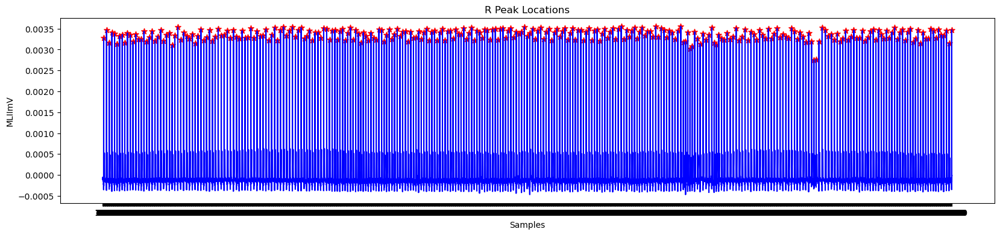

In [14]:
# Calculate the heart rate
heartRate = (60*fs)/np.average(rri)
print("Heart Rate",heartRate, "BPM")

# Plotting the R peak locations in ECG signal
plt.figure(figsize = (20,4), dpi = 100)
plt.xticks(np.arange(0, len(signal)+1, 150))
plt.plot(signal, color = 'blue')        
plt.scatter(result, signal[result], color = 'red', s = 50, marker= '*')
plt.xlabel('Samples')
plt.ylabel('MLIImV')
plt.title("R Peak Locations")

In [16]:
############################### Segment Grouping if we remove the very first R-Peak ###############################
#Segment in Samples
seg1 = trg1 - trg0 - r_peak[0]
seg2 = trg2 - trg0 - r_peak[0]
seg3 = trg3 - trg0 - r_peak[0]

#Segment in ms
newseg1 = int(seg1/fs)
newseg2 = int(seg2/fs)
newseg3 = int(seg3/fs)

exp_duration = (len(mne_ecg) - r_peak[0] - (len(mne_ecg) - r_peak[-1]))/fs  #Tot duration - First Peak - (Tot Duration - Last peak) 
############################### Segment Grouping if we remove the very first R-Peak ###############################

#### Data Interpolation and STFT

Text(0.5, 0, 'Time [sec]')

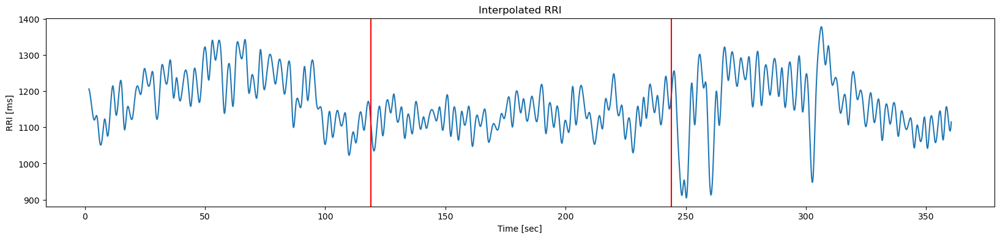

In [16]:
# #Data Interpolation, Fs = 1000
# exp_duration = len(mne_ecg)/fs

x_vals = np.linspace(r_peak[1],r_peak[-1],int(exp_duration*fs))
splines = scipy.interpolate.splrep(r_peak[1:],rri)
y_vals = scipy.interpolate.splev(x_vals,splines)

plt.figure(figsize = (20,4),dpi = 100)
plt.plot(x_vals/fs,y_vals)
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')

plt.title('Interpolated RRI')
plt.ylabel('RRI [ms]')
plt.xlabel('Time [sec]')

In [17]:
y_firstrest = y_vals[:seg1] 
y_stress = y_vals[seg1:seg2]
y_secondrest = y_vals[seg2:]

#### Time Analysis

In [18]:
#Measure SDNN
sdnn_full = np.std(y_vals)
sdnn_rest_1 = np.std(y_firstrest)
sdnn_test = np.std(y_stress)
sdnn_rest_2 = np.std(y_secondrest)
print("Standard Deviation during Experiment: ", sdnn_full)
print("Standard Deviation during First Rest: ", sdnn_rest_1)
print("Standard Deviation during CSWT: ", sdnn_test)
print("Standard Deviation during Second Rest: ", sdnn_rest_2)

Standard Deviation during Experiment:  76.08388490941012
Standard Deviation during First Rest:  74.1774446796659
Standard Deviation during CSWT:  40.5941113959357
Standard Deviation during Second Rest:  93.49958553628701


#### Frequency Analysis

##### PSD Measurement using Welch Method

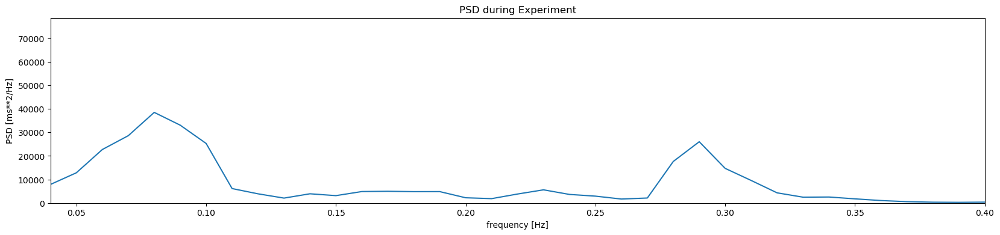

Absolute Power LF =  188093.1005361667 ms**2/Hz
Absolute Power HF =  128001.22519242179 ms**2/Hz
Total Power =  451743.90838384104 ms**2/Hz
LF/HF Ratio =  1.4694632825069442
Normalized Power LF =  41.63710833624488 %
Normalized Power HF =  28.334908964319837 %


In [19]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_vals,fs,nperseg = nperseg, noverlap=noverlap)

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during Experiment')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')

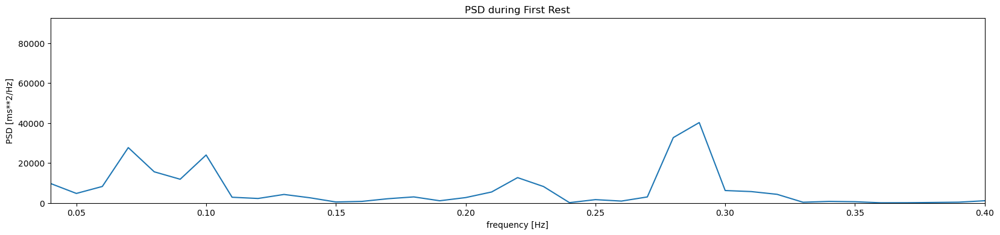

Absolute Power LF =  114417.75100221955 ms**2/Hz
Absolute Power HF =  135400.42773712464 ms**2/Hz
Total Power =  401993.3185796317 ms**2/Hz
LF/HF Ratio =  0.8450324191320706
Normalized Power LF =  28.46260017616544 %
Normalized Power HF =  33.68225825631549 %


In [20]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_firstrest,fs,nperseg = nperseg, noverlap=noverlap)

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during First Rest')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')

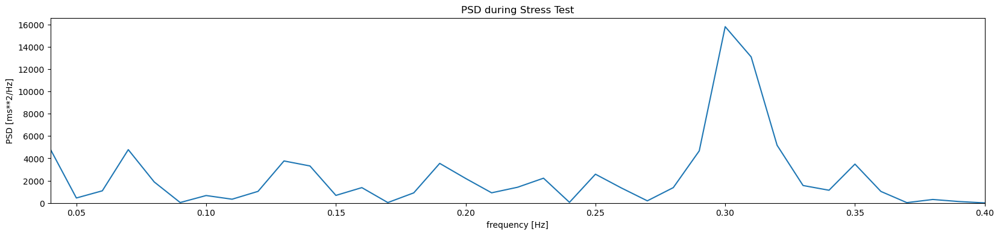

Absolute Power LF =  22868.054893000008 ms**2/Hz
Absolute Power HF =  65305.49465118262 ms**2/Hz
Total Power =  122435.4578721607 ms**2/Hz
LF/HF Ratio =  0.3501704567915081
Normalized Power LF =  18.67764068549274 %
Normalized Power HF =  53.33871068573163 %


In [21]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_stress,fs,nperseg = nperseg, noverlap=noverlap)
plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during Stress Test')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')

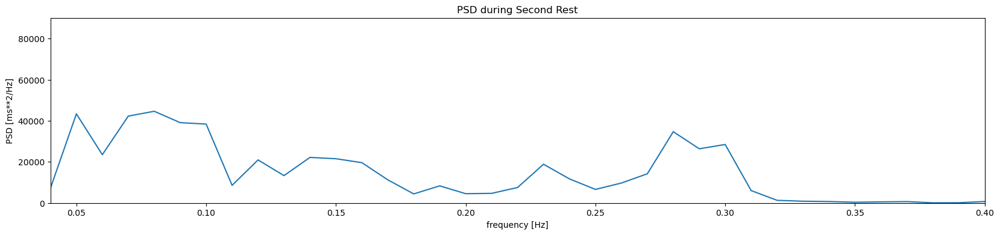

Absolute Power LF =  325014.9857553192 ms**2/Hz
Absolute Power HF =  243901.2178106334 ms**2/Hz
Total Power =  737489.7247709975 ms**2/Hz
LF/HF Ratio =  1.3325681137339096
Normalized Power LF =  44.07044258904646 %
Normalized Power HF =  33.0718123410287 %


In [22]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_secondrest,fs,nperseg = nperseg, noverlap=noverlap)
plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during Second Rest')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')

#### Time-Frequency Analysis

##### PSD Welch Over-time

In [23]:
# Parameters for segmentation and analysis
segment_length = 10*fs  # seconds
overlap = int(segment_length*0.9)  # seconds

# Calculate LF/HF ratio over time
lfhf_ratio = []
hf_over_time = []
lf_over_time = []

for i in range(0, len(y_vals), segment_length - overlap):
    segment = y_vals[i:i + segment_length]

    # Compute PSD using Welch's method
    f_den, Pxx_den = sg.welch(segment, fs=fs, nperseg = 10000)

    idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
    idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))

    # Calculate LF and HF power
    abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
    abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
    lf_hf_ratio = abs_power_LF / abs_power_HF

    # Calculate LF/HF ratio
    if math.isnan(lf_hf_ratio) == False:
        lfhf_ratio.append(lf_hf_ratio)
    if math.isnan(abs_power_HF) == False:
        hf_over_time.append(abs_power_HF)
    if math.isnan(abs_power_LF) == False:
        lf_over_time.append(abs_power_LF)


c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 9902, using nperseg = 9902
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 8902, using nperseg = 8902
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 7902, using nperseg = 7902
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 6902, using nperseg = 6902
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-p

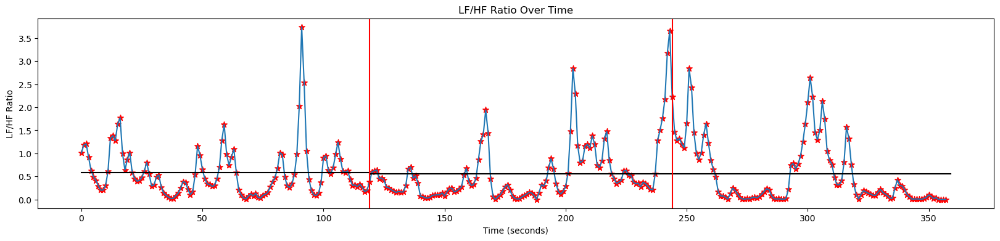

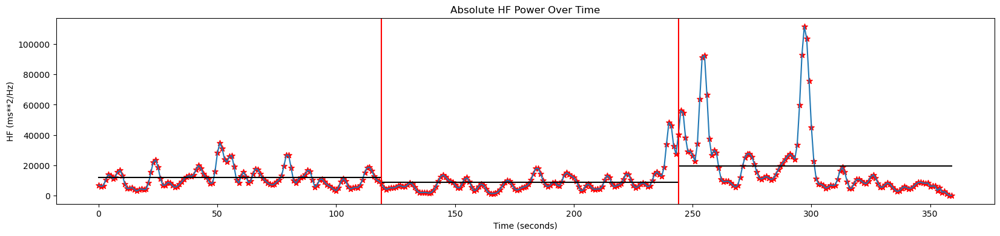

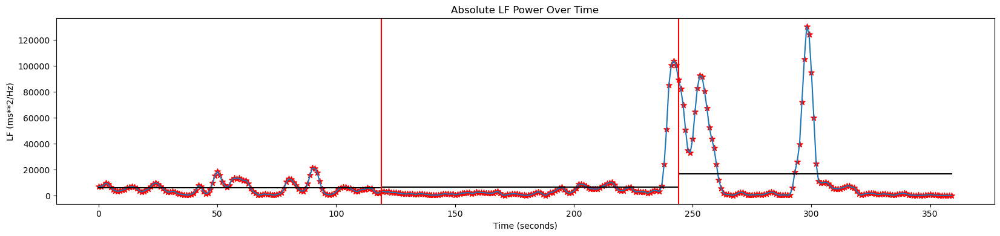

In [24]:
# Plot LF/HF ratio over time
plt.figure(figsize = (20,4))
plt.plot(np.arange(0, len(lfhf_ratio)*(segment_length - overlap), segment_length - overlap)/fs, lfhf_ratio)
plt.plot((0, newseg1), (np.average(lfhf_ratio[0:newseg1]),np.average(lfhf_ratio[0:newseg1])), 'k-')
plt.plot((newseg1, newseg2), (np.average(lfhf_ratio[newseg1:newseg2]),np.average(lfhf_ratio[newseg1:newseg2])), 'k-')
plt.plot((newseg2, newseg3), (np.average(lfhf_ratio[newseg2:]),np.average(lfhf_ratio[newseg2:])), 'k-')
plt.scatter(np.arange(0, len(lfhf_ratio)*(segment_length - overlap), segment_length - overlap)/fs, lfhf_ratio, color = 'red', s = 50, marker= '*')
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.xlabel('Time (seconds)')
plt.ylabel('LF/HF Ratio')
plt.title('LF/HF Ratio Over Time')
plt.show()

# Plot HF over time
plt.figure(figsize = (20,4))
plt.plot(np.arange(0, len(hf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, hf_over_time)
plt.plot((0, newseg1), (np.average(hf_over_time[0:newseg1]),np.average(hf_over_time[0:newseg1])), 'k-')
plt.plot((newseg1, newseg2), (np.average(hf_over_time[newseg1:newseg2]),np.average(hf_over_time[newseg1:newseg2])), 'k-')
plt.plot((newseg2, newseg3), (np.average(hf_over_time[newseg2:]),np.average(hf_over_time[newseg2:])), 'k-')
plt.scatter(np.arange(0, len(hf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, hf_over_time, color = 'red', s = 50, marker ='*')
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.xlabel('Time (seconds)')
plt.ylabel('HF (ms**2/Hz)')
plt.title('Absolute HF Power Over Time')
plt.show()

# Plot LF over time
plt.figure(figsize = (20,4))
plt.plot(np.arange(0, len(lf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, lf_over_time)
plt.plot((0, newseg1), (np.average(lf_over_time[0:newseg1]),np.average(lf_over_time[0:newseg1])), 'k-')
plt.plot((newseg1, newseg2), (np.average(lf_over_time[newseg1:newseg2]),np.average(lf_over_time[newseg1:newseg2])), 'k-')
plt.plot((newseg2, newseg3), (np.average(lf_over_time[newseg2:]),np.average(lf_over_time[newseg2:])), 'k-')
plt.scatter(np.arange(0, len(lf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, lf_over_time, color = 'red', s = 50, marker ='*')
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.xlabel('Time (seconds)')
plt.ylabel('LF (ms**2/Hz)')
plt.title('Absolute LF Power Over Time')
plt.show()

##### STFT

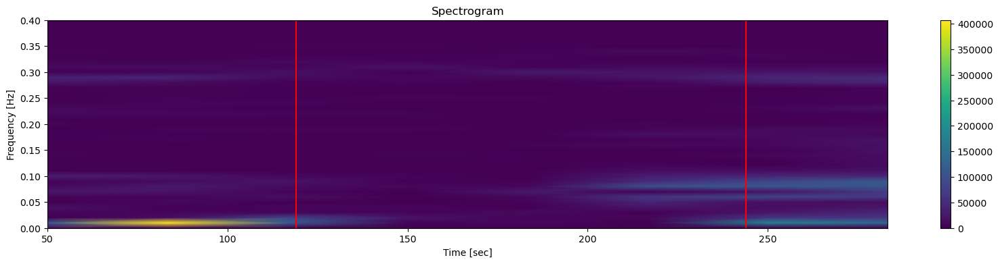

In [25]:
#STFT RRI
nperseg = 100000
noverlap = nperseg*2/3
f1,t1,Sxx = scipy.signal.spectrogram(y_vals, fs=fs, nperseg = nperseg, noverlap = noverlap, scaling='density')
plt.figure(figsize = (20,4), dpi = 100)
plt.pcolormesh(t1, f1, np.abs(Sxx), shading='gouraud', snap= True)
plt.title('Spectrogram')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.axis([t1[0], t1[-1], 0, 0.4])
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.colorbar()
plt.show()

## EEG Analysis

In [6]:
#raw_eeg = raw.copy().crop(tmin = 39.471, tmax = 939.971).pick_types(eeg=True, eog=False, ecg=False) #make a copy
# raw_temp_short = raw.copy().crop(tmin=339.471, tmax = 519.471)

raw_temp = raw.copy().crop(tmin = tmin, tmax = tmax) #make a copy
raw_temp.load_data()

Reading 0 ... 360478  =      0.000 ...   360.478 secs...


<RawBrainVision | 20240418_B98_jikken_0004.eeg, 67 x 360479 (360.5 s), ~184.3 MB, data loaded>

In [7]:
############################### Segment Grouping for EEG ###############################
#Segment in Samples
eeg_seg1 = trg1 - trg0
eeg_seg2 = trg2 - trg0
eeg_seg3 = trg3 - trg0

#Segment in ms
eeg_newseg1 = int(eeg_seg1/fs)
eeg_newseg2 = int(eeg_seg2/fs)
eeg_newseg3 = int(eeg_seg3/fs)
############################### Segment Grouping for EEG ###############################

### Preprocessing: ICA 

##### Visualizing Artifact

In [28]:
#Regular Expression = Search certain pattern
regexp = r"(ECG|vEOG|hEOG)"
artifact_picks = mne.pick_channels_regexp(raw_temp.ch_names, regexp=regexp)
# raw_temp.plot(order=artifact_picks, n_channels=len(artifact_picks), show_scrollbars=False)

Using EOG channels: vEOG, hEOG
EOG channel index for this subject is: [64 65]
Filtering the data to remove DC offset to help distinguish blinks from saccades
Selecting channel hEOG for blink detection
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 s)

Now detecting blinks and generating corresponding events
Found 15 significant peaks
Number of EOG events detected: 15
Not setting metadata
15 matching events found
No baseline correction applied
Using data from preloaded Raw for 15 events and 1001 original time points ...
0 bad epochs dropped
NOTE: pick_channels

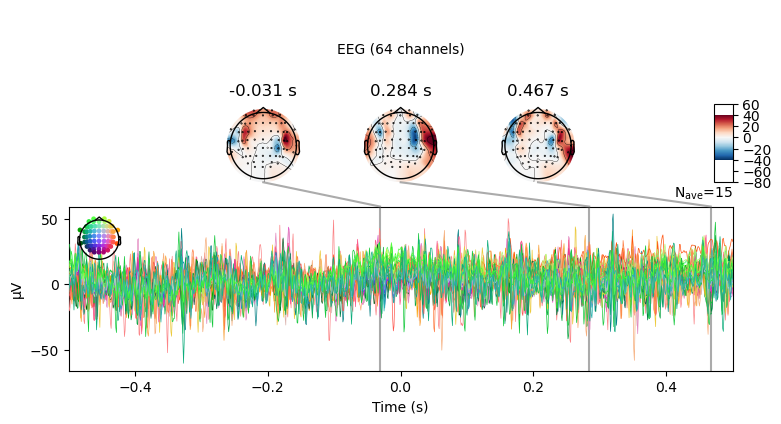

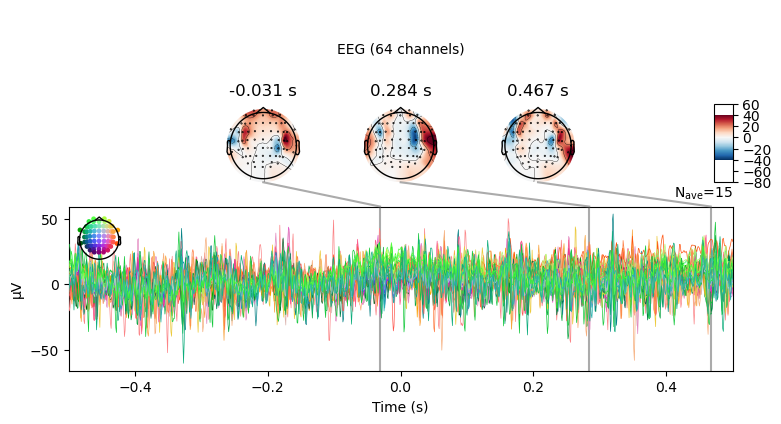

In [29]:
eog_evoked = create_eog_epochs(raw_temp).average()
eog_evoked.apply_baseline(baseline=(None, -0.2))
eog_evoked.plot_joint()

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Number of ECG events detected : 310 (average pulse 51 / min.)
Not setting metadata
310 matching events found
No baseline correction applied
Loading data for 310 events and 1001 original time points ...
1 bad epochs dropped
Applying baseline correction (mode: mean)
No projector specified for this dataset. Please consider the method self.add_proj.


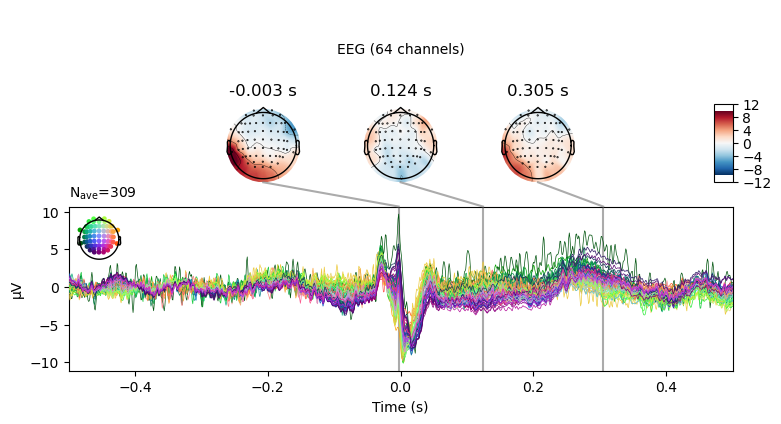

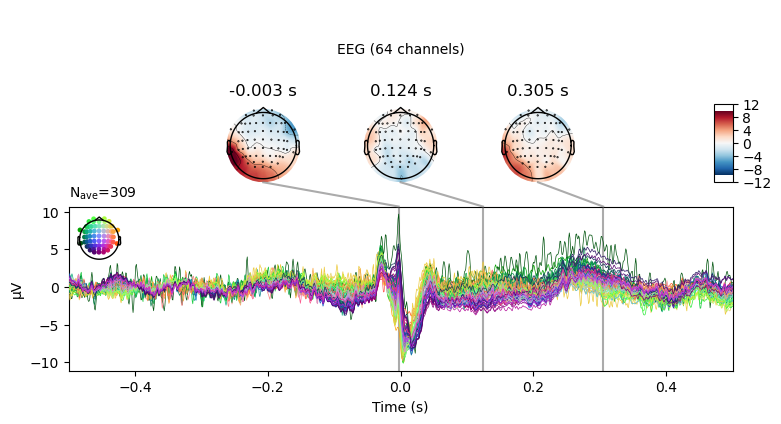

In [10]:
ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked.apply_baseline(baseline=(None, -0.2))
ecg_evoked.plot_joint()

##### Read ICA

In [17]:
ica = read_ica("20240418_mat2mins/20240418_B98_jikken_0004-ica.fif")

Reading 20240418_mat2mins/20240418_B98_jikken_0004-ica.fif ...
Now restoring ICA solution ...
Ready.


Creating RawArray with float64 data, n_channels=35, n_times=360479
    Range : 25434 ... 385912 =     25.434 ...   385.912 secs
Ready.
Using qt as 2D backend.


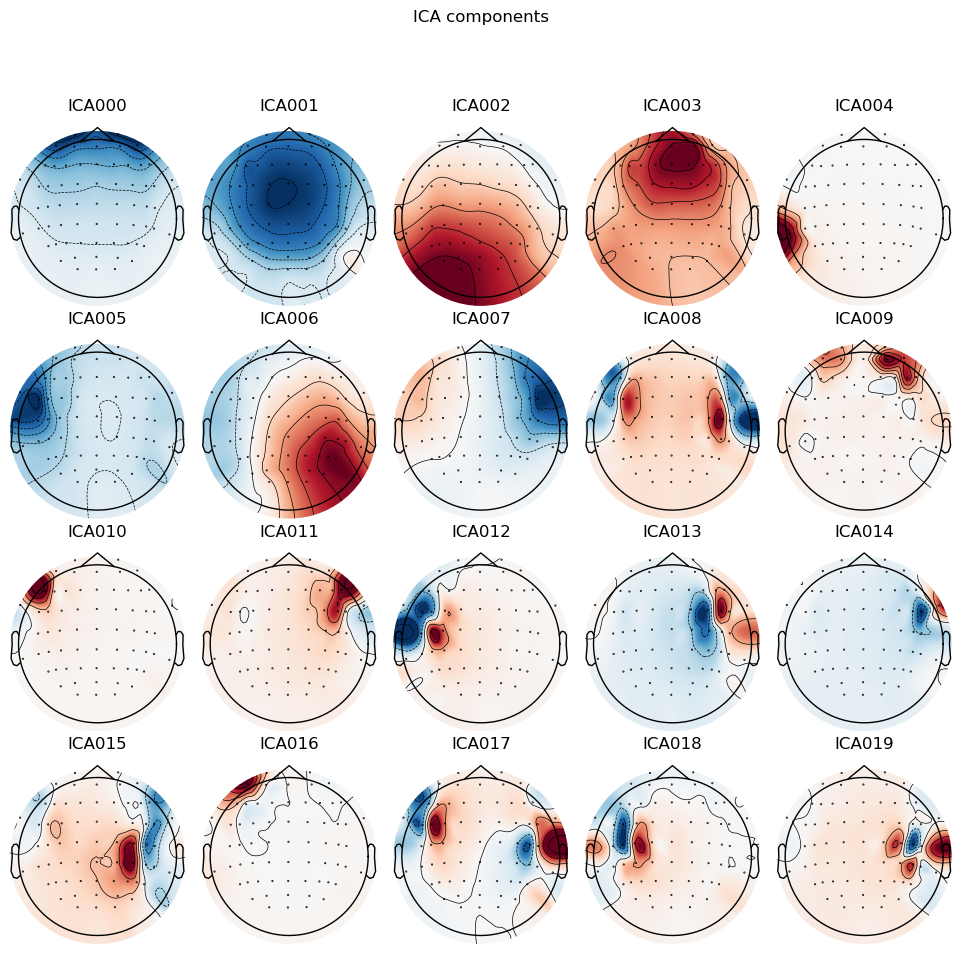

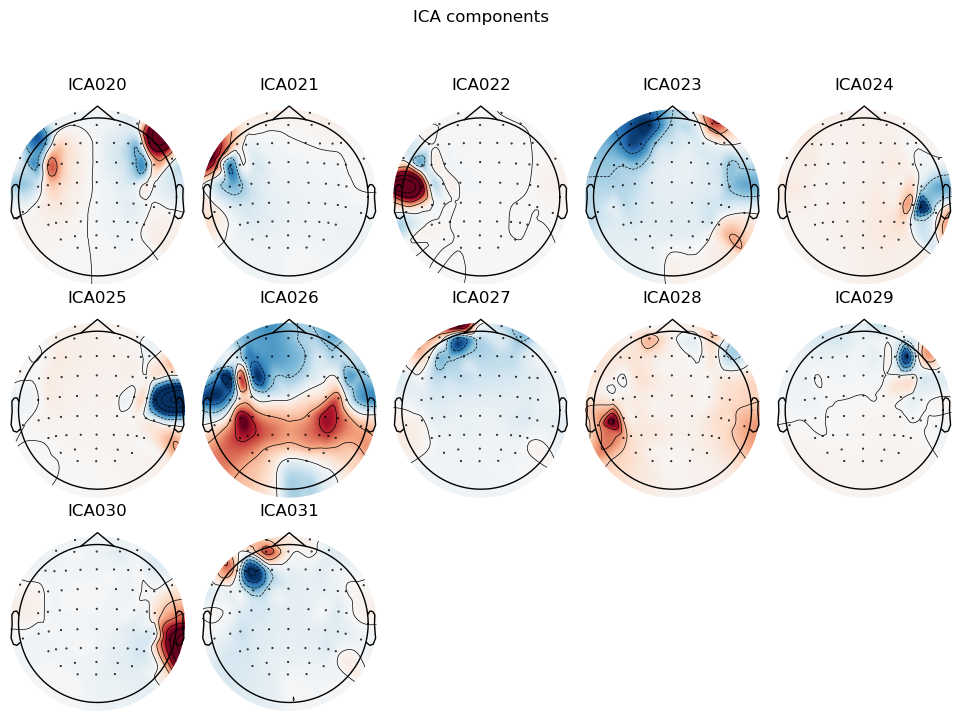

[<MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x731.5 with 12 Axes>]

In [18]:
ica.plot_sources(raw_temp, show_scrollbars=False)
ica.plot_components()

##### Check Blinks PCA

Using EOG channels: vEOG, hEOG
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.6s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 s)

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 s

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.4s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 s)

Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 1 ICA component
    Projecting back using 64 PCA components


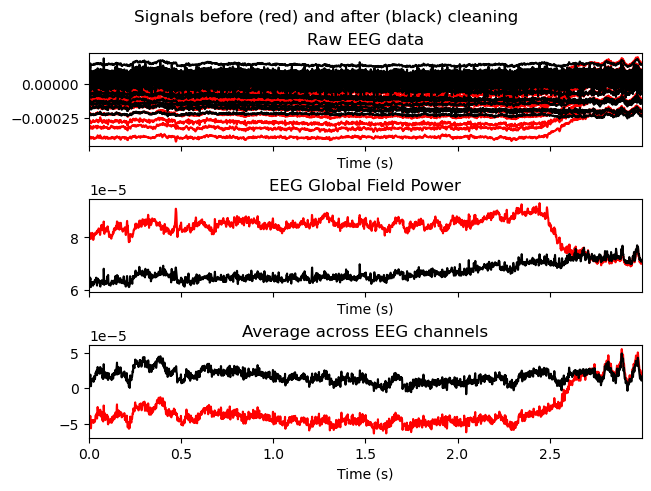

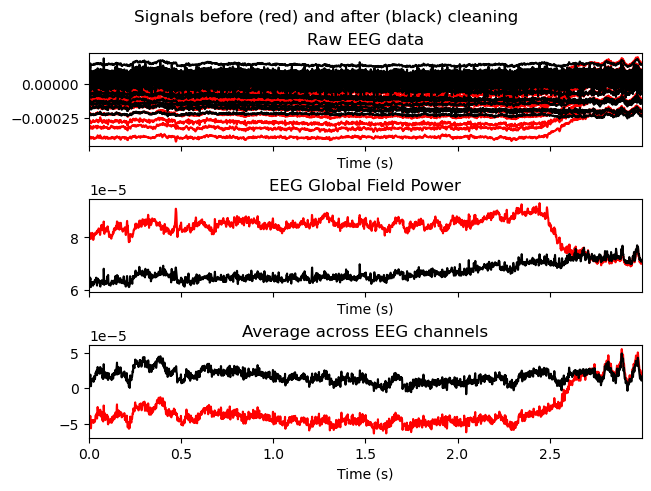

In [19]:
# Remove blinks PCA
eog_indices, eog_scores = ica.find_bads_eog(raw_temp, ch_name=['vEOG', 'hEOG'], threshold = 0.8, measure='correlation')
ica.plot_overlay(raw_temp, exclude=eog_indices, picks="eeg")
# ica.exclude = eog_indices

# ica.plot_properties(raw_temp, picks=eog_indices)
# ica.plot_scores(eog_scores)

##### Check ECG PCA

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Number of ECG events detected : 310 (average pulse 51 / min.)
Not setting metadata
310 matching events found
No baseline correction applied
Using data from preloaded Raw for 310 events and 1001 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 1 ICA component
    Projecting back using 64 PCA components


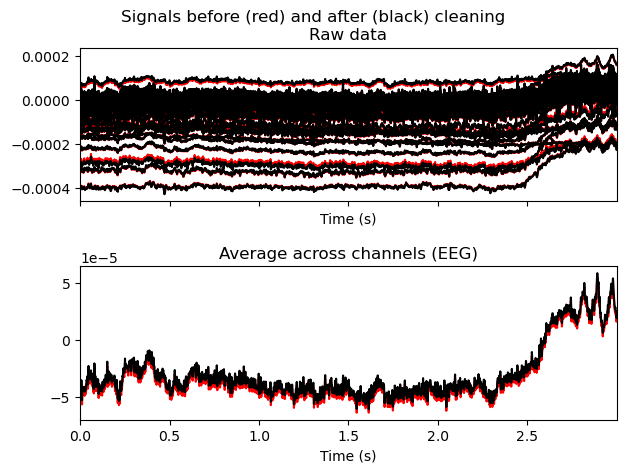

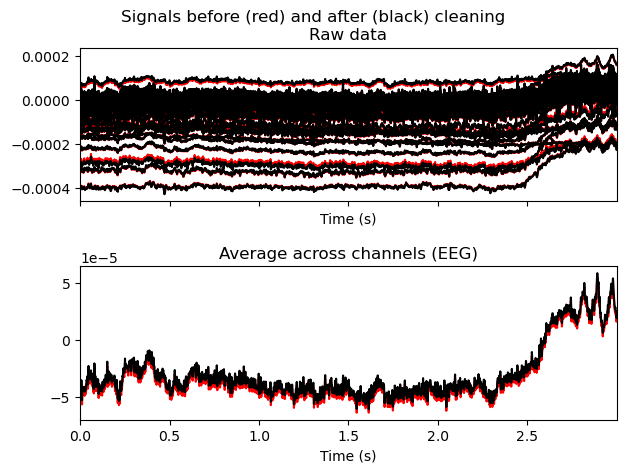

In [15]:
#Remove heart beat PCA
ecg_indices, ecg_scores = ica.find_bads_ecg(raw_temp, ch_name='ECG',threshold = 0.8, measure='correlation')
ica.plot_overlay(raw_temp, exclude=ecg_indices, picks="eeg")
#ica.exclude = ecg_indices

# ica.plot_properties(raw_temp, picks=ecg_indices)
# ica.plot_scores(ecg_scores)

##### Apply ICA

In [20]:
# ica.exclude = [0,1,5,6,7,8,9,10,11,12,14,15,19,20,21,23,25,27]
ica.exclude = eog_indices
#Prominent EOG artifact: 0
#Close to EOG: 
#Unknown: 
#Suspected Muscle: 

In [21]:
# ica.apply() changes the Raw object in-place, so let's make a copy first:
reconst_raw = raw_temp.copy()
ica.apply(reconst_raw)

Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 0 ICA components
    Projecting back using 64 PCA components


<RawBrainVision | 20240418_B98_jikken_0004.eeg, 67 x 360479 (360.5 s), ~184.3 MB, data loaded>

### After ICA EEG Analysis

In [22]:
# reconst_raw.copy().pick(['TP9','TP7','P7']).plot(title = 'Reconstructed')
# raw_temp.copy().pick(['TP9','TP7','P7']).plot(title = 'Raw')

reconst_raw.plot(title = 'Reconstructed')
raw_temp.plot(title = 'Raw')

In [23]:
#Split After ICA Data into each segments

ica_firstrest = reconst_raw.copy().crop(tmin = 0, tmax = eeg_newseg1)
ica_stress = reconst_raw.copy().crop(tmin = eeg_newseg1, tmax = eeg_newseg2)
ica_secondrest = reconst_raw.copy().crop(tmin = eeg_newseg2)

Channels marked as bad:
none
Channels marked as bad:
none


### Frequency Analysis

##### Plot Frequency Bands Activity

##### PSD Analysis on EEG

Effective window size : 0.256 (s)


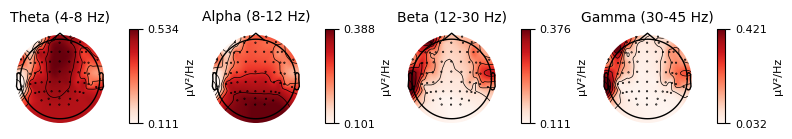

In [16]:
#### Full Experiment Plot
eeg_psd = reconst_raw.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 0.256 (s)


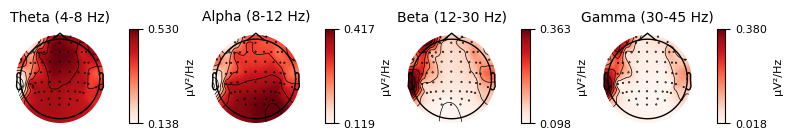

In [17]:
#### First Rest Plot
psd_firstrest = ica_firstrest.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 0.256 (s)


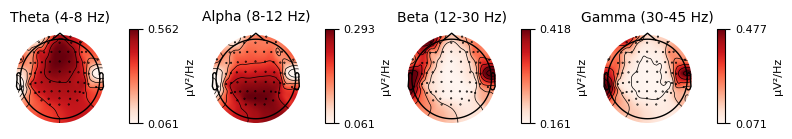

In [18]:
#### Stress Task Plot
psd_stress = ica_stress.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 0.256 (s)


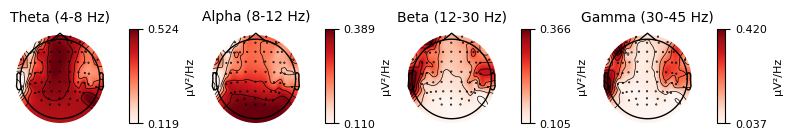

In [19]:
#### Second Rest Plot
psd_secondrest = ica_secondrest.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

### Time-Frequency Analysis

In [21]:
raw_eeg = reconst_raw.copy().pick_types(eeg=True, eog=False, ecg=False)
eeg_ch_names = raw_eeg.ch_names
eeg_data, _ = raw_eeg.get_data(picks = ['eeg'], return_times=True)

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


In [21]:
# Parameters for segmentation and analysis
segment_length = 10*fs  # seconds
overlap = int(segment_length*0.9)  # seconds

#### PSD Overtime Theta Band [4 - 8 Hz]

c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 9479, using nperseg = 9479
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 8479, using nperseg = 8479
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 7479, using nperseg = 7479
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 10000 is greater than input length  = 6479, using nperseg = 6479
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\Jeremi\anaconda3\envs\mne\lib\s

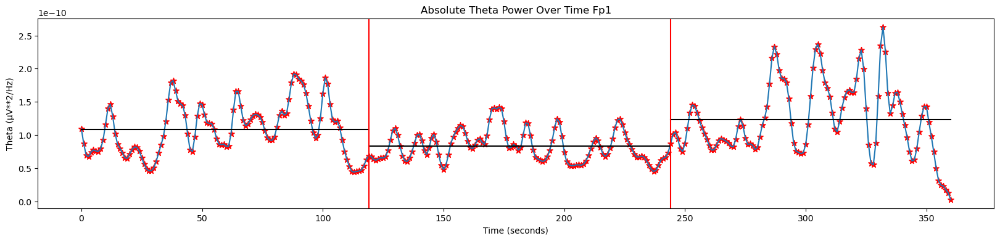

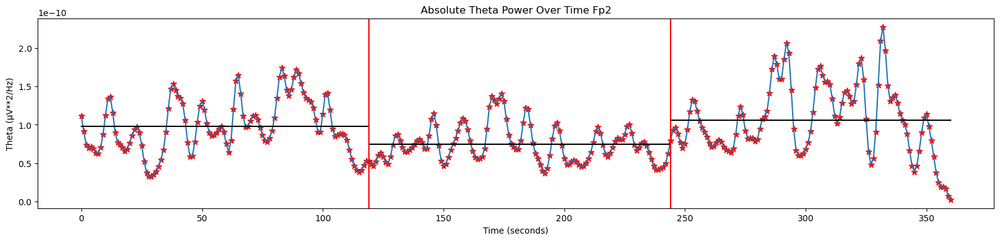

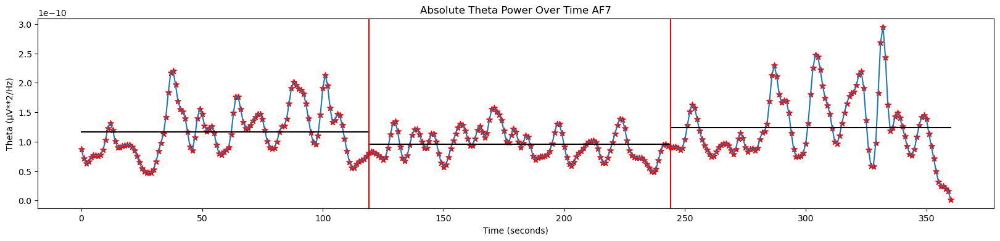

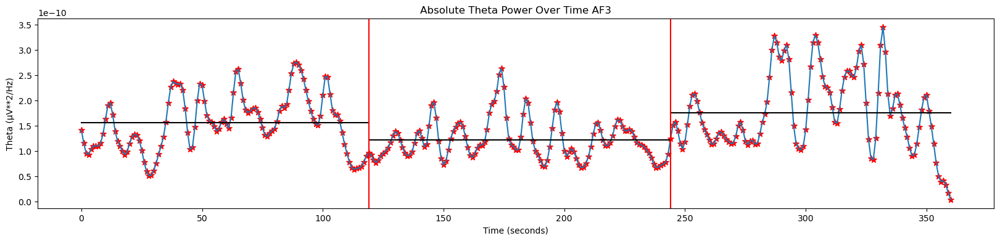

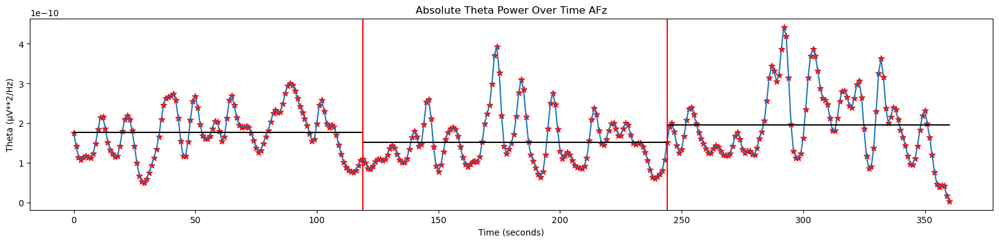

...

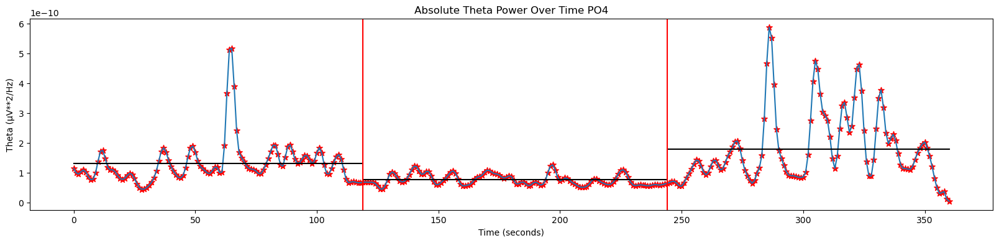

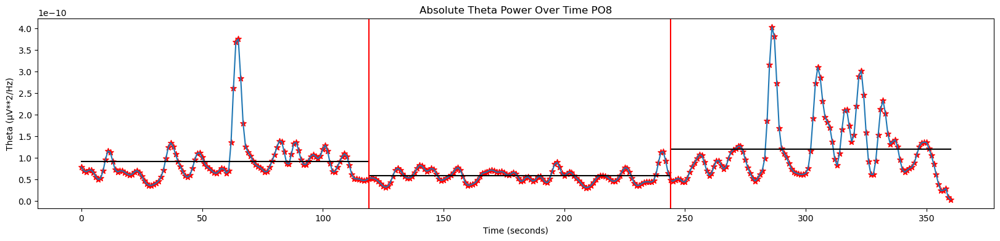

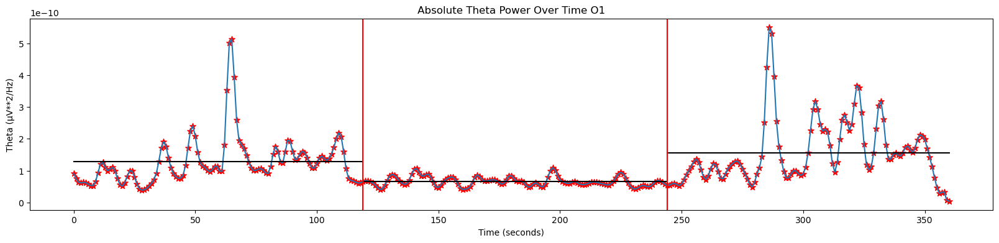

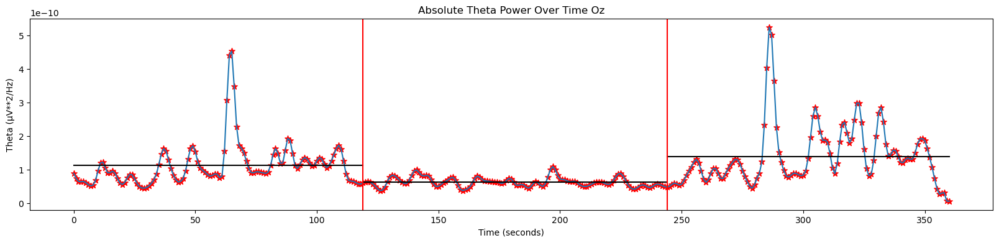

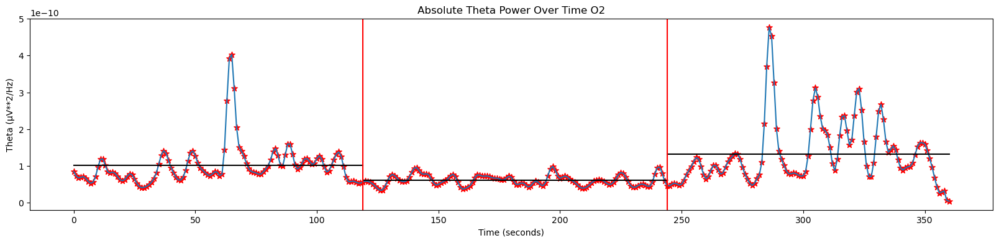

In [22]:
# Calculate Theta Band over time
theta_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    theta_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_theta = np.where((4 <= f_eeg) & (f_eeg <= 8))

        # Calculate Absolute Theta power
        abs_power_theta = np.sum(np.abs(Pxx_eeg[idx_theta]))

        # Append data
        if math.isnan(abs_power_theta) == False:
            theta_over_time.append(abs_power_theta)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(theta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, theta_over_time)
    plt.plot((0, eeg_newseg1), (np.average(theta_over_time[0:eeg_newseg1]),np.average(theta_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(theta_over_time[eeg_newseg1:eeg_newseg2]),np.average(theta_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(theta_over_time[eeg_newseg2:]),np.average(theta_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(theta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, theta_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Theta (μV**2/Hz)')
    plt.title('Absolute Theta Power Over Time '+ ch_name)
    plt.show()

    theta_row_data = {
        "ch_name": ch_name, 
        "power first rest" : theta_over_time[0:eeg_newseg1],
        "power stress" : theta_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : theta_over_time[eeg_newseg2:eeg_newseg3]
    }
    theta_data.append(theta_row_data)

#### PSD Overtime Alpha Band [8 - 12 Hz]

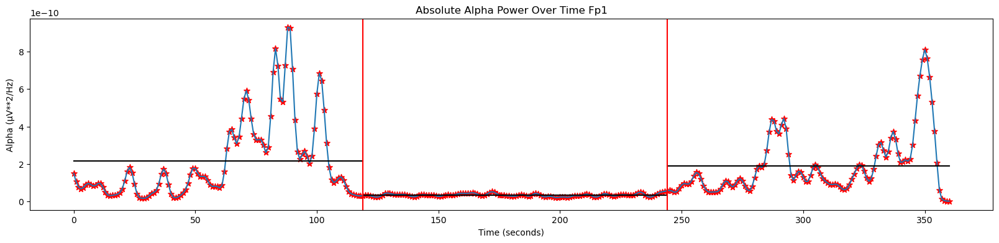

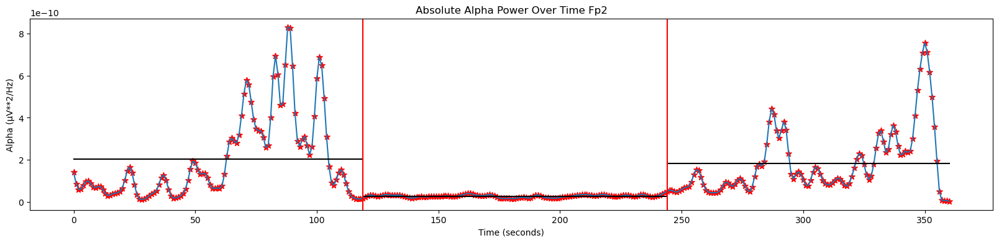

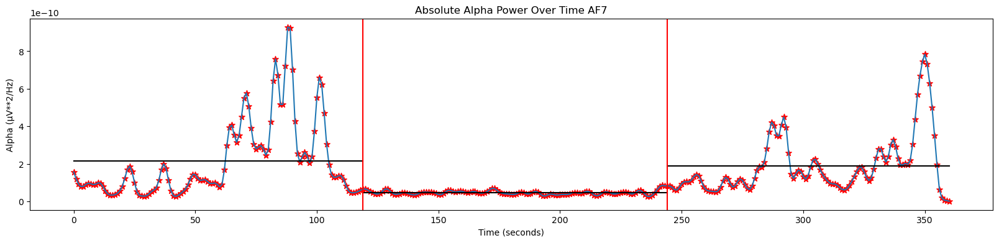

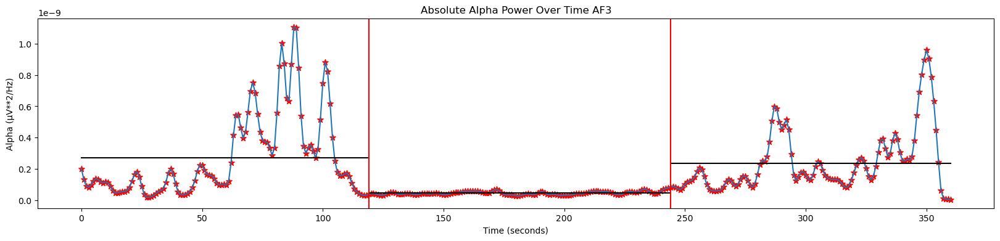

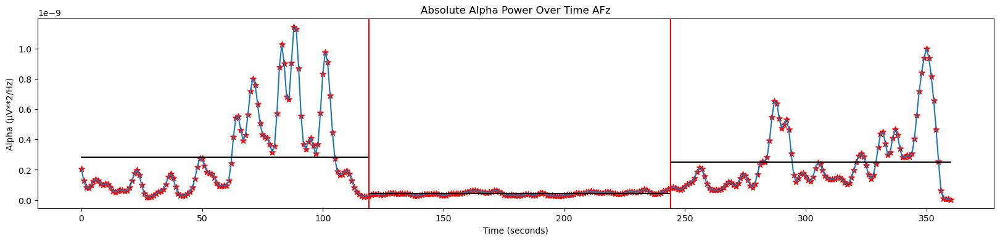

...

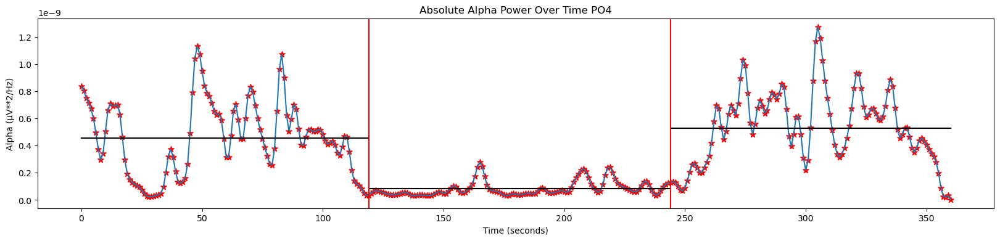

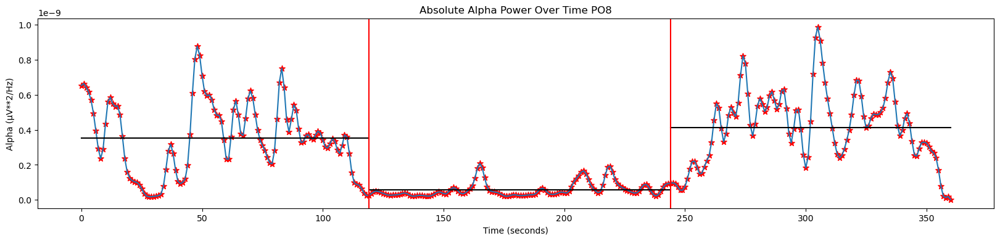

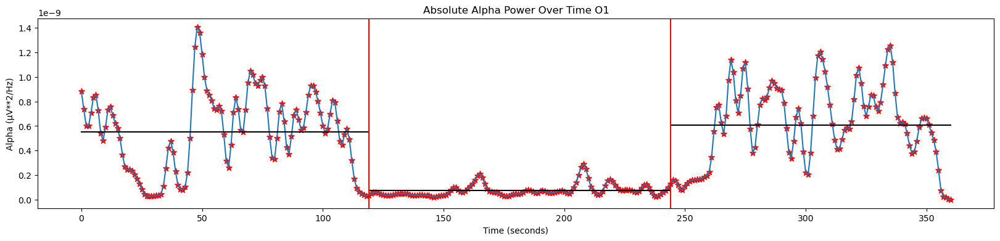

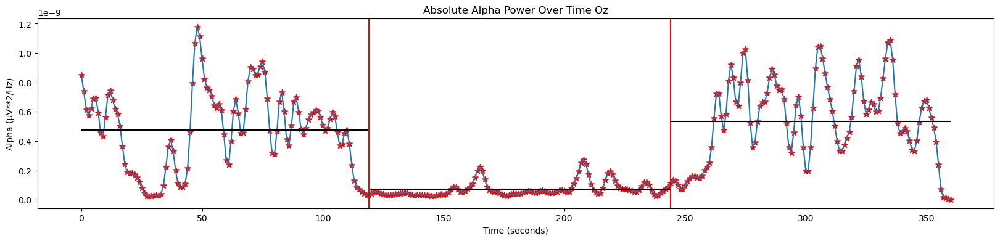

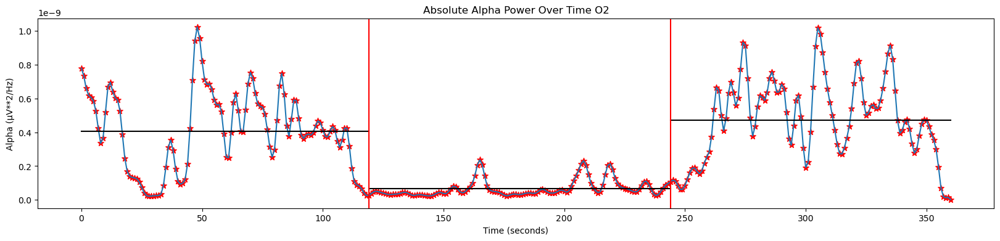

In [23]:
# Calculate Alpha Band over time
alpha_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    alpha_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_alpha = np.where((8 <= f_eeg) & (f_eeg <= 12))

        # Calculate Absolute Alpha power
        abs_power_alpha = np.sum(np.abs(Pxx_eeg[idx_alpha]))

        # Append data
        if math.isnan(abs_power_alpha) == False:
            alpha_over_time.append(abs_power_alpha)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(alpha_over_time)*(segment_length - overlap), segment_length - overlap)/fs, alpha_over_time)
    plt.plot((0, eeg_newseg1), (np.average(alpha_over_time[0:eeg_newseg1]),np.average(alpha_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(alpha_over_time[eeg_newseg1:eeg_newseg2]),np.average(alpha_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(alpha_over_time[eeg_newseg2:]),np.average(alpha_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(alpha_over_time)*(segment_length - overlap), segment_length - overlap)/fs, alpha_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Alpha (μV**2/Hz)')
    plt.title('Absolute Alpha Power Over Time '+ ch_name)
    plt.show()
    
    alpha_row_data = {
        "ch_name": ch_name, 
        "power first rest" : alpha_over_time[0:eeg_newseg1],
        "power stress" : alpha_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : alpha_over_time[eeg_newseg2:eeg_newseg3]
    }
    alpha_data.append(alpha_row_data)

#### PSD Overtime Beta Band [12 - 30 Hz]

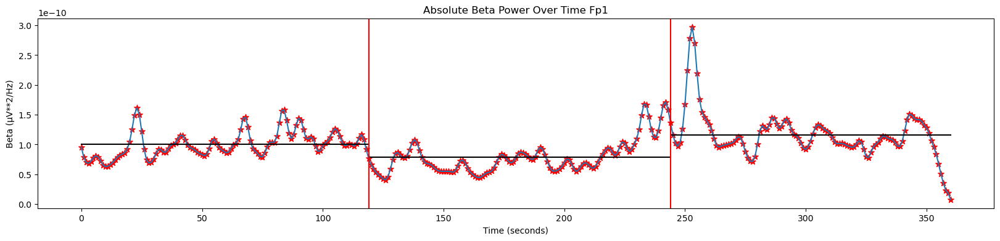

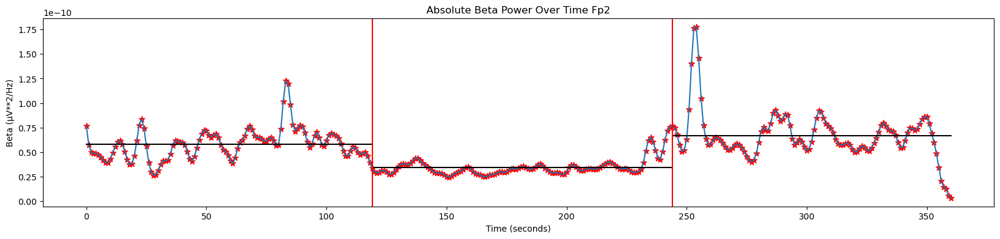

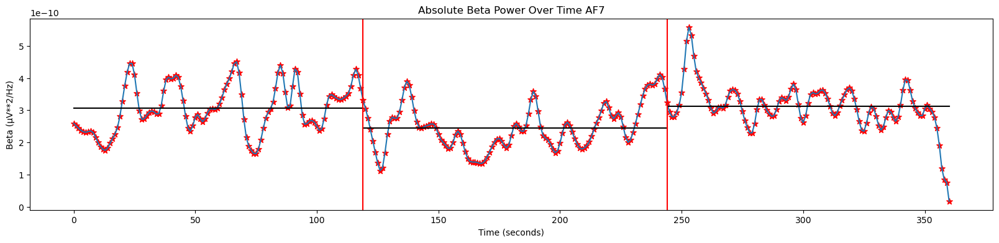

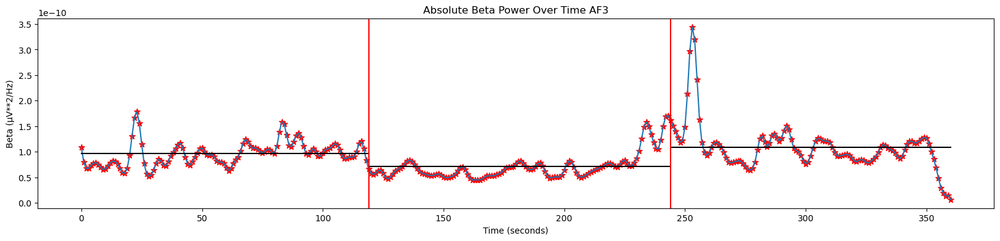

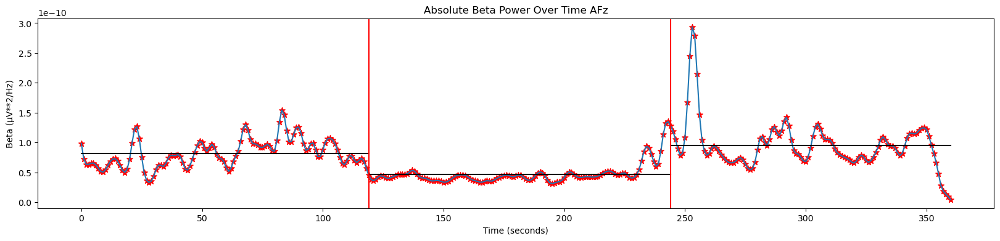

...

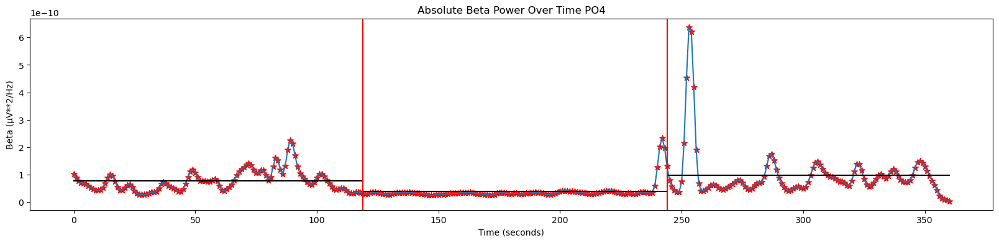

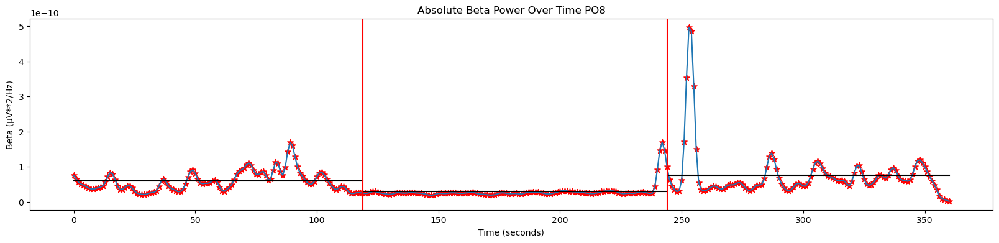

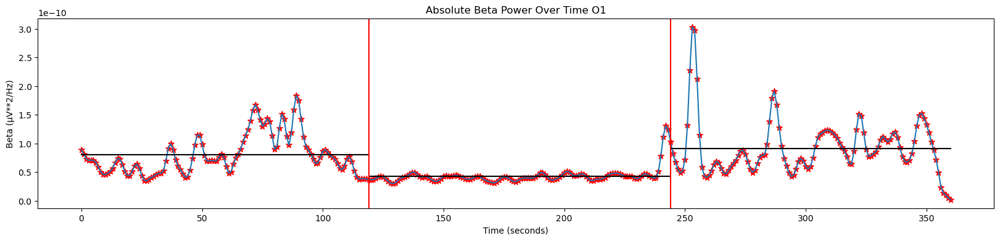

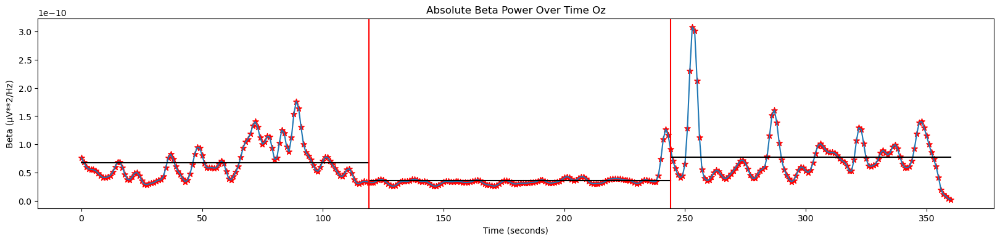

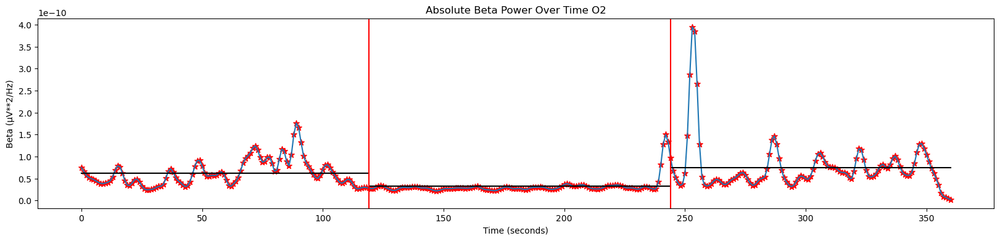

In [24]:
# Calculate Beta Band over time
beta_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    beta_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_beta = np.where((12 <= f_eeg) & (f_eeg <= 30))

        # Calculate Absolute Beta power
        abs_power_beta = np.sum(np.abs(Pxx_eeg[idx_beta]))

        # Append data
        if math.isnan(abs_power_beta) == False:
            beta_over_time.append(abs_power_beta)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(beta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, beta_over_time)
    plt.plot((0, eeg_newseg1), (np.average(beta_over_time[0:eeg_newseg1]),np.average(beta_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(beta_over_time[eeg_newseg1:eeg_newseg2]),np.average(beta_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(beta_over_time[eeg_newseg2:]),np.average(beta_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(beta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, beta_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Beta (μV**2/Hz)')
    plt.title('Absolute Beta Power Over Time '+ ch_name)
    plt.show()

    beta_row_data = {
        "ch_name": ch_name, 
        "power first rest" : beta_over_time[0:eeg_newseg1],
        "power stress" : beta_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : beta_over_time[eeg_newseg2:eeg_newseg3]
    }
    beta_data.append(beta_row_data)

#### PSD Overtime Gamma Band [30 - 45 Hz]

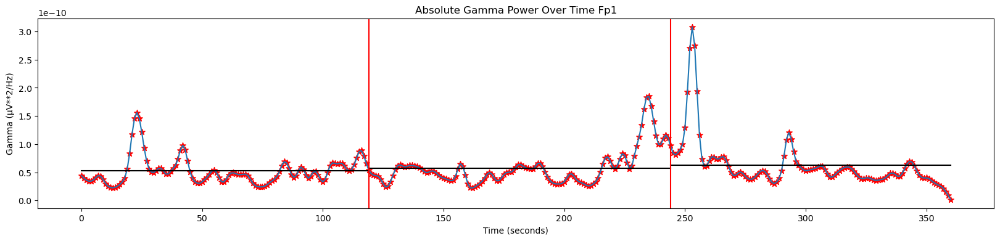

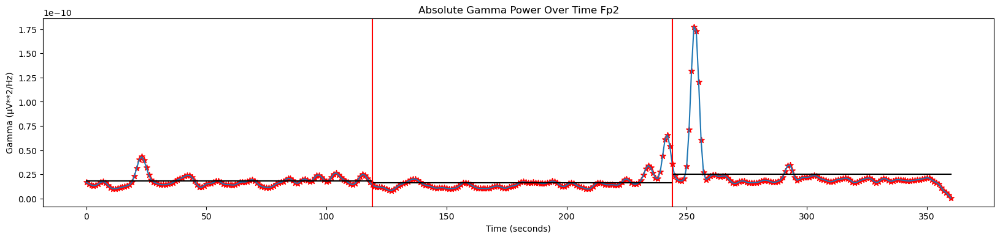

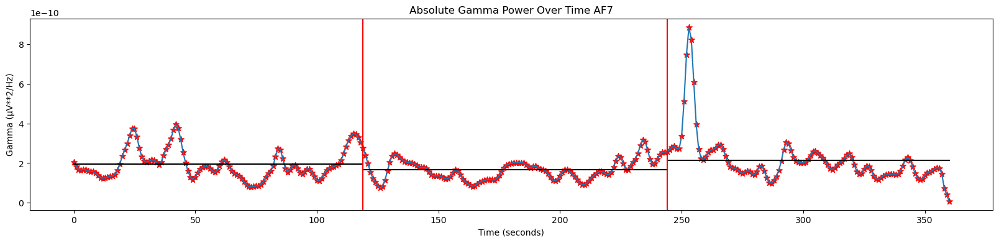

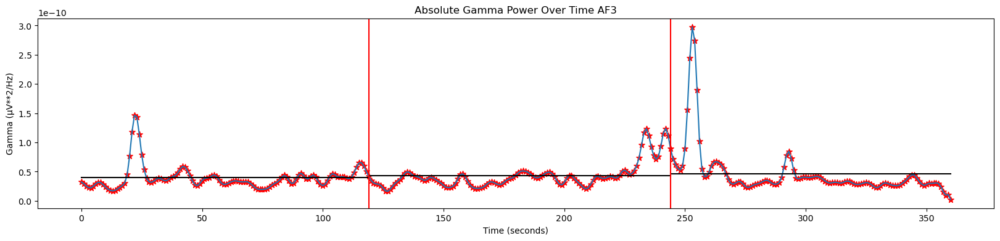

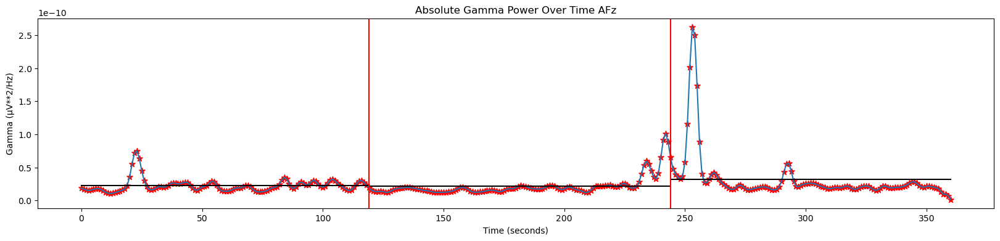

...

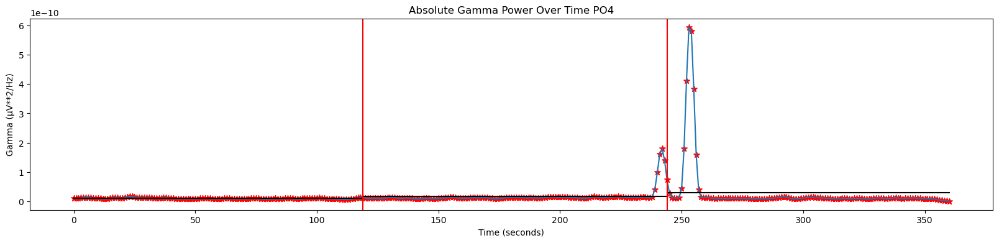

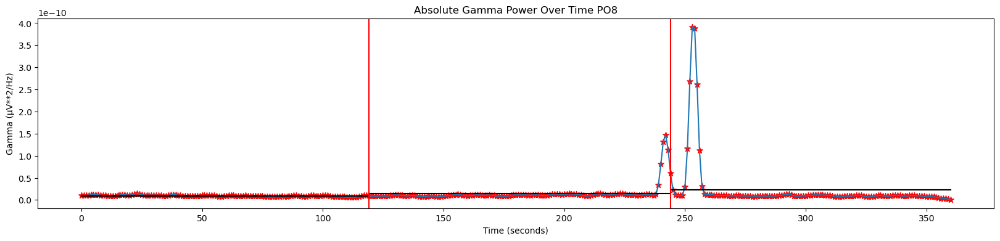

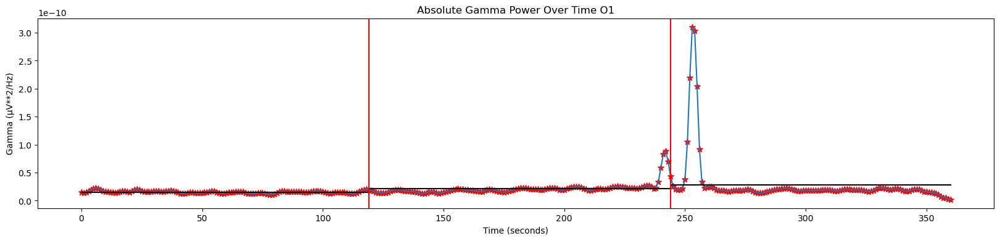

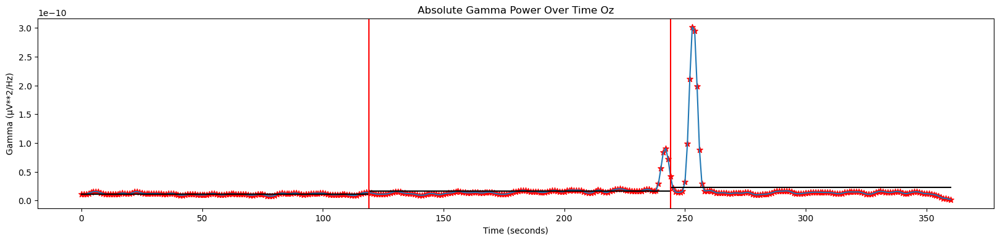

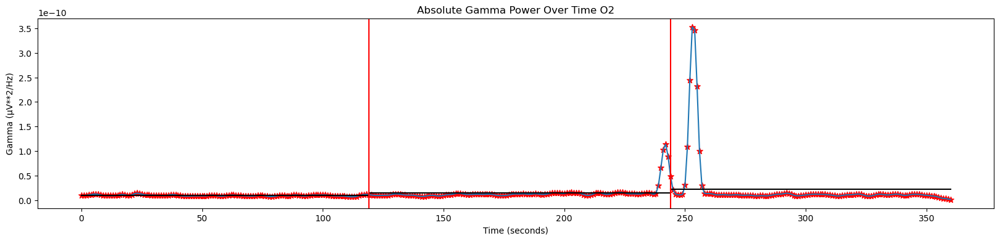

In [25]:
# Calculate Gamma Band over time
gamma_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    gamma_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_gamma = np.where((30 <= f_eeg) & (f_eeg <= 45))

        # Calculate Absolute Gamma power
        abs_power_gamma = np.sum(np.abs(Pxx_eeg[idx_gamma]))

        # Append data
        if math.isnan(abs_power_gamma) == False:
            gamma_over_time.append(abs_power_gamma)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(gamma_over_time)*(segment_length - overlap), segment_length - overlap)/fs, gamma_over_time)
    plt.plot((0, eeg_newseg1), (np.average(gamma_over_time[0:eeg_newseg1]),np.average(gamma_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(gamma_over_time[eeg_newseg1:eeg_newseg2]),np.average(gamma_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(gamma_over_time[eeg_newseg2:]),np.average(gamma_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(gamma_over_time)*(segment_length - overlap), segment_length - overlap)/fs, gamma_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Gamma (μV**2/Hz)')
    plt.title('Absolute Gamma Power Over Time '+ ch_name)
    plt.show()

    gamma_row_data = {
        "ch_name": ch_name, 
        "power first rest" : gamma_over_time[0:eeg_newseg1],
        "power stress" : gamma_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : gamma_over_time[eeg_newseg2:eeg_newseg3]
    }
    gamma_data.append(gamma_row_data)

### Machine Learning Implementation

#### Feature Extraction

In [13]:
def abs_power_extraction(signal, fs, l_freq, h_freq, tmin, tmax, t_seg = 10, noverlap = 0.9):
    """
    Extract Absolute PSD from Data

    Parameters:
    :param signal: Signal that want to be extracted from
    :param fs: frequency sampling
    :param l_freq: Minimum range of EEG bands frequency (Theta = 4, Alpha = 8, Beta = 12, Gamma = 30)
    :param h_freq: Maxmimum range of EEG bands frequency (Theta = 8, Alpha = 12, Beta = 30, Gamma = 45)
    :param tmin: Start time where the frequency of the signal want to be extracted 
    :param tmax: End time where the frequency of the signal want to be extracted
    :param t_seg: Length of time that want to be segmented (in seconds)
    :param t_overlap: Length of Overlap time (in seconds)
    
    Returns:
    :return: Extracted absolute Power
    """

    freq_data = []

    segment_length = t_seg*fs  # seconds
    overlap = int(segment_length*noverlap)  # usually t_overlap = 9 seconds, so overlap about 90% of segment

    for i in range(len(signal)):
        data_channel = signal[i]
        freq_over_time = []
        for j in range(0, len(data_channel), segment_length - overlap):
            segment = data_channel[j:j + segment_length]

            if len(segment) < segment_length:
                nperseg = len(segment)
            else:
                nperseg = segment_length

            #Compute PSD
            f_eeg, Pxx_eeg = sg.welch(segment, fs, nperseg = nperseg)

            idx_freq = np.where((l_freq<= f_eeg) & (f_eeg<= h_freq))

            abs_power_freq = np.sum(np.abs(Pxx_eeg[idx_freq]))

            #Append
            if math.isnan(abs_power_freq) == False:
                freq_over_time.append(abs_power_freq)
        freq_data.append(freq_over_time[tmin:tmax])
    
    return np.array(freq_data)

#### PSD Data to Data Frame and Array

In [14]:
eeg_data = reconst_raw.pick_types(eeg=True, eog=False, ecg=False).get_data()
eeg_ch_names = reconst_raw.pick_types(eeg=True, eog=False, ecg=False).ch_names

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


In [15]:
prefixes = ["ch.theta.", "ch.alpha.", "ch.beta.", "ch.gamma."]

new_eeg_ch_names = []
for i in prefixes:
    for j in eeg_ch_names:
        name = i+j
        new_eeg_ch_names.append(name)

In [16]:
theta_data_rest = abs_power_extraction(eeg_data, fs, 4, 8, 0, eeg_newseg1)
theta_data_stress = abs_power_extraction(eeg_data, fs, 4, 8, eeg_newseg1, eeg_newseg2)
theta_data_rest2 = abs_power_extraction(eeg_data, fs, 4, 8, eeg_newseg2, eeg_newseg3)

In [18]:
alpha_data_rest = abs_power_extraction(eeg_data, fs, 8, 12, 0, eeg_newseg1)
alpha_data_stress = abs_power_extraction(eeg_data, fs, 8, 12, eeg_newseg1, eeg_newseg2)
alpha_data_rest2 = abs_power_extraction(eeg_data, fs, 8, 12, eeg_newseg2, eeg_newseg3)

In [19]:
beta_data_rest = abs_power_extraction(eeg_data, fs, 12, 30, 0, eeg_newseg1)
beta_data_stress = abs_power_extraction(eeg_data, fs, 12, 30, eeg_newseg1, eeg_newseg2)
beta_data_rest2 = abs_power_extraction(eeg_data, fs, 12, 30, eeg_newseg2, eeg_newseg3)

In [20]:
gamma_data_rest = abs_power_extraction(eeg_data, fs, 30, 45, 0, eeg_newseg1)
gamma_data_stress = abs_power_extraction(eeg_data, fs, 30, 45, eeg_newseg1, eeg_newseg2)
gamma_data_rest2 = abs_power_extraction(eeg_data, fs, 30, 45, eeg_newseg2, eeg_newseg3)

In [21]:
data_list_rest = np.concatenate((theta_data_rest,alpha_data_rest,beta_data_rest,gamma_data_rest))
data_list_stress = np.concatenate((theta_data_stress,alpha_data_stress,beta_data_stress,gamma_data_stress))
data_list_rest2 = np.concatenate((theta_data_rest2,alpha_data_rest2,beta_data_rest2,gamma_data_rest2))

In [22]:
label_rest = len(data_list_rest[0]) * [0]
label_stress = len(data_list_stress[0]) * [1]
label_rest2 = len(data_list_rest2[0]) * [2]

In [35]:
second_rest = True

if second_rest:
    feature = np.concatenate((data_list_rest,data_list_stress, data_list_rest2), axis = 1)
    label = np.concatenate((label_rest, label_stress, label_rest2))
    feature = feature.T
else:
    feature = np.concatenate((data_list_rest,data_list_stress), axis = 1)
    label = np.concatenate((label_rest, label_stress))
    feature = feature.T


In [36]:
features = pd.DataFrame(feature, columns = new_eeg_ch_names)
labels = pd.DataFrame(label, columns= ['label'])

df = labels.join(features)
display(df)

,label,ch.theta.Fp1,ch.theta.Fp2,ch.theta.AF7,ch.theta.AF3,ch.theta.AFz,ch.theta.AF4,ch.theta.AF8,ch.theta.F7,ch.theta.F5,...,ch.gamma.P6,ch.gamma.P8,ch.gamma.PO7,ch.gamma.PO3,ch.gamma.POz,ch.gamma.PO4,ch.gamma.PO8,ch.gamma.O1,ch.gamma.Oz,ch.gamma.O2
0,0,1.093733e-10,1.116204e-10,8.737639e-11,1.419376e-10,1.749321e-10,1.653891e-10,1.090748e-10,8.711823e-11,1.470572e-10,...,1.260596e-11,1.961266e-11,1.878208e-11,1.486477e-11,1.263173e-11,1.134695e-11,1.035074e-11,1.467833e-11,1.105849e-11,9.756047e-12
1,0,8.666113e-11,9.135934e-11,7.184691e-11,1.157608e-10,1.424452e-10,1.354200e-10,9.201968e-11,7.089505e-11,1.176368e-10,...,1.161792e-11,1.862416e-11,1.768491e-11,1.472550e-11,1.233472e-11,1.111800e-11,1.009716e-11,1.400468e-11,1.071591e-11,9.545696e-12
2,0,6.933373e-11,7.391685e-11,6.315552e-11,9.535118e-11,1.150258e-10,1.103263e-10,7.446148e-11,5.912265e-11,9.711380e-11,...,1.156481e-11,1.789705e-11,1.816117e-11,1.563158e-11,1.290859e-11,1.157773e-11,1.033715e-11,1.472207e-11,1.126876e-11,9.864066e-12
3,0,6.739987e-11,6.936017e-11,6.588012e-11,9.351257e-11,1.083743e-10,1.049695e-10,6.696567e-11,5.834959e-11,9.905550e-11,...,1.245080e-11,1.774967e-11,2.012487e-11,1.735174e-11,1.408042e-11,1.249543e-11,1.089230e-11,1.681743e-11,1.255747e-11,1.056312e-11
4,0,7.416139e-11,7.103372e-11,7.332246e-11,1.035565e-10,1.145892e-10,1.112648e-10,6.592237e-11,6.643850e-11,1.151149e-10,...,1.368482e-11,1.804255e-11,2.268325e-11,1.923670e-11,1.541228e-11,1.347206e-11,1.146568e-11,1.941043e-11,1.404770e-11,1.141189e-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
355,2,3.148298e-11,2.454824e-11,3.179516e-11,5.028292e-11,4.725145e-11,4.019731e-11,2.561712e-11,3.509684e-11,5.735038e-11,...,5.621835e-12,6.022038e-12,1.319592e-11,9.209101e-12,7.706632e-12,6.656855e-12,5.255785e-12,1.063056e-11,7.695132e-12,6.109204e-12
356,2,2.433040e-11,1.893078e-11,2.468948e-11,3.986279e-11,3.902441e-11,3.176439e-11,1.901542e-11,2.761158e-11,4.619011e-11,...,4.286412e-12,4.802067e-12,9.300369e-12,6.622354e-12,5.747516e-12,5.029575e-12,3.908562e-12,7.633507e-12,5.443745e-12,4.521943e-12
357,2,2.298908e-11,1.888661e-11,2.439891e-11,4.125885e-11,4.374036e-11,3.499949e-11,1.771298e-11,2.887284e-11,4.974926e-11,...,3.210580e-12,3.765143e-12,6.254169e-12,4.544775e-12,4.146492e-12,3.774640e-12,2.840725e-12,5.432992e-12,3.829143e-12,3.302868e-12
358,2,1.760018e-11,1.625642e-11,2.073645e-11,3.381675e-11,4.291966e-11,3.326257e-11,1.364512e-11,2.378072e-11,3.993333e-11,...,3.155582e-12,3.445181e-12,5.025916e-12,4.250629e-12,3.997517e-12,3.554294e-12,2.855548e-12,4.623324e-12,3.702883e-12,3.134340e-12


In [37]:
X = df.filter(like='ch')
y = np.ravel(df.filter(like='label'))

In [38]:
n_features = 5
X_5 = df.sample(n_features, axis = 1, random_state=99)
df_5features = labels.join(X_5)

Import Machine Learning Library

In [27]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.svm import LinearSVC
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

Data Visualization

In [28]:
import seaborn as sns
%matplotlib inline

sns.set(style='white', context='notebook', rc={'figure.figsize':(14,10)})

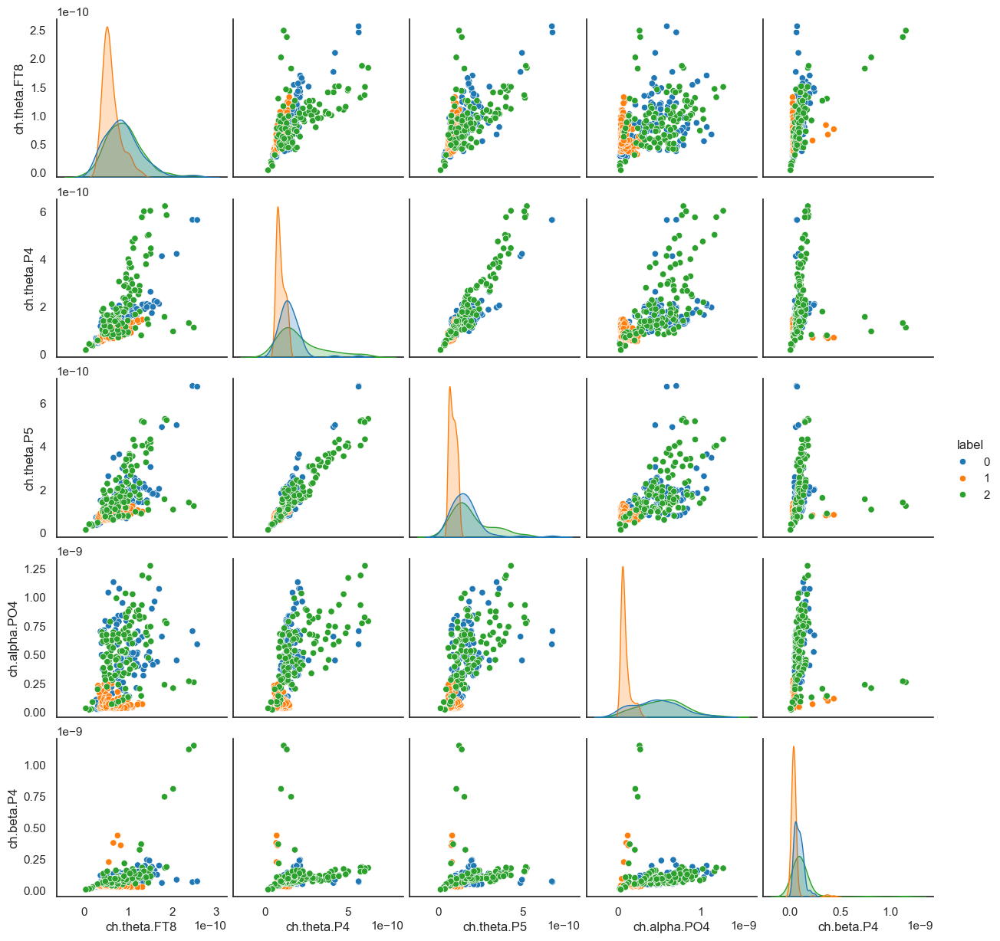

In [42]:
sns.pairplot(df_5features, hue = 'label', palette= "tab10")

UMAP Implementation

In [56]:
import umap.umap_ as mp
import seaborn as sns

reducer = mp.UMAP()

In [57]:
scaled_data = StandardScaler().fit_transform(X)

In [58]:
embedding = reducer.fit_transform(scaled_data)
embedding.shape

(360, 2)

Text(0.5, 1.0, 'UMAP projection of the Dataset')

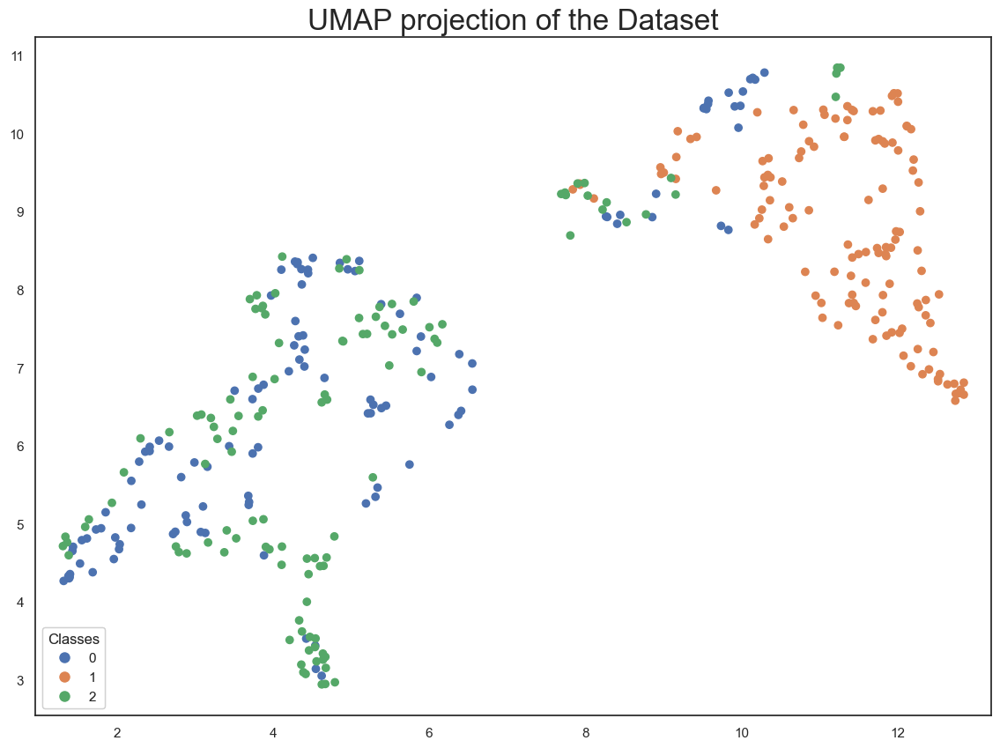

In [59]:
unique_label = df.label.unique()

fig, ax = plt.subplots()
scatter = ax.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=[sns.color_palette()[x] for x in df.label])

# Create a custom legend with unique colors and labels
legend_handles = []
for i, label in enumerate(unique_label):
    color = sns.color_palette()[i]
    handle = plt.Line2D([0], [0], marker='o', color='w', label=label,
                        markerfacecolor=color, markersize=10)
    legend_handles.append(handle)

legend = ax.legend(handles=legend_handles, loc="lower left", title="Classes")
ax.add_artist(legend)

plt.gca().set_aspect('equal','datalim')
plt.title('UMAP projection of the Dataset', fontsize=24)


Machine Learning Model - LDA, Feature: 256

In [49]:
clf = LinearDiscriminantAnalysis()
gkf = KFold(5)
pipe = Pipeline([('scaler',StandardScaler()),('clf',clf)])
param_grid={}
gscv = GridSearchCV(pipe, param_grid, refit=True)
gscv.fit(X, y)

scores = cross_val_score(gscv, X, y, cv=gkf)
print(scores)

print("%0.2f accuracy with a standard deviation of %0.2f" % (scores.mean(), scores.std()))

y_pred = gscv.predict(X)
print(classification_report(y,y_pred))

[0.15277778 0.27777778 0.70833333 0.81944444 0.38888889]
0.47 accuracy with a standard deviation of 0.25
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       119
           1       1.00      1.00      1.00       125
           2       1.00      1.00      1.00       116

    accuracy                           1.00       360
   macro avg       1.00      1.00      1.00       360
weighted avg       1.00      1.00      1.00       360



Machine Learning Model - Linear SVC, Feature: 256

In [55]:
clf = LinearSVC(dual='auto',max_iter=10000)
gkf = KFold(5)
pipe = Pipeline([('scaler',StandardScaler()),('clf',clf)])
param_grid={'clf__C':[0.25,0.5,0.75, 1]}
# param_grid={}
# gscv = GridSearchCV(pipe, param_grid,cv = gkf,n_jobs = 4)

gscv = GridSearchCV(pipe, param_grid)
gscv.fit(X, y)
# gkf.get_n_splits(feature,label)
scores = cross_val_score(gscv, X, y, cv=gkf)
print(scores)

c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarni

[0.30555556 0.56944444 1.         0.70833333 0.47222222]


In [ ]:
print("%0.2f accuracy with a standard deviation of %0.2f" % (scores.mean(), scores.std()))

0.75 accuracy with a standard deviation of 0.17


In [ ]:
y_pred = gscv.predict(X)
print(classification_report(y,y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       292
           1       1.00      1.00      1.00       308
           2       1.00      1.00      1.00       293

    accuracy                           1.00       893
   macro avg       1.00      1.00      1.00       893
weighted avg       1.00      1.00      1.00       893



Machine Learning Model - Linear SVC, Feature: 5

In [ ]:
clf = LinearSVC(dual = 'auto')
gkf = KFold(5)
pipe = Pipeline([('scaler',StandardScaler()),('clf',clf)])
# param_grid={'clf__C':[0.25,0.5,0.75, 1]}
param_grid={}
# gscv = GridSearchCV(pipe, param_grid,cv = gkf,n_jobs = 4)

gscv = GridSearchCV(pipe, param_grid, refit=True)
gscv.fit(X_5, y)
# gkf.get_n_splits(feature,label)
scores = cross_val_score(gscv, X_5, y, cv=gkf)
scores

c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\utils\validation.py:1300: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\utils\validation.py:1300: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Users\jeje_\anaconda3\

array([0.18994413, 0.63128492, 0.97765363, 0.47752809, 0.        ])

In [ ]:
print("%0.2f accuracy with a standard deviation of %0.2f" % (scores.mean(), scores.std()))

0.46 accuracy with a standard deviation of 0.34


In [ ]:
y_pred = gscv.predict(X_5)
print(classification_report(y,y_pred))

              precision    recall  f1-score   support

           0       0.70      0.57      0.63       292
           1       0.77      0.99      0.86       308
           2       0.62      0.55      0.58       293

    accuracy                           0.71       893
   macro avg       0.69      0.70      0.69       893
weighted avg       0.70      0.71      0.69       893



Machine Learning Model - Linear SVC Feature Test

In [ ]:
n_features = [5, 10, 15, 20, 25, 50, 100, 200, 256]
n_iterations = 10
results = np.zeros((len(n_features), n_iterations))

for i, n in enumerate(n_features):
    for j in range(n_iterations):
        X_feat = features.sample(n, axis =1)
        pipe.fit(X_feat,y)
        results[i,j] = pipe.score(X_feat,y)

c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\utils\validation.py:1300: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\svm\_base.py:1237: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\sklearn\utils\validation.py:1300: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Users\jeje_\anaconda3\

In [ ]:
averages = results.mean(1)

fig,ax = plt.subplots()
ax.plot(n_features, averages, linewidth = 2)
stds = results.std(1)
ax.fill_between(n_features, averages - stds, averages + stds, alpha = 0.2)

ax.set_xlabel("Number of brain features used")
ax.set_ylabel("Explained variance in age($R^2$)");

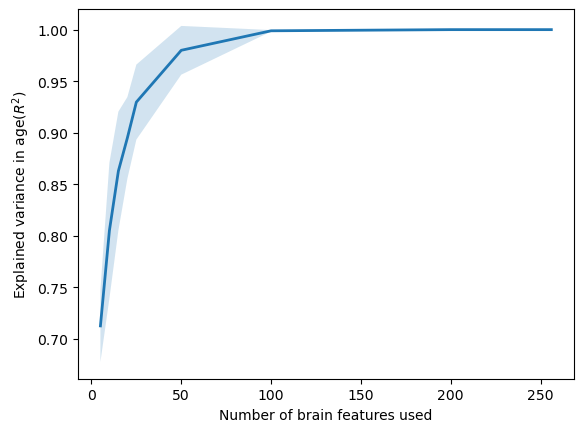

In [ ]:
plt.show()

Machine Learning Model - Linear Regression

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size =0.7)

est = LinearRegression()
pipe_est = Pipeline([('scaler',StandardScaler()),('est',est)])
pipe_est.fit(X_train, y_train)

print(pipe_est.score(X_test, y_test))

0.9684409638392983


In [ ]:
from sklearn.metrics import classification_report

y_pred = gscv.predict(X)
print(classification_report(y, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       292
           1       1.00      1.00      1.00       308

    accuracy                           1.00       600
   macro avg       1.00      1.00      1.00       600
weighted avg       1.00      1.00      1.00       600



In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn import svm
clf = svm.SVC(kernel='linear', C=1, random_state=42)
scores = cross_val_score(clf, feature, label, cv=5)
scores

array([0.50833333, 0.50833333, 0.51666667, 0.51666667, 0.51666667])

In [ ]:
print("%0.2f accuracy with a standard deviation of %0.2f" % (scores.mean(), scores.std()))

0.51 accuracy with a standard deviation of 0.00


## ERP: HEP

### Filter EEG Data BPF 1.0 - 40.0 Hz

Using Pan Tompkins results as the R Wave Detector

In [24]:
r_peak_onset = []
for i in range(len(result)):
    ons_idx = int(fs*tmin)+result[i]
    r_peak_onset.append(ons_idx)

pan_tompkins_events = np.zeros((len(r_peak_onset), 3), dtype=int)

pan_tompkins_events[:, 0] = r_peak_onset
pan_tompkins_events[:, 1] = 0 
pan_tompkins_events[:, 2] = 7

# reconst_raw.plot(events = pan_tompkins_events)

In [25]:
new_filt_raw = reconst_raw.load_data().copy().filter(l_freq=1.0, h_freq=40, picks = ['eeg'])

new_filt_firstrest = new_filt_raw.copy().crop(tmin = 0, tmax = eeg_newseg1)
new_filt_stress = new_filt_raw.copy().crop(tmin = eeg_newseg1, tmax = eeg_newseg2)
new_filt_secondrest = new_filt_raw.copy().crop(tmin = eeg_newseg2)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 3301 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


In [27]:
epoch_tmin = -0.2
epoch_tmax = 0.6
baseline = (None,0)
# eeg_ch_names = raw_eeg.ch_names

Using channel ECG to identify heart beats.
Setting up band-pass filter from 5 - 35 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 5.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 4.75 Hz)
- Upper passband edge: 35.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 35.25 Hz)
- Filter length: 10000 samples (10.000 s)

Number of ECG events detected : 310 (average pulse 51 / min.)
Not setting metadata
311 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


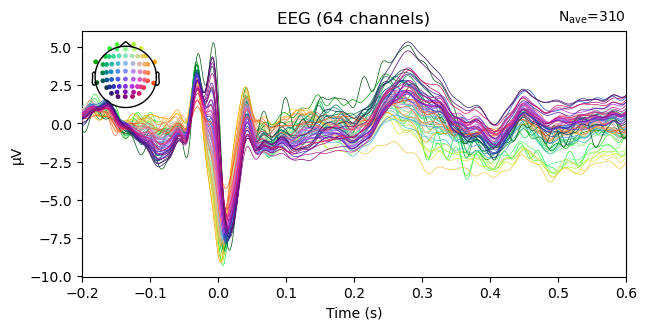

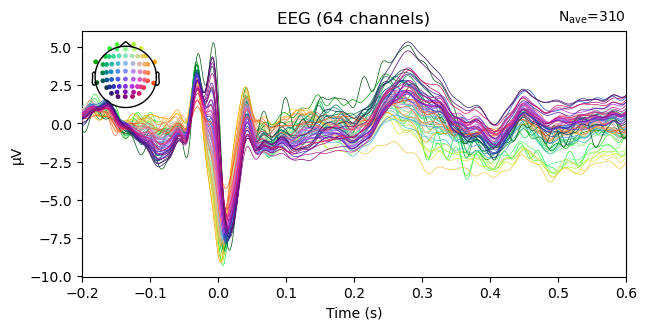

In [28]:
ecg_event,_,_ = mne.preprocessing.find_ecg_events(new_filt_raw)
ecg_epoch = mne.Epochs(new_filt_raw,events = pan_tompkins_events, tmin= epoch_tmin, tmax = epoch_tmax, baseline = baseline, picks = ['eeg'])
ecg_evoked = ecg_epoch.average()
ecg_evoked.plot()

# ecg_evoked = create_ecg_epochs(raw_temp).average()
# ecg_evoked.apply_baseline(baseline=(None, None))

Not setting metadata
311 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No projector specified for this dataset. Please consider the method self.add_proj.
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


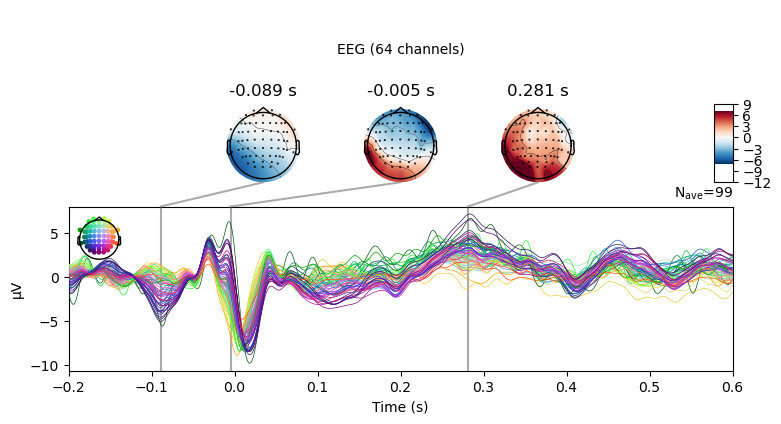

In [29]:
first_rest_epoch = mne.Epochs(new_filt_firstrest,events = pan_tompkins_events, tmin= epoch_tmin, tmax = epoch_tmax, baseline = baseline, picks = ['eeg'])
first_rest_evoked = first_rest_epoch.average()
# first_rest_evoked.plot()
# first_rest_evoked.plot_topomap()
first_rest_evoked.plot_joint()

hep_data_first_rest = first_rest_evoked.get_data()
hep_data_first_rest = hep_data_first_rest.T

Not setting metadata
311 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No projector specified for this dataset. Please consider the method self.add_proj.
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


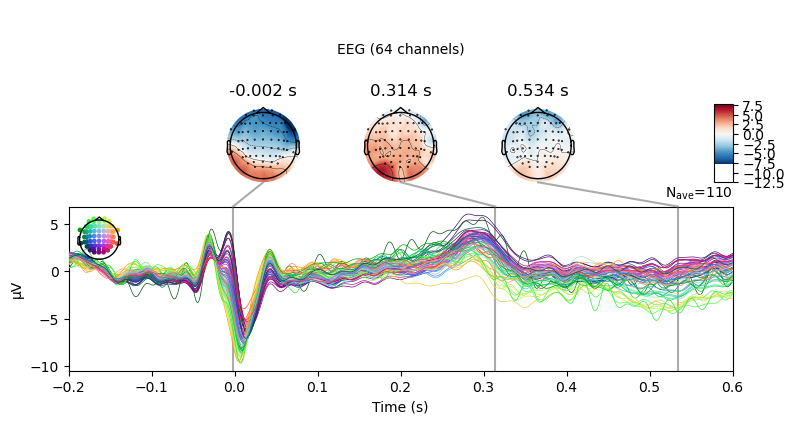

In [30]:
stress_epoch = mne.Epochs(new_filt_stress,events = pan_tompkins_events, tmin= epoch_tmin, tmax = epoch_tmax, baseline = baseline, picks = ['eeg'])
stress_evoked = stress_epoch.average()
# stress_evoked.plot()
# stress_evoked.plot_topomap()
stress_evoked.plot_joint()

hep_data_stress = stress_evoked.get_data()
hep_data_stress = hep_data_stress.T

Not setting metadata
311 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No projector specified for this dataset. Please consider the method self.add_proj.
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


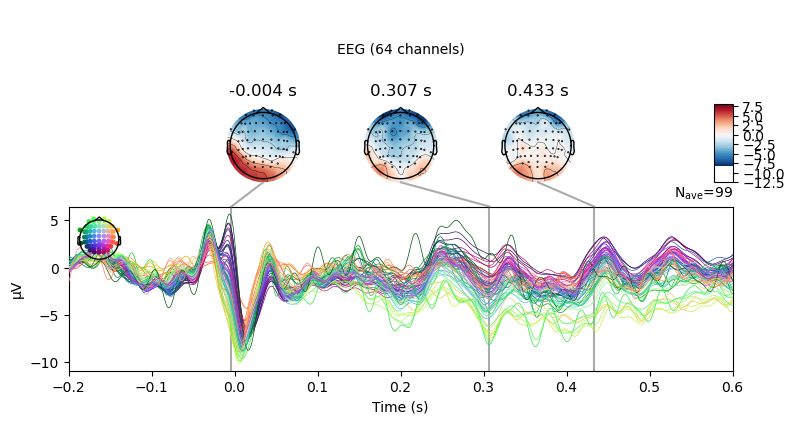

In [31]:
second_rest_epoch = mne.Epochs(new_filt_secondrest,events = pan_tompkins_events, tmin= epoch_tmin, tmax = epoch_tmax, baseline = baseline, picks = ['eeg'])
second_rest_evoked = second_rest_epoch.average()
# second_rest_evoked.plot()
# second_rest_evoked.plot_topomap()
second_rest_evoked.plot_joint()


hep_data_second_rest = second_rest_evoked.get_data()
hep_data_second_rest = hep_data_second_rest.T

combining channels using "mean"
combining channels using "mean"
combining channels using "mean"


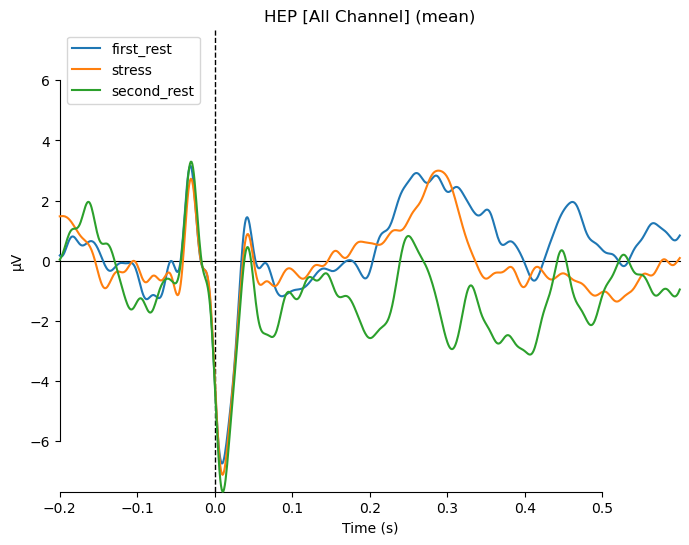

combining channels using "gfp"
combining channels using "gfp"
combining channels using "gfp"


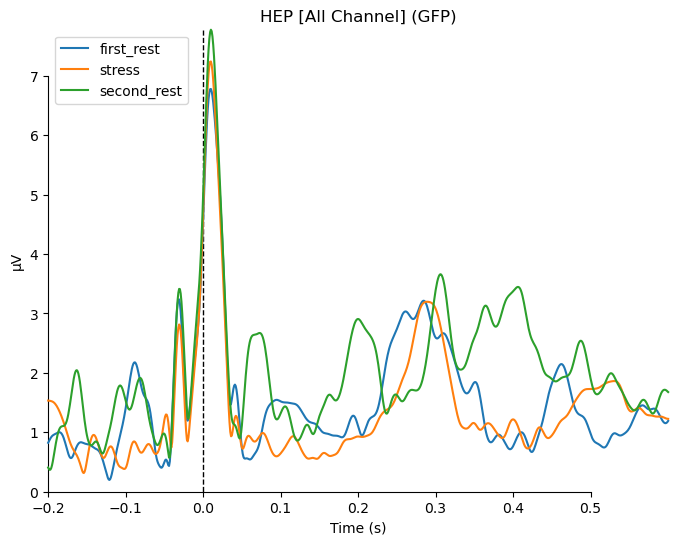

[<Figure size 800x600 with 1 Axes>]

In [32]:
evokeds = dict(first_rest = first_rest_evoked,stress = stress_evoked,second_rest = second_rest_evoked)
mne.viz.plot_compare_evokeds(evokeds,title = 'HEP [All Channel]', combine="mean")
mne.viz.plot_compare_evokeds(evokeds,title = 'HEP [All Channel]', combine="gfp")

### ECG Epoch

In [33]:
r_peak_onset = []
for i in range(len(result)):
    ons_idx = int(fs*tmin)+result[i]
    r_peak_onset.append(ons_idx)

pan_tompkins_events = np.zeros((len(r_peak_onset), 3), dtype=int)

pan_tompkins_events[:, 0] = r_peak_onset
pan_tompkins_events[:, 1] = 0 
pan_tompkins_events[:, 2] = 7


In [34]:
epoch_tmin = -0.2
epoch_tmax = 0.6
baseline = (None, 0)

In [35]:
# Invert the ECG signal
raw_ecg_inverted = raw_ecg.copy()
raw_ecg_inverted.load_data()

raw_ecg_inverted.apply_function(lambda x: -x, picks='ECG')

# Proceed with your existing analysis using the inverted ECG signal
ecg_check = raw_ecg_inverted.copy()

ecg_check.set_channel_types({'ECG':'eeg'})

filt_ecg = ecg_check.load_data().copy().filter(l_freq=1.0, h_freq=40, picks = 'eeg')

filt_ecg_firstrest = filt_ecg.copy().crop(tmin = 0, tmax =newseg1)
filt_ecg_stress = filt_ecg.copy().crop(tmin = newseg1, tmax = newseg2)
filt_ecg_secondrest = filt_ecg.copy().crop(tmin = newseg2)

Reading 0 ... 360478  =      0.000 ...   360.478 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 3301 samples (3.301 s)



In [36]:
filt_ecg_epoch = mne.Epochs(filt_ecg, events = pan_tompkins_events, tmin= epoch_tmin, tmax = epoch_tmax, baseline = baseline)

Not setting metadata
311 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated


Not setting metadata
311 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Need more than one channel to make topography for eeg. Disabling interactivity.


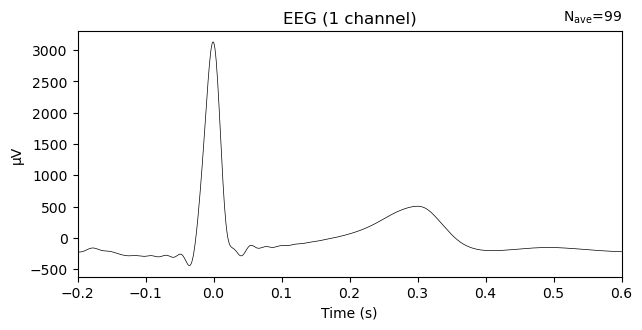

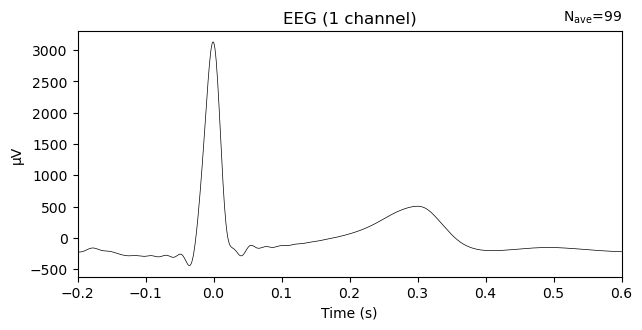

In [37]:
ecg_firstrest_epoch = mne.Epochs(filt_ecg_firstrest, events = pan_tompkins_events, tmin= epoch_tmin, tmax = epoch_tmax, baseline = baseline)
ecg_firstrest_evoked = ecg_firstrest_epoch.average()
ecg_firstrest_evoked.plot()

Not setting metadata
311 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Need more than one channel to make topography for eeg. Disabling interactivity.


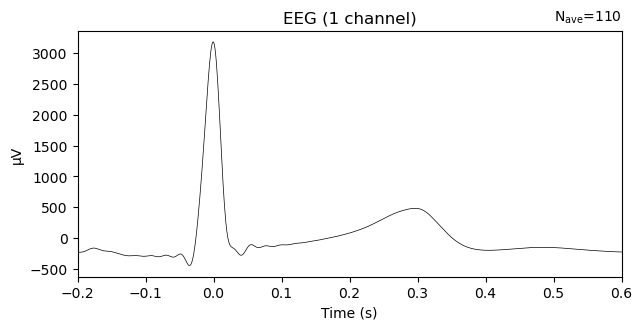

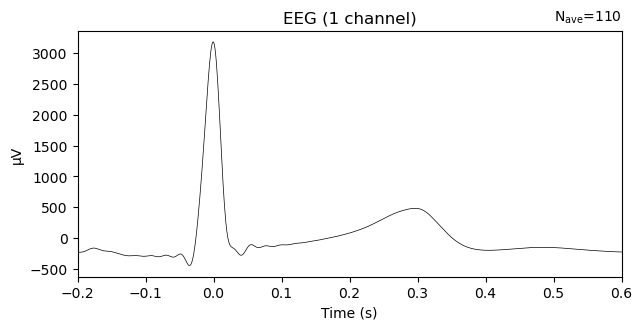

In [38]:
ecg_stress_epoch = mne.Epochs(filt_ecg_stress, events = pan_tompkins_events, tmin= epoch_tmin, tmax = epoch_tmax, baseline = baseline)
ecg_stress_evoked = ecg_stress_epoch.average()
ecg_stress_evoked.plot()

Not setting metadata
311 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Need more than one channel to make topography for eeg. Disabling interactivity.


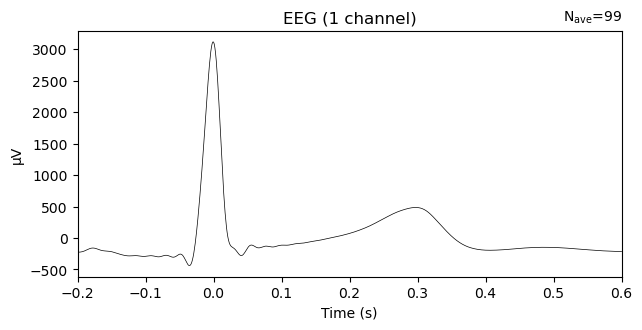

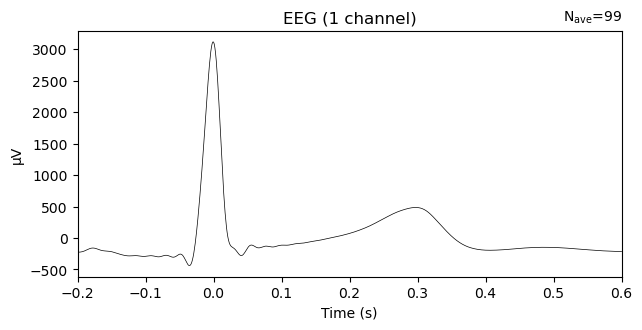

In [39]:
ecg_secondrest_epoch = mne.Epochs(filt_ecg_secondrest, events = pan_tompkins_events, tmin= epoch_tmin, tmax = epoch_tmax, baseline = baseline)
ecg_secondrest_evoked = ecg_secondrest_epoch.average()
ecg_secondrest_evoked.plot()

combining channels using "mean"
combining channels using "mean"
combining channels using "mean"


C:\Users\jeje_\AppData\Local\Temp\ipykernel_34884\1846846685.py:2: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "mean".
  mne.viz.plot_compare_evokeds(evokeds,title = 'ECG',combine="mean")
C:\Users\jeje_\AppData\Local\Temp\ipykernel_34884\1846846685.py:2: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  mne.viz.plot_compare_evokeds(evokeds,title = 'ECG',combine="mean")


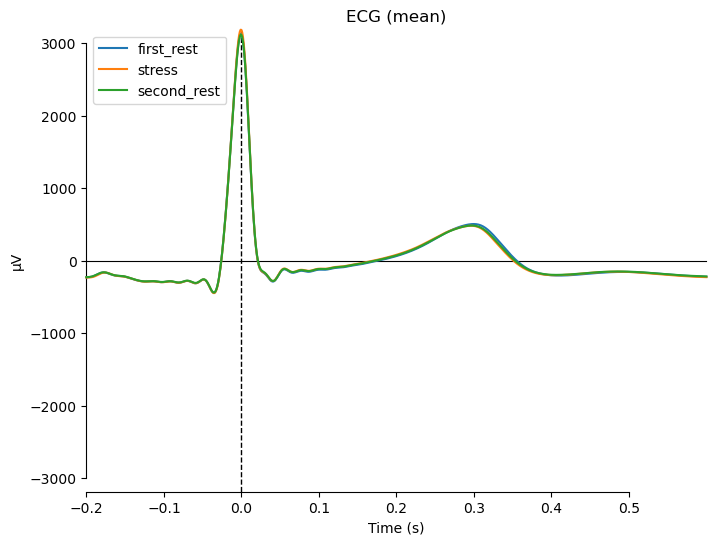

combining channels using "gfp"


C:\Users\jeje_\AppData\Local\Temp\ipykernel_34884\1846846685.py:3: RuntimeWarning: Only 1 channel in "picks"; cannot combine by method "gfp".
  mne.viz.plot_compare_evokeds(evokeds,title = 'ECG',combine="gfp")


combining channels using "gfp"
combining channels using "gfp"


C:\Users\jeje_\AppData\Local\Temp\ipykernel_34884\1846846685.py:3: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  mne.viz.plot_compare_evokeds(evokeds,title = 'ECG',combine="gfp")


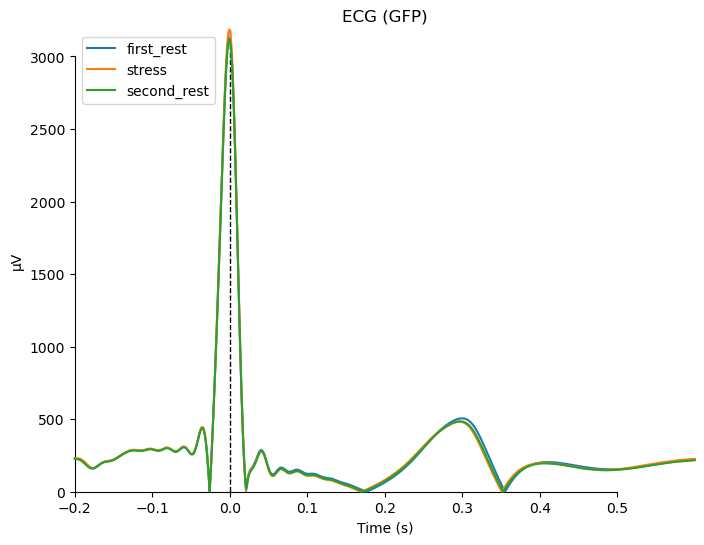

[<Figure size 800x600 with 1 Axes>]

In [40]:
evokeds = dict(first_rest = ecg_firstrest_evoked,stress = ecg_stress_evoked,second_rest = ecg_secondrest_evoked)
mne.viz.plot_compare_evokeds(evokeds,title = 'ECG',combine="mean")
mne.viz.plot_compare_evokeds(evokeds,title = 'ECG',combine="gfp")

### Export Epoch

In [42]:
first_rest_epoch.save("epoch_data/20240418_B98_jikken_0004-epoch_first_rest-epo.fif", overwrite=True)
stress_epoch.save("epoch_data/20240418_B98_jikken_0004-epoch_stress-epo.fif", overwrite=True)
second_rest_epoch.save("epoch_data/20240418_B98_jikken_0004-epoch_second_rest-epo.fif", overwrite=True)

Overwriting existing file.
Using data from preloaded Raw for 311 events and 801 original time points ...
212 bad epochs dropped
Using data from preloaded Raw for 1 events and 801 original time points ...
Using data from preloaded Raw for 99 events and 801 original time points ...
Overwriting existing file.
Using data from preloaded Raw for 311 events and 801 original time points ...
201 bad epochs dropped
Using data from preloaded Raw for 1 events and 801 original time points ...
Using data from preloaded Raw for 110 events and 801 original time points ...
Overwriting existing file.
Using data from preloaded Raw for 311 events and 801 original time points ...
212 bad epochs dropped
Using data from preloaded Raw for 1 events and 801 original time points ...
Using data from preloaded Raw for 99 events and 801 original time points ...


### T-Test

In [32]:
from scipy.stats import ttest_ind

In [33]:
first_rest_epoch_data = first_rest_epoch.get_data()
stress_epoch_data = stress_epoch.get_data()

Using data from preloaded Raw for 99 events and 801 original time points ...
Using data from preloaded Raw for 110 events and 801 original time points ...


In [34]:
t_test_epoch = ttest_ind(first_rest_epoch_data,stress_epoch_data)

In [35]:
first_rest_avg_epoch_data = np.mean(first_rest_epoch_data, axis = 0)
stress_avg_epoch_data = np.mean(stress_epoch_data, axis = 0)

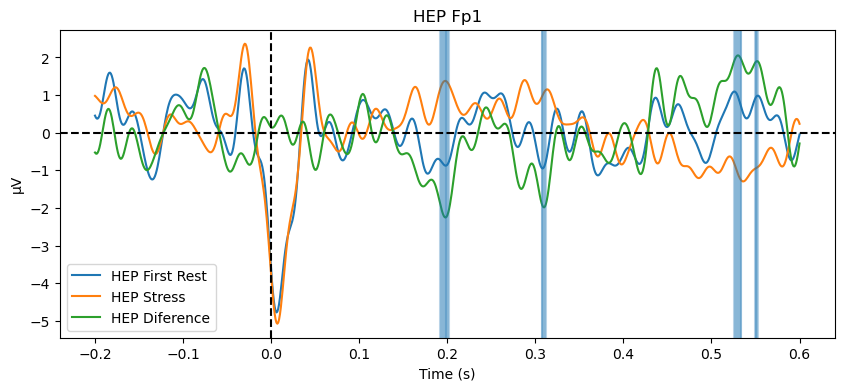

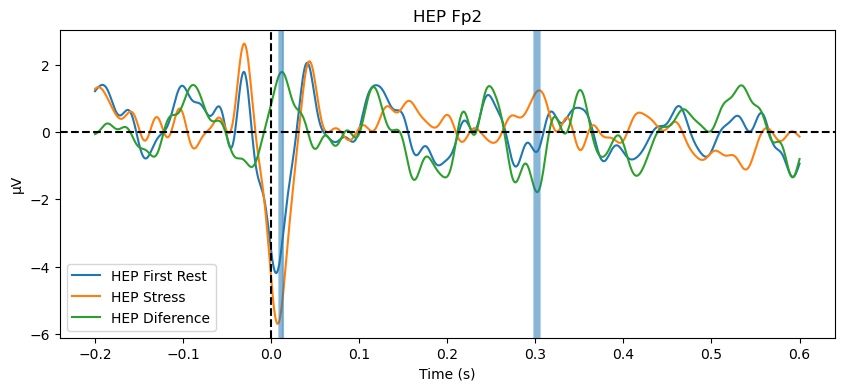

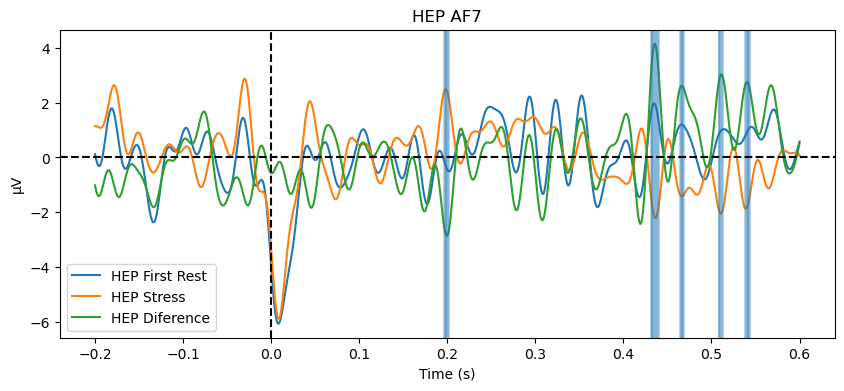

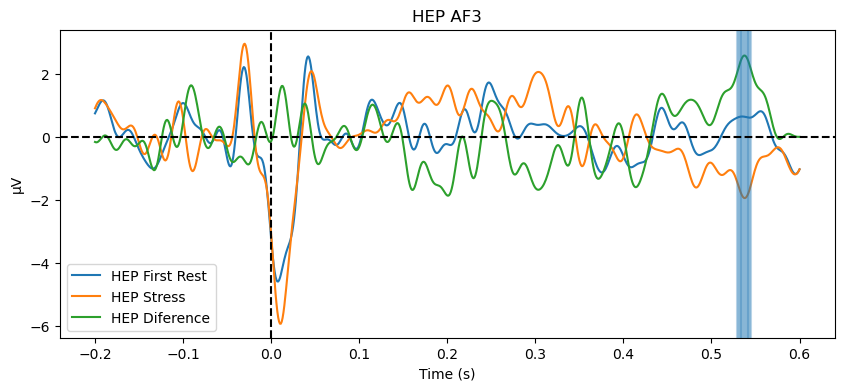

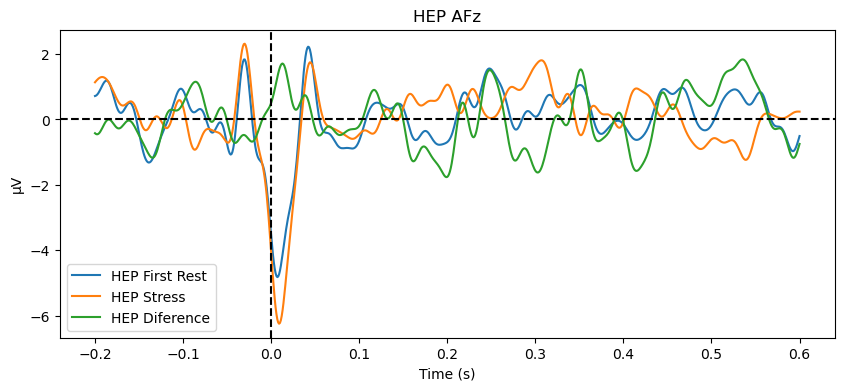

...

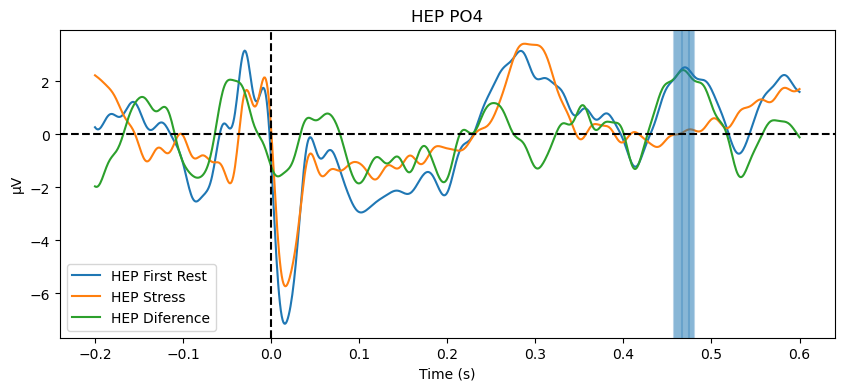

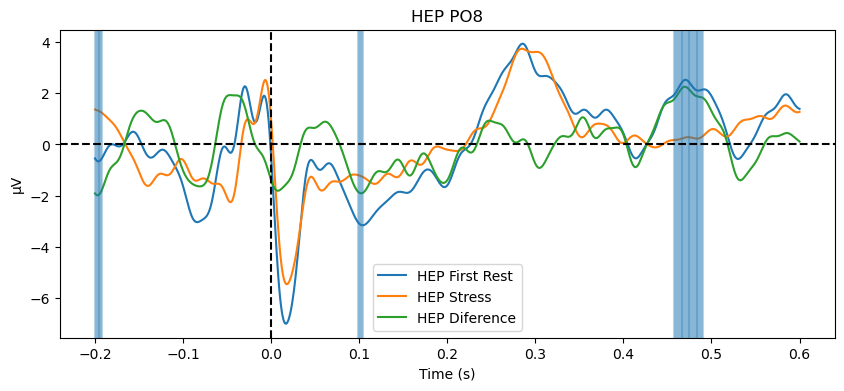

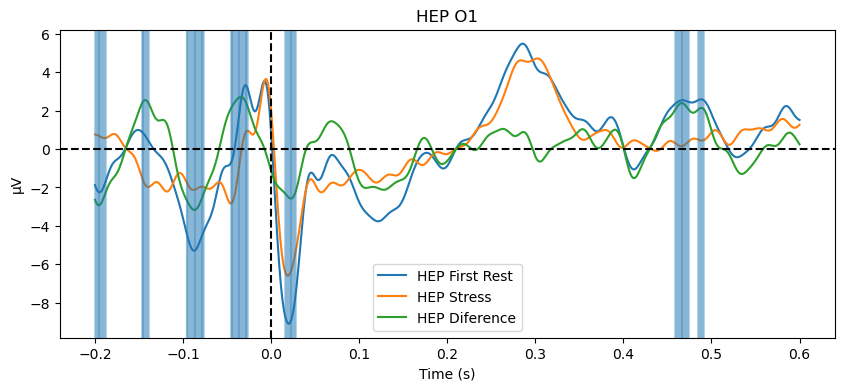

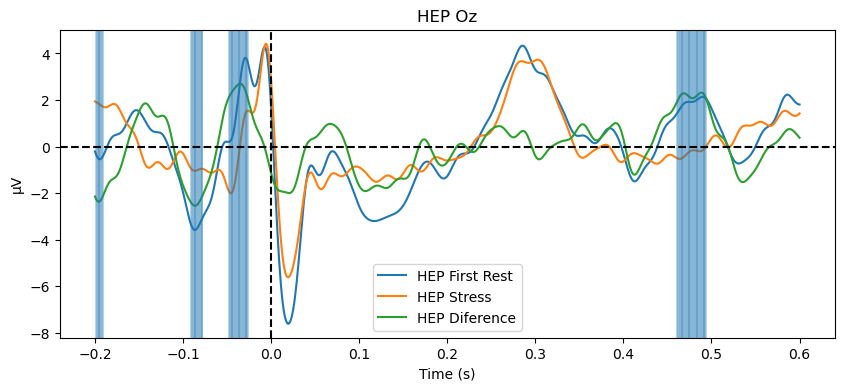

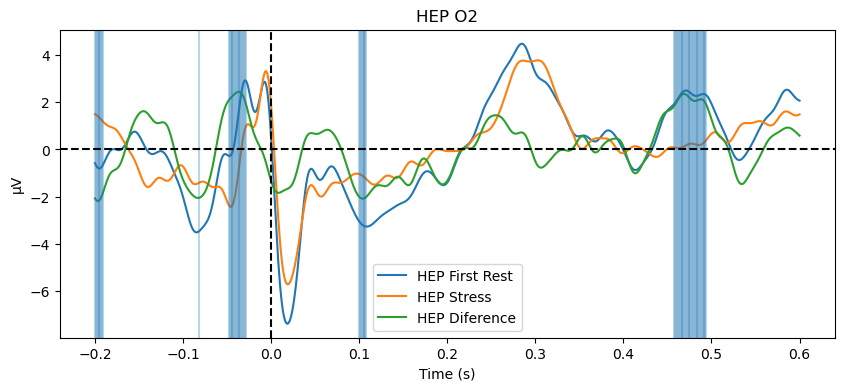

In [36]:
time_space = 1/fs
epoch_time = np.arange(epoch_tmin, epoch_tmax+time_space, time_space) 
erp_diff = first_rest_avg_epoch_data - stress_avg_epoch_data

for j in range(len(first_rest_avg_epoch_data)):
    ch_name = eeg_ch_names[j]

    plt.figure(figsize= (10,4))
    plt.plot(epoch_time,first_rest_avg_epoch_data[j] * 1e6, label = 'HEP First Rest')
    plt.plot(epoch_time,stress_avg_epoch_data[j]* 1e6, label = 'HEP Stress')
    plt.plot(epoch_time,erp_diff[j]* 1e6, label = 'HEP Diference')
    for i in range(len(t_test_epoch.pvalue[j])):
        if t_test_epoch.pvalue[j][i] <= 0.05:
            plt.axvline(x = (i*time_space)+epoch_tmin, ymin = 0 , ymax = 1, alpha = 0.3)
    plt.axvline(0, linestyle = '--', c = 'black')
    plt.axhline(0, linestyle = '--', c = 'black')
    plt.ylabel('μV')
    plt.xlabel('Time (s)')
    plt.legend()
    plt.title('HEP '+ ch_name)
    plt.show()

## Other

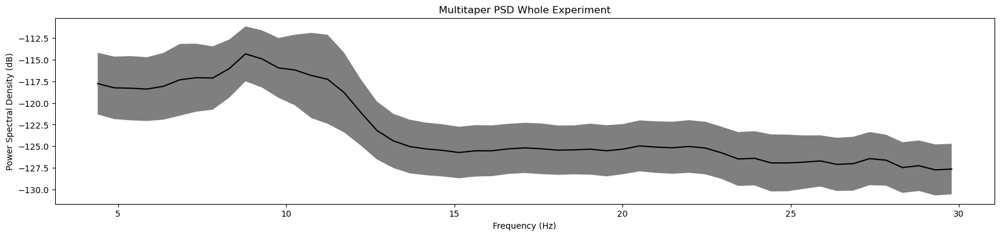

In [ ]:
psds, freqs = eeg_psd.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD Whole Experiment")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
del(psds,psds_mean,psds_std, freqs)

Effective window size : 100.000 (s)


c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\mne\viz\utils.py:161: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


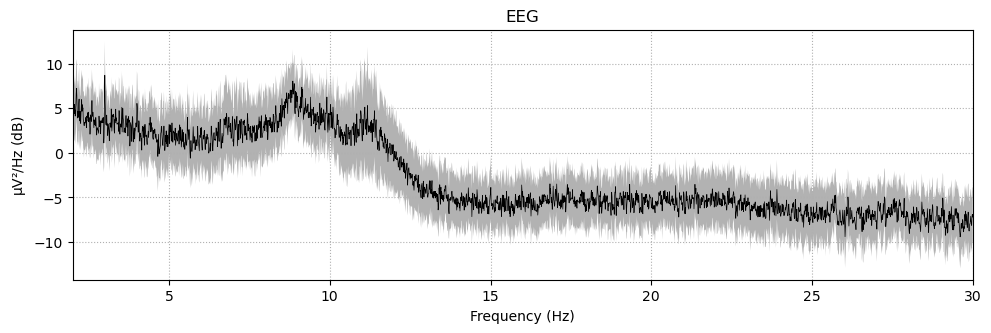

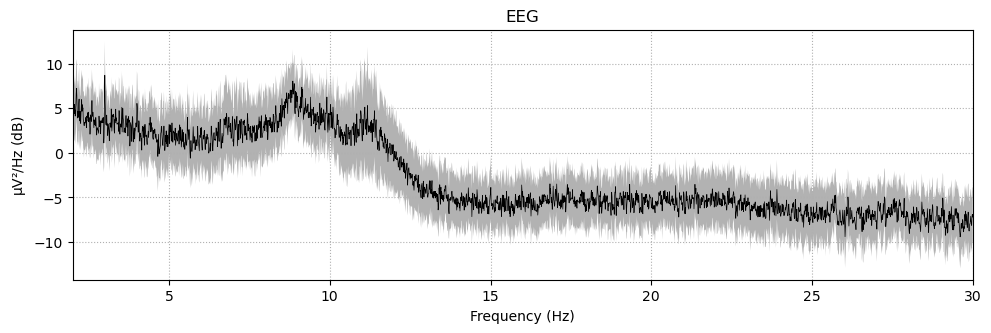

In [ ]:
nperseg = 100000
noverlap = int(nperseg*2/3)
reconst_raw.compute_psd(method ='welch',fmin= 2.0, fmax = 30, n_fft = nperseg, n_overlap = noverlap, n_per_seg = nperseg).plot(average = True, picks = 'eeg')

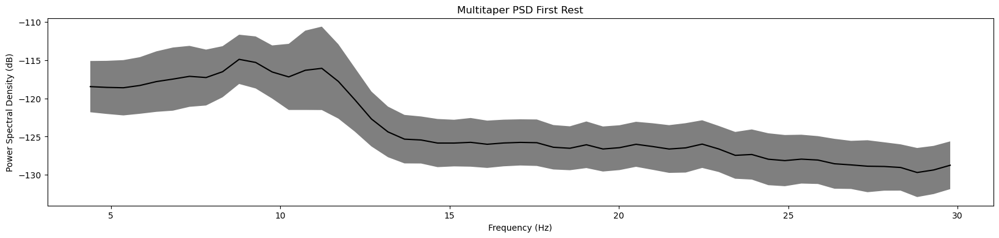

In [ ]:
psds, freqs = psd_firstrest.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD First Rest")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
# del(psds,psds_mean,psds_std, freqs)

Effective window size : 100.000 (s)


c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\mne\viz\utils.py:137: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


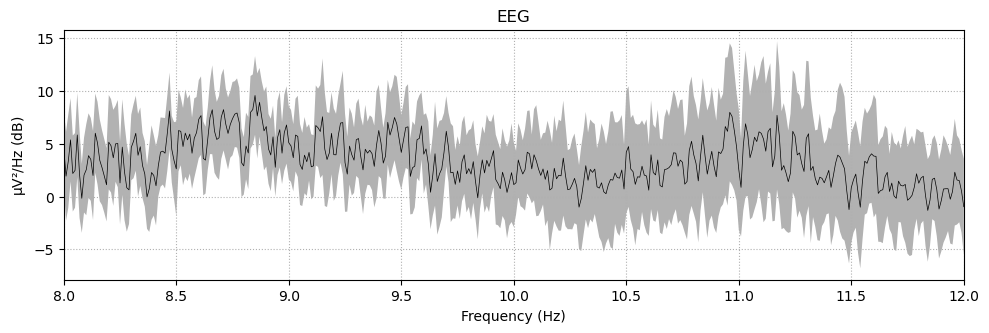

In [ ]:
nperseg = 100000
noverlap = int(nperseg*2/3)
ica_firstrest.compute_psd(method ='welch',fmin= 8.0, fmax = 12, n_fft = nperseg, n_overlap = noverlap, n_per_seg = nperseg).plot(average = True, picks = 'eeg')

Effective window size : 100.000 (s)


c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\mne\viz\utils.py:137: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


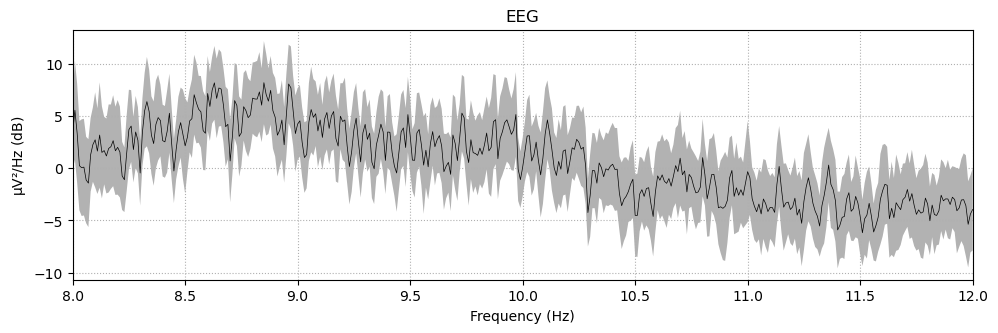

In [ ]:
nperseg = 100000
noverlap = int(nperseg*2/3)
ica_stress.compute_psd(method ='welch',fmin= 8.0, fmax = 12, n_fft = nperseg, n_overlap = noverlap, n_per_seg = nperseg).plot(average = True, picks = 'eeg')

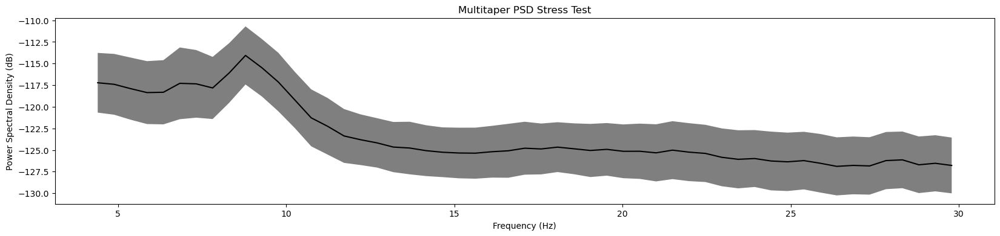

In [ ]:
psds, freqs = psd_stress.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD Stress Test")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
del(psds,psds_mean,psds_std, freqs)

Effective window size : 100.000 (s)


c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\mne\viz\utils.py:161: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


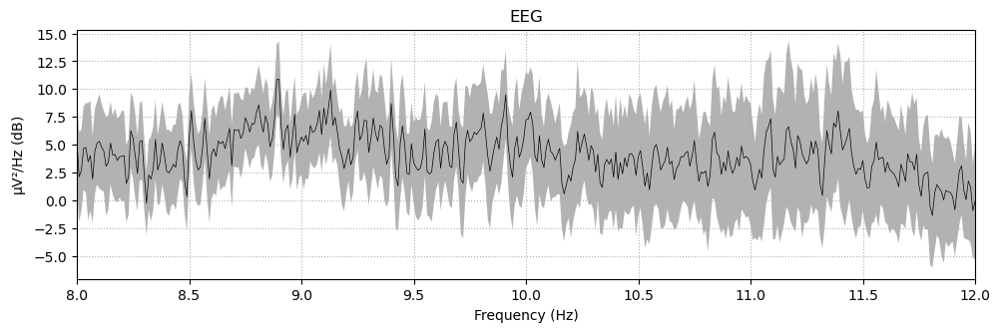

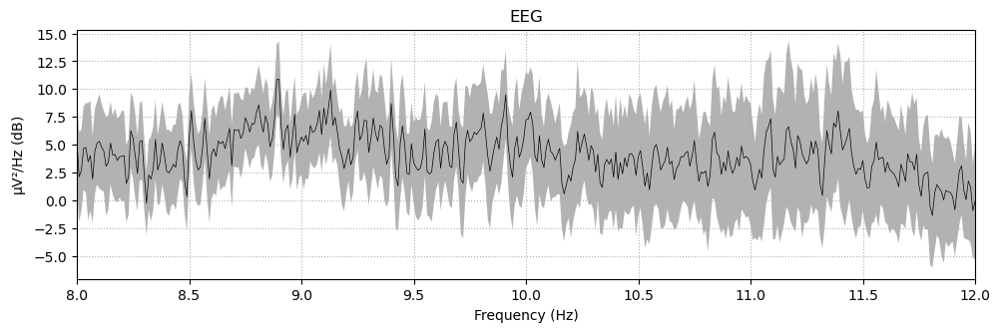

In [ ]:
nperseg = 100000
noverlap = int(nperseg*2/3)
ica_secondrest.compute_psd(method ='welch',fmin= 8.0, fmax = 12, n_fft = nperseg, n_overlap = noverlap, n_per_seg = nperseg).plot(average = True, picks = 'eeg')

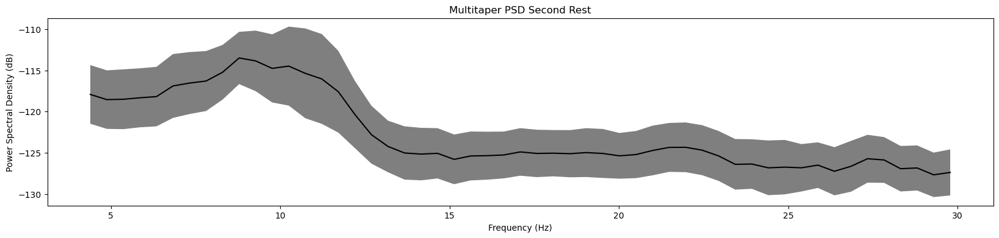

In [ ]:
psds, freqs = psd_secondrest.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD Second Rest")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
del(psds,psds_mean,psds_std, freqs)

In [27]:
epochs = mne.Epochs(reconst_raw, events, tmin=-0.2, tmax = 1, preload=True, reject = None)

Not setting metadata
47 matching events found
Setting baseline interval to [-0.2, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 47 events and 1201 original time points ...
5 bad epochs dropped


In [28]:
eeg_temp = reconst_raw.copy().pick_types(eeg=True, eog=False, ecg=False)
channel = eeg_temp.ch_names

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.7s


NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


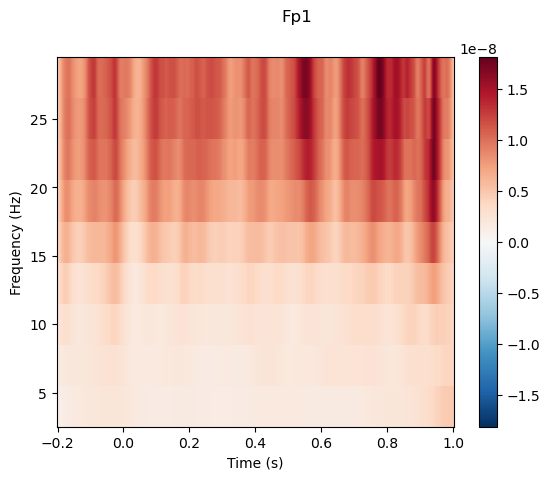

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


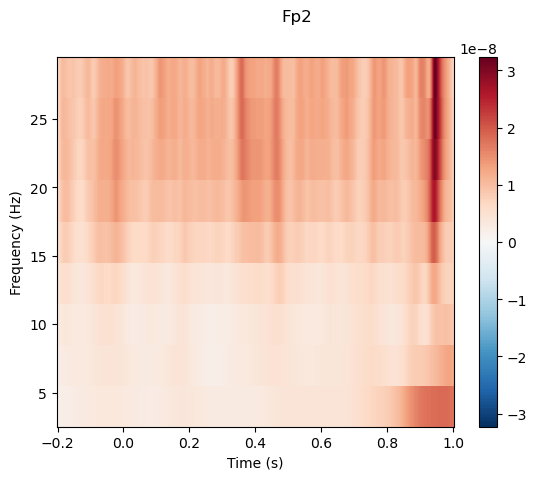

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


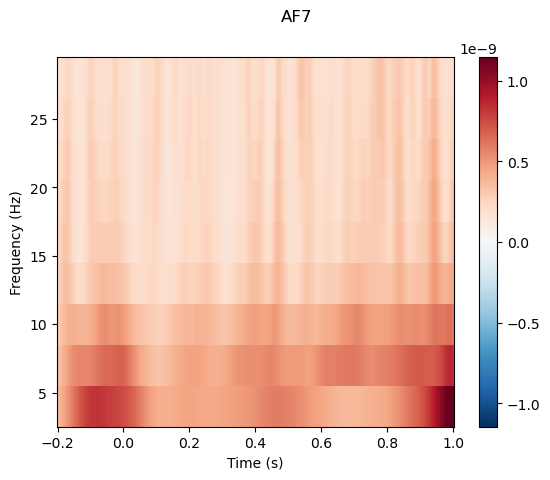

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


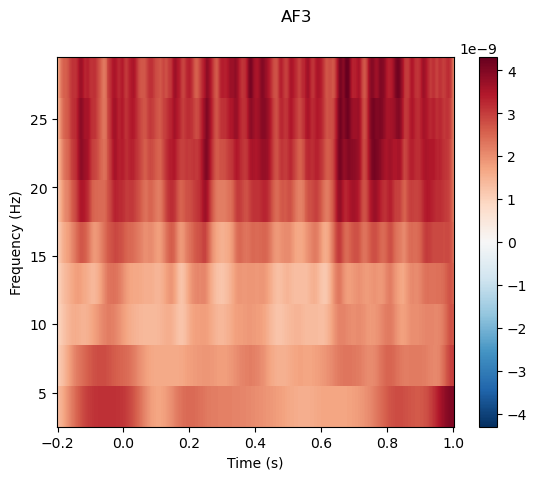

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


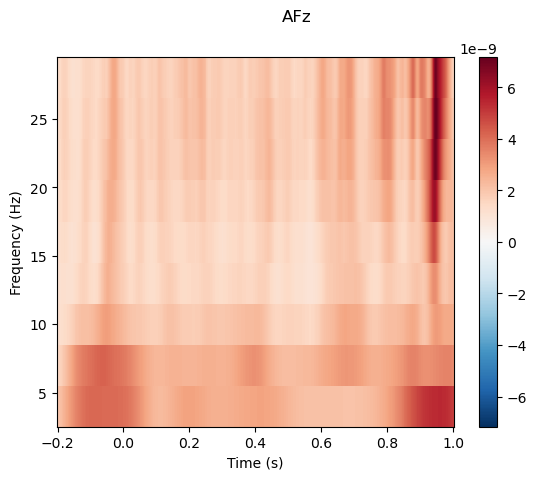

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


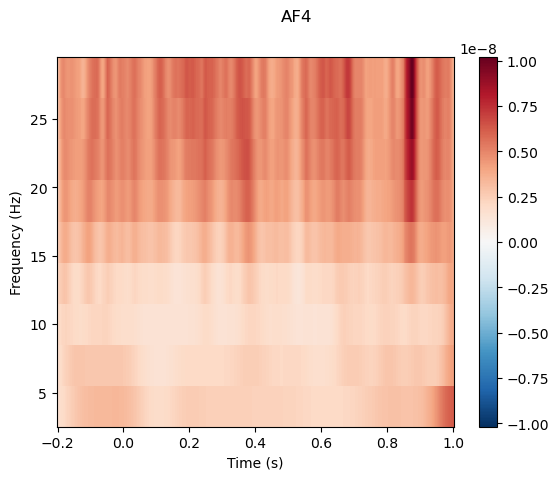

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


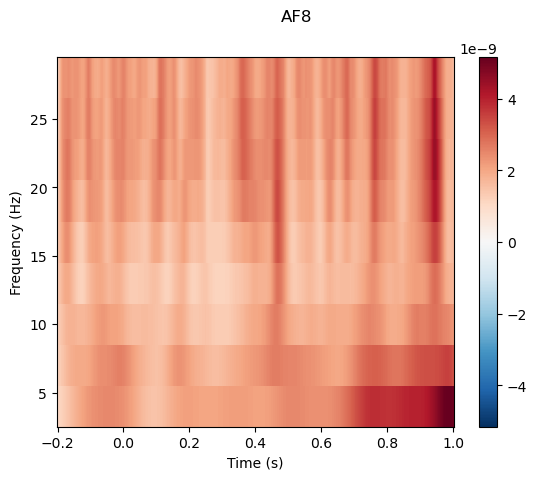

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


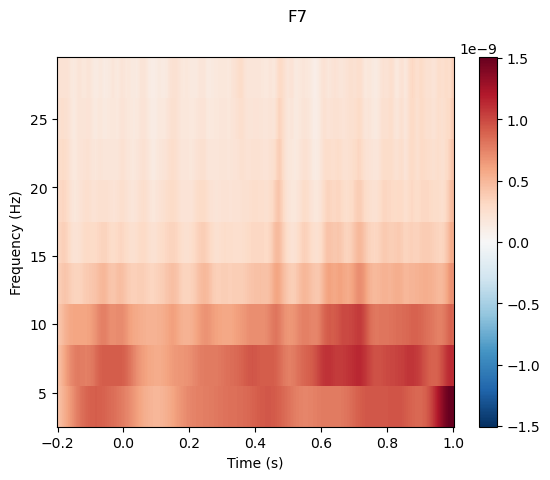

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


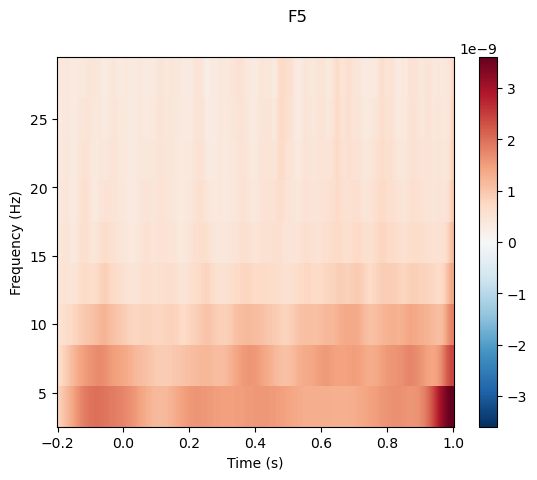

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


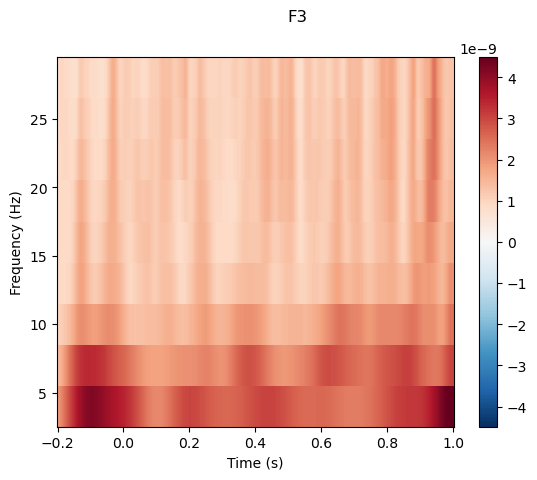

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


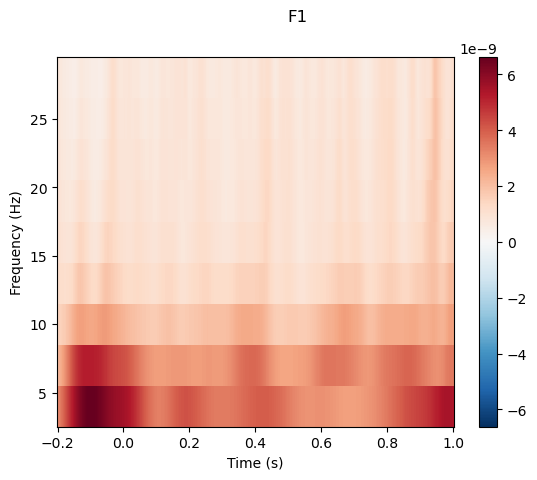

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


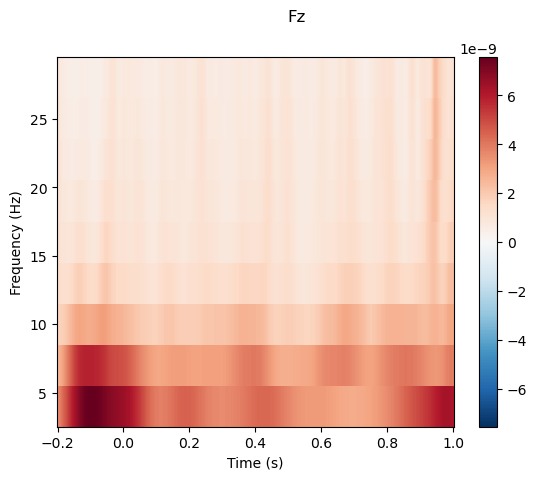

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


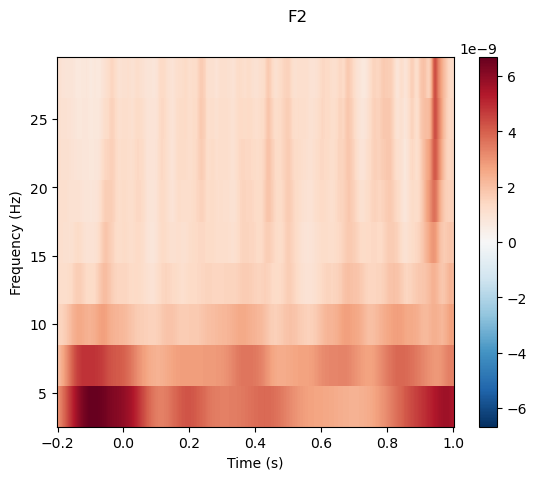

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


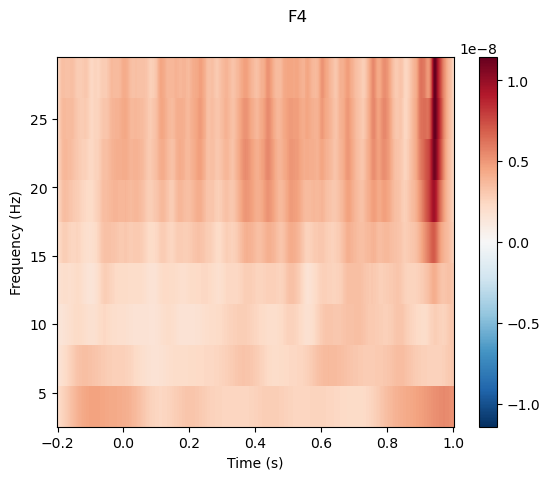

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


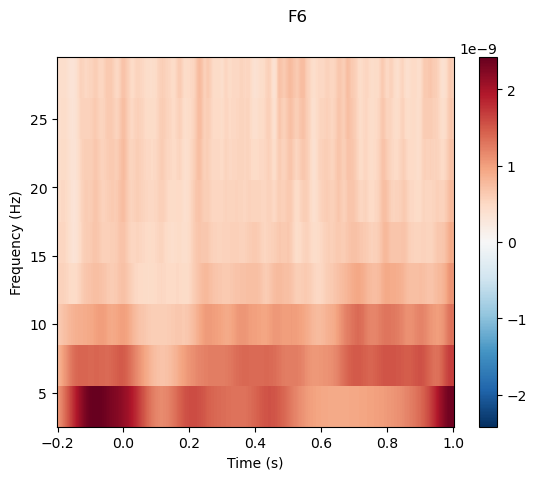

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


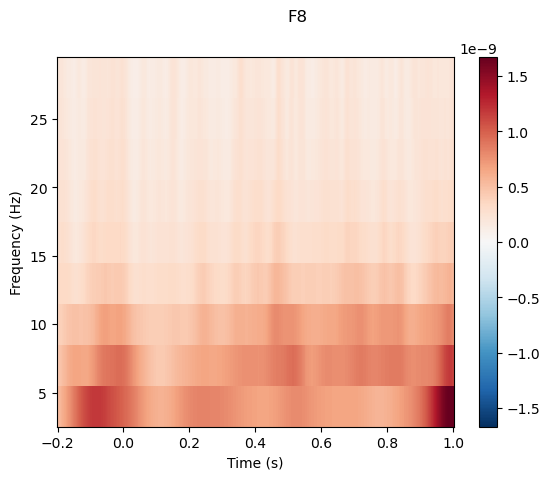

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


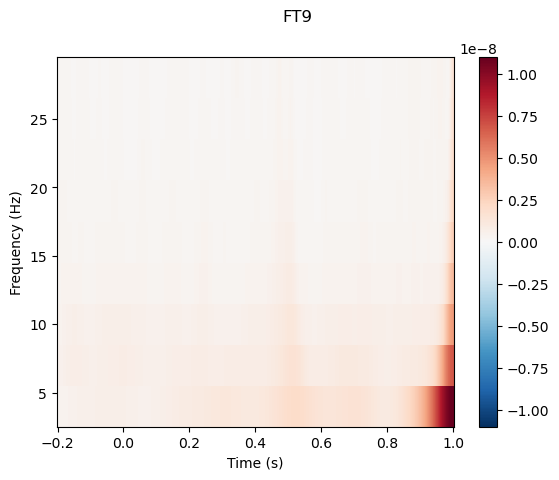

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


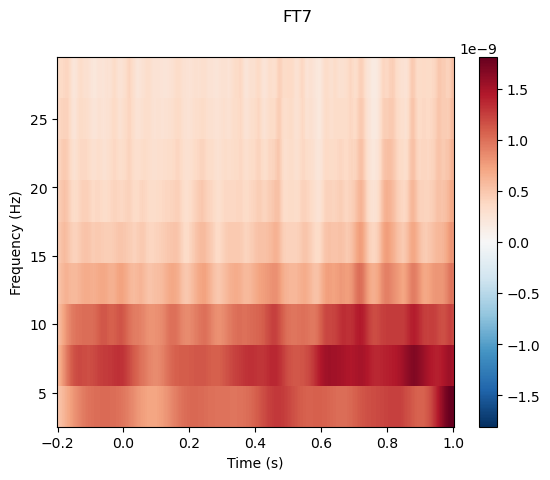

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


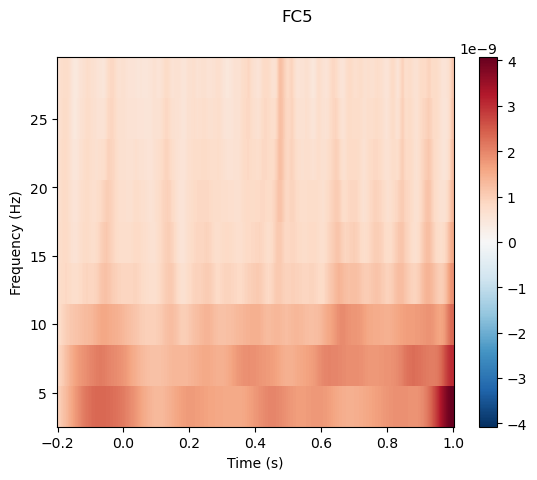

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


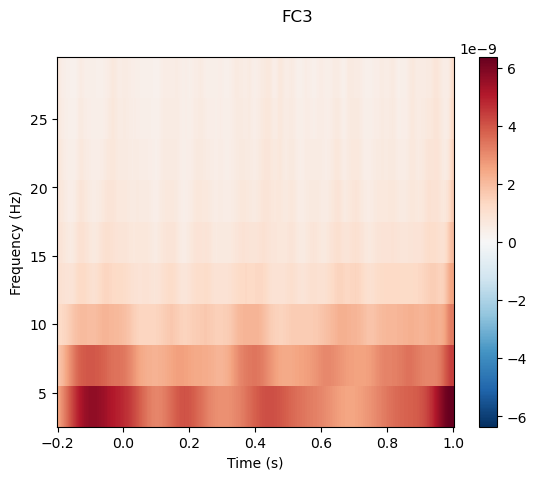

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


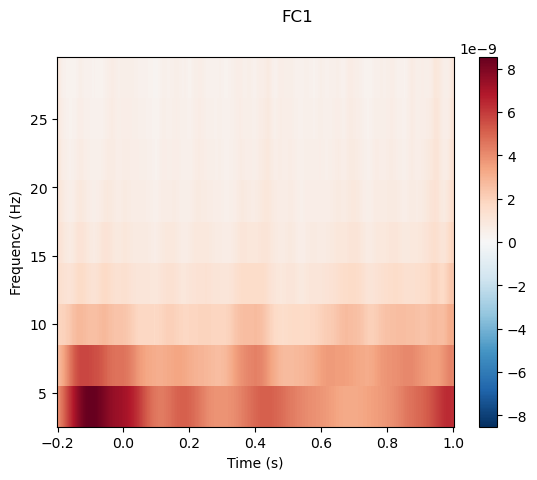

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


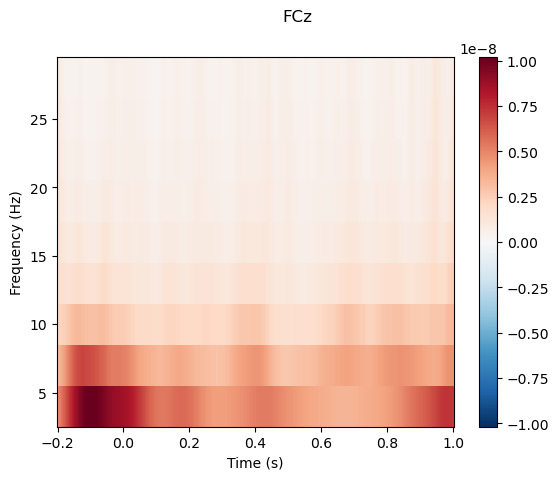

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


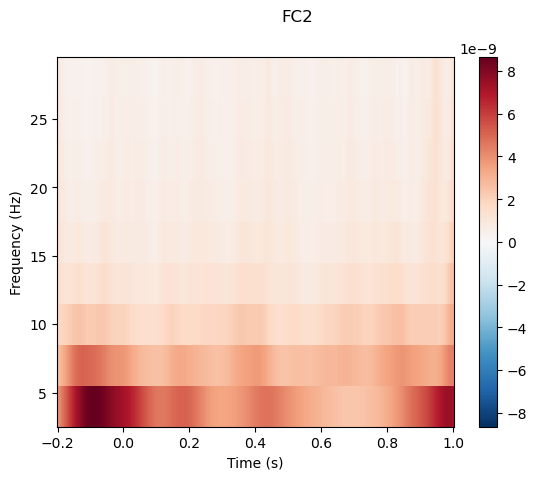

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


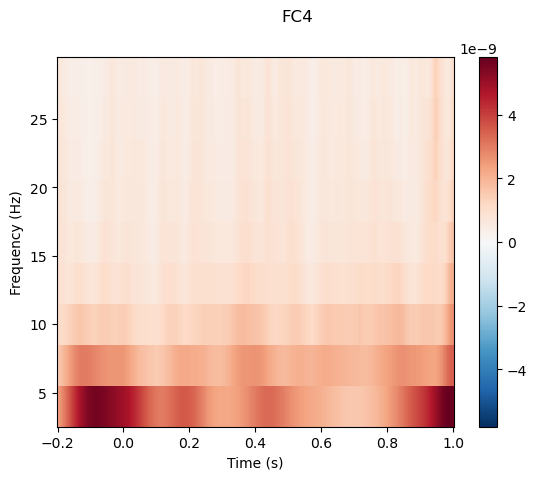

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


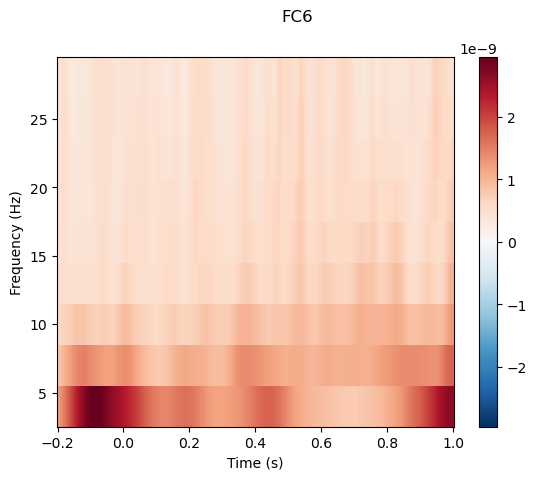

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


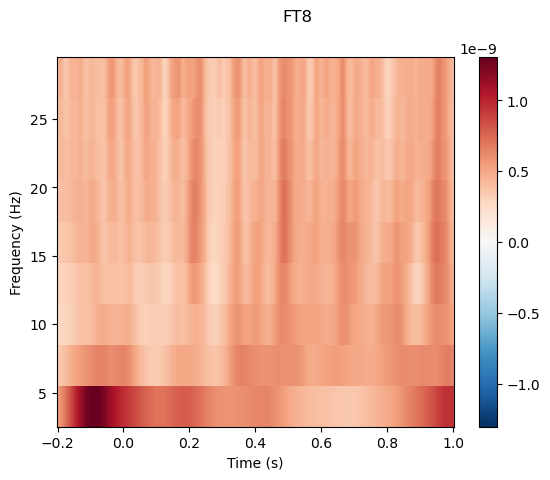

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


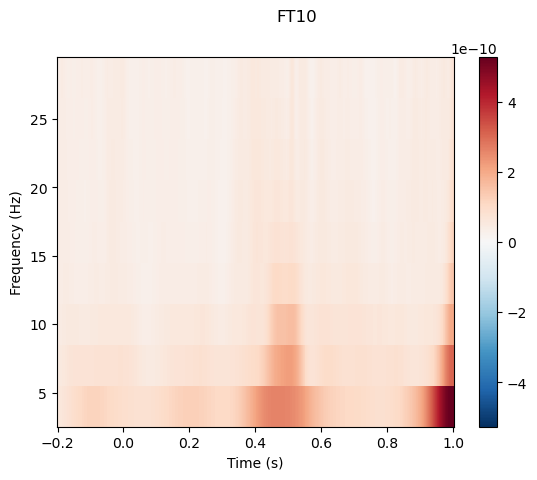

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


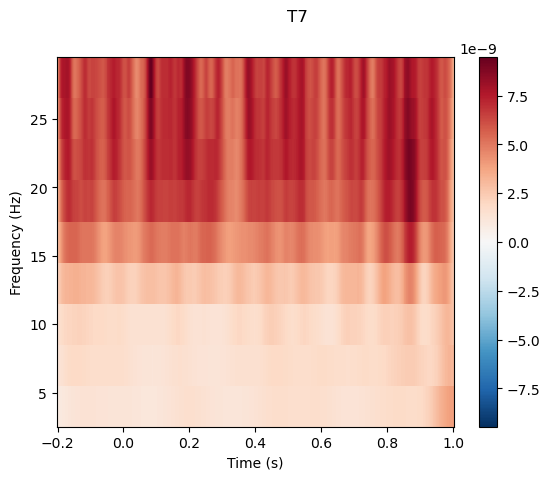

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


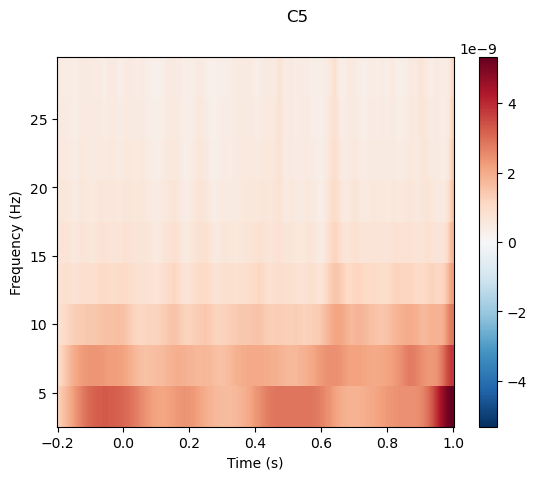

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


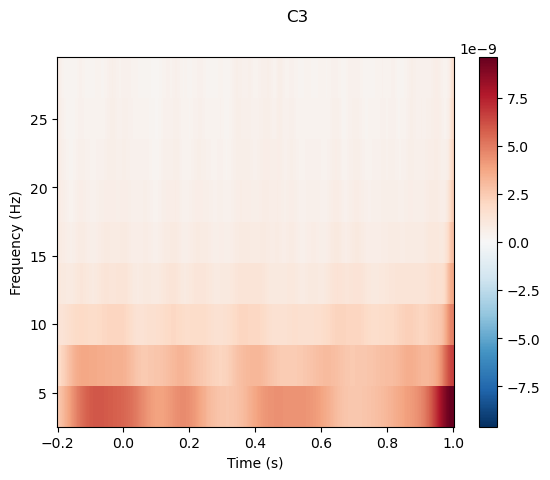

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


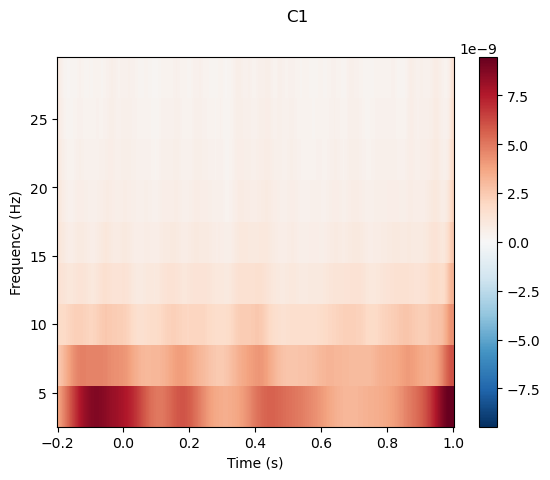

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


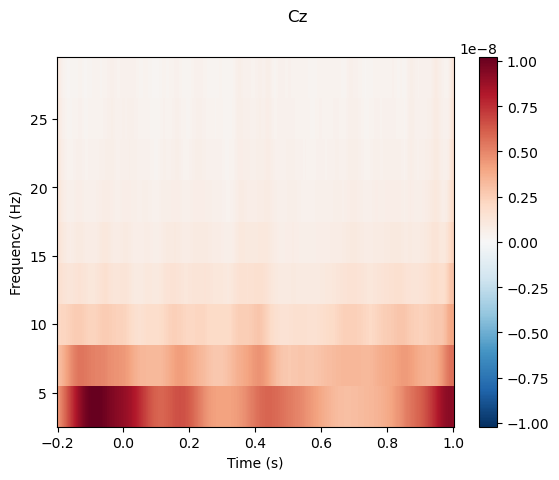

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


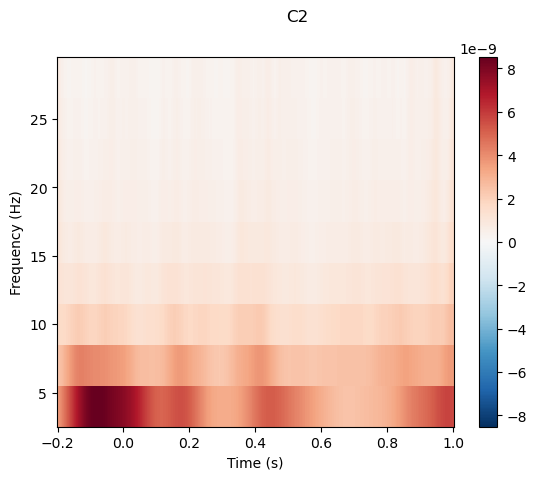

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


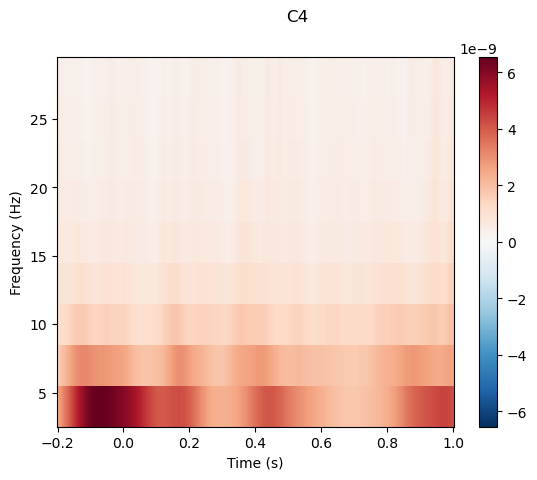

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


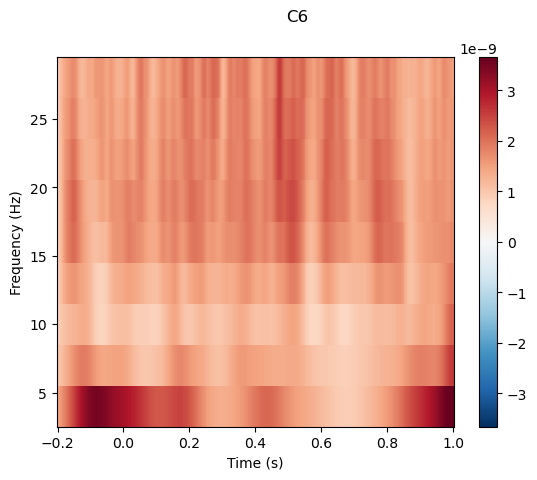

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


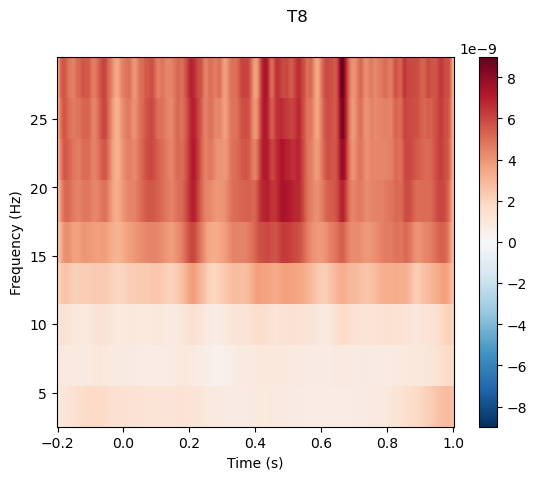

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


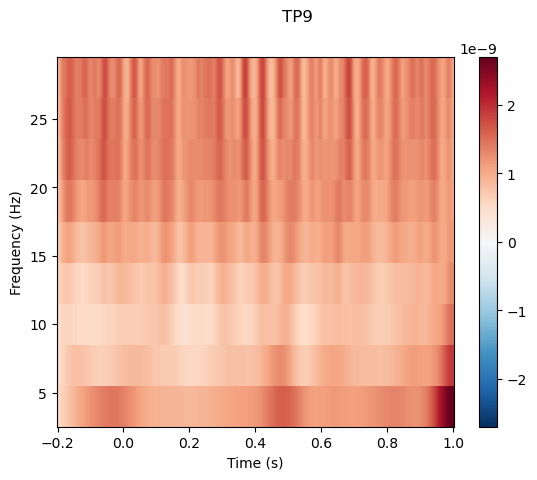

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


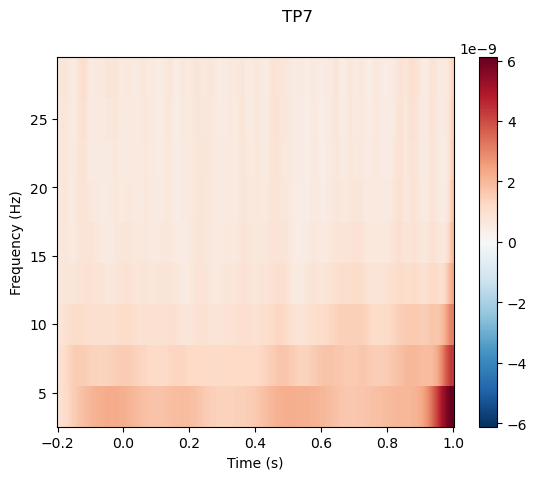

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


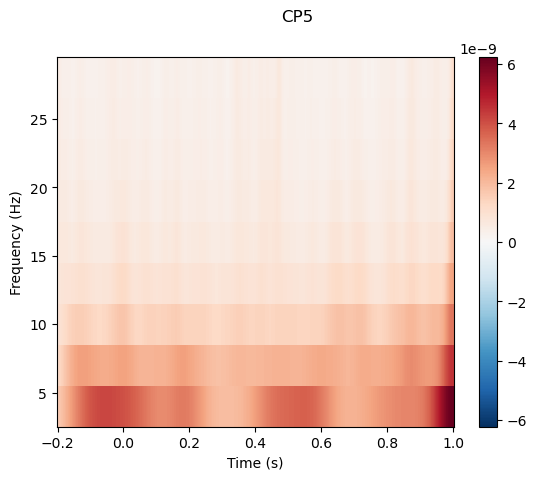

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


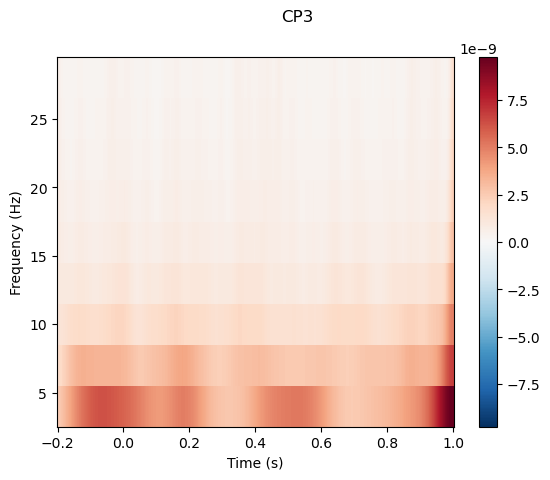

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


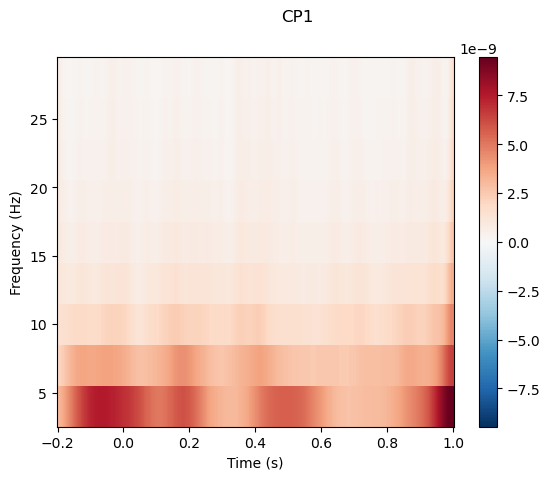

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


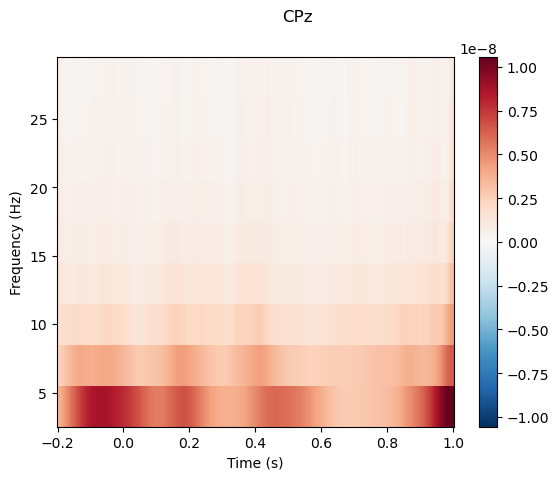

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


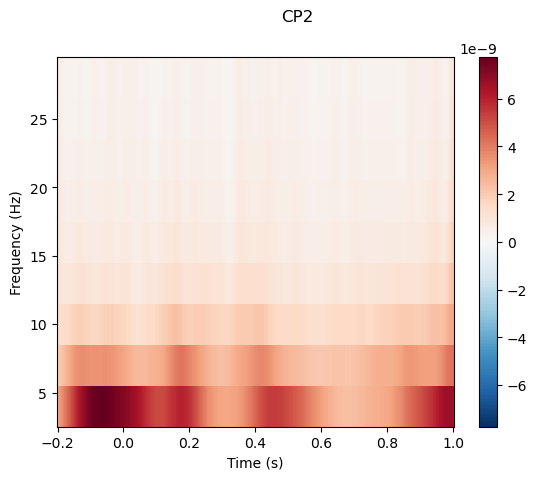

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


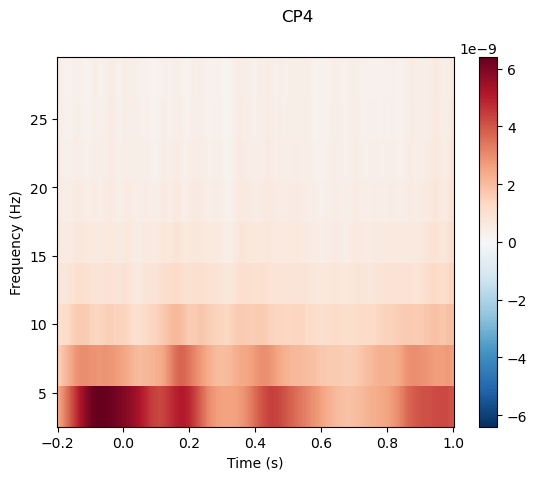

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


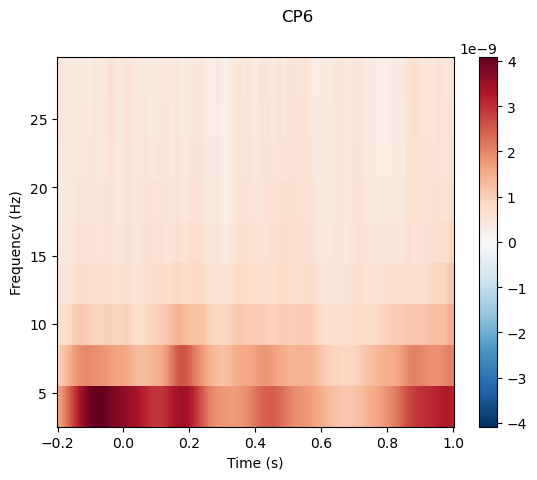

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


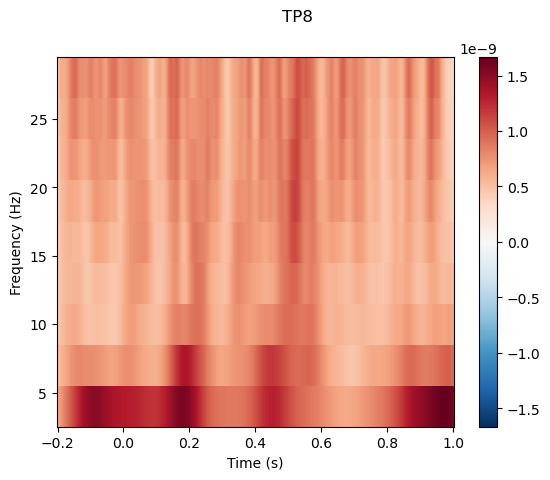

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


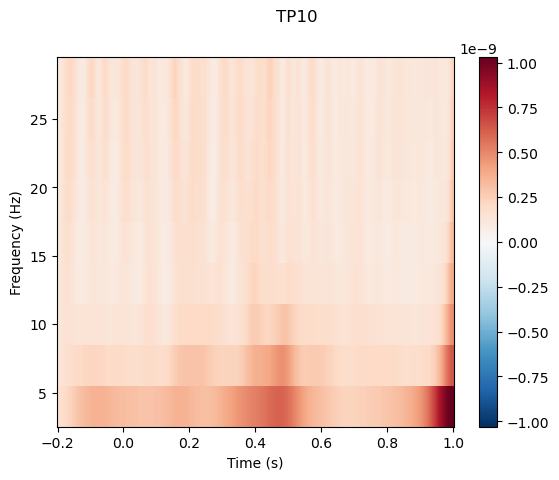

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


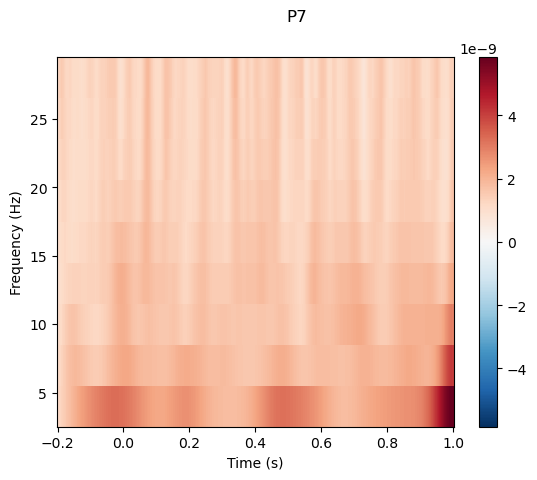

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


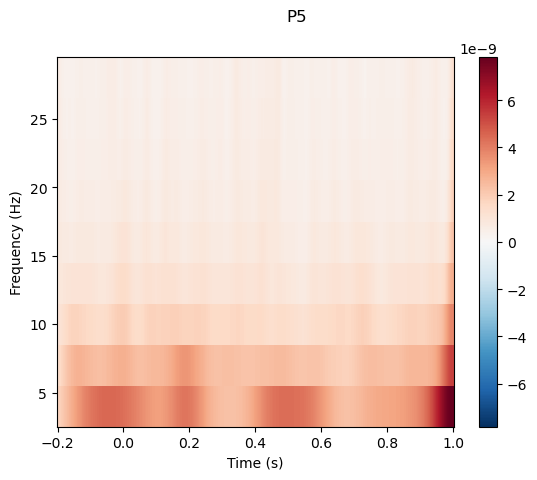

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


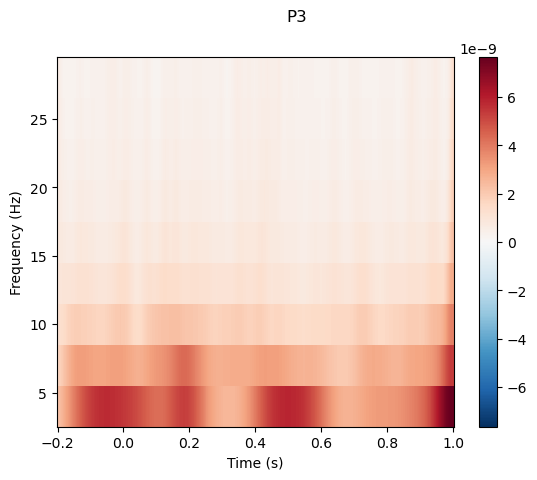

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


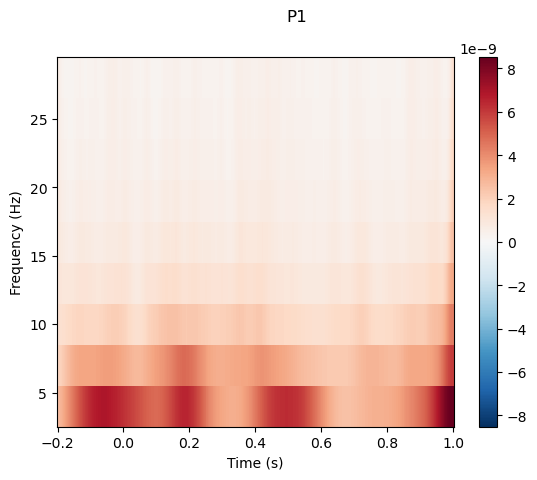

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


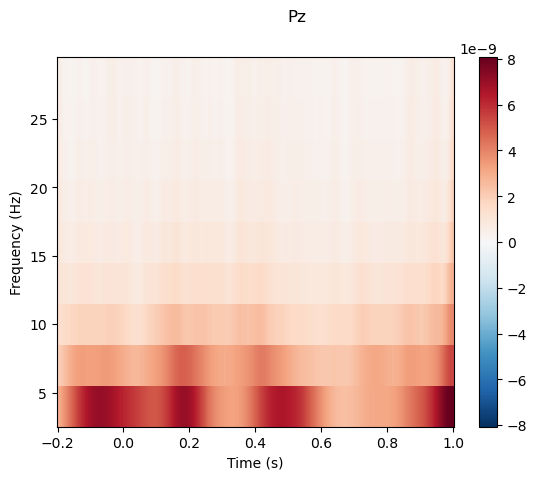

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


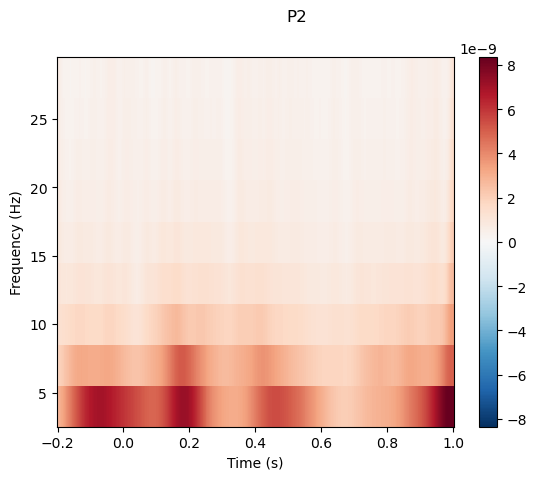

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


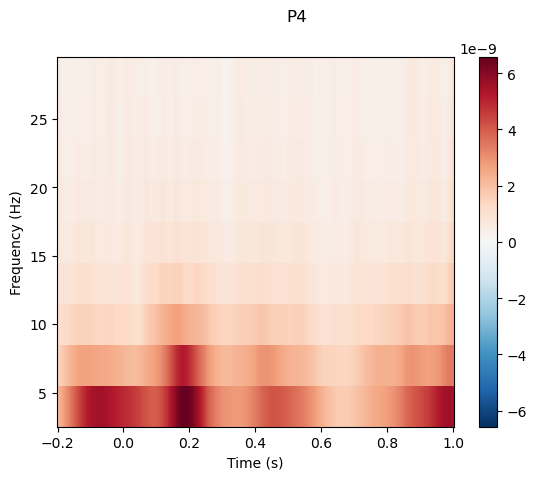

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


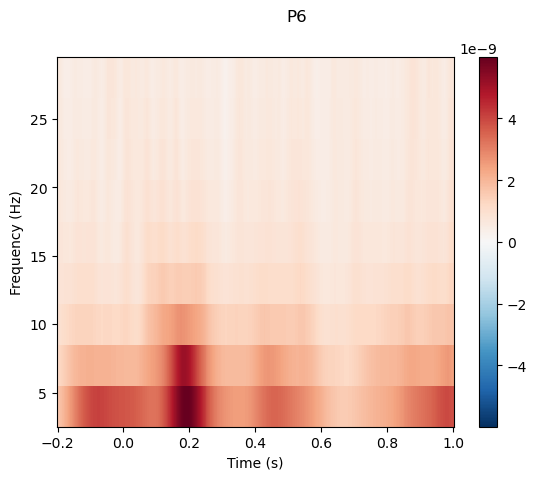

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


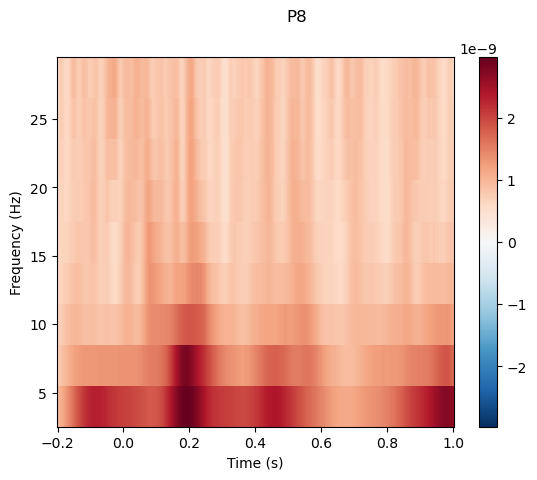

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


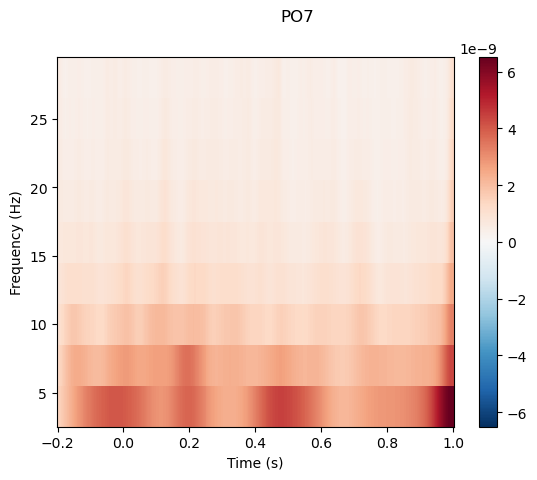

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


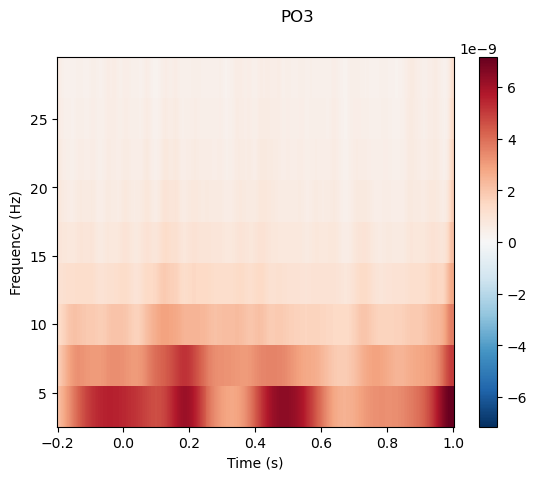

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


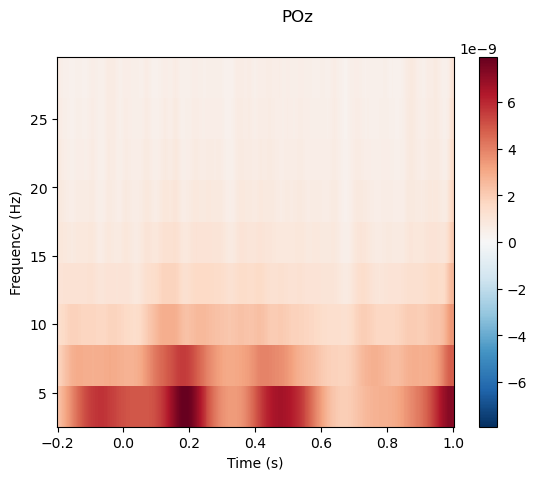

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


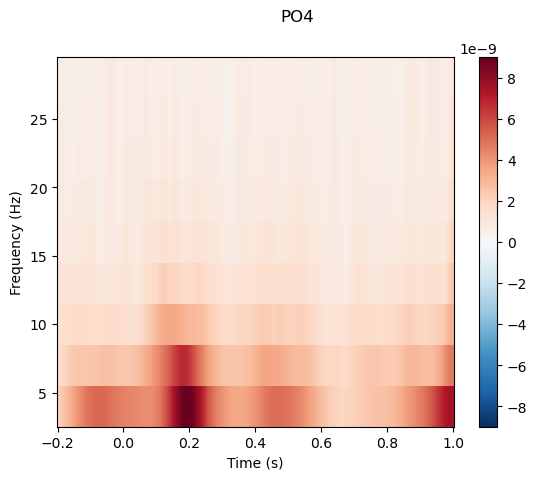

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


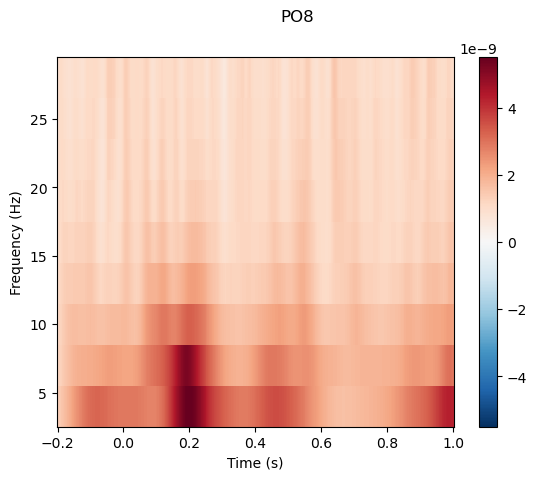

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


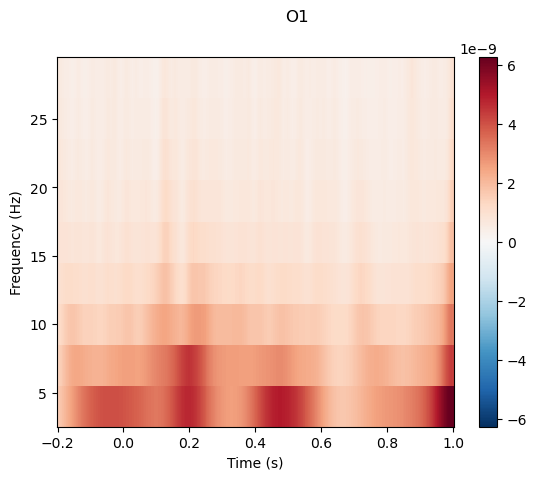

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


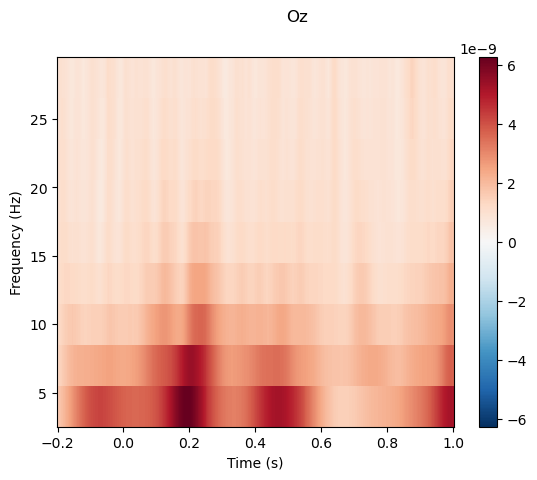

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
No baseline correction applied


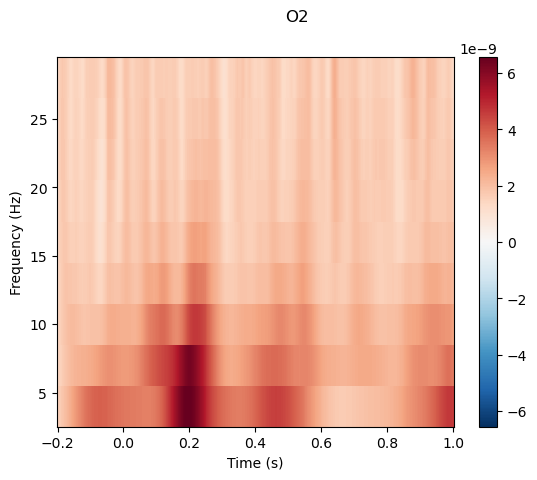

In [29]:
frequencies = np.arange(4, 30, 3)
power = mne.time_frequency.tfr_morlet(epochs, n_cycles=2, return_itc=False, freqs=frequencies, decim=3)
for i in range(len(channel)):
    ch = channel[i]
    power.plot(picks=ch, title=ch)

In [31]:
eeg_temp = reconst_raw.copy().pick_types(eeg=True, eog=False, ecg=False)
channel = eeg_temp.ch_names

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


In [32]:
iter_freqs = [("Theta", 4, 7), ("Alpha", 8, 12), ("Beta", 13, 25)]

In [33]:
frequency_map = list()

for band, fmin, fmax in iter_freqs:
    # (re)load the data to save memory
    eeg_temp.load_data()

    # epoch
    epochs = mne.Epochs(
        eeg_temp,
        events,
        tmin = -0.2,
        tmax = 1,
        baseline=None,
        preload=True,
    )
    # remove evoked response
    epochs.subtract_evoked()

    # get analytic signal (envelope)
    eeg_temp.apply_hilbert(envelope=True)
    frequency_map.append(((band, fmin, fmax), epochs.average()))
    del epochs
del raw

Not setting metadata
47 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 47 events and 1201 original time points ...
5 bad epochs dropped
Subtracting Evoked from Epochs
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
[done]
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Not setting metadata
47 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 47 events and 1201 original time points ...
5 bad epochs dropped
Subtracting Evoked from Epochs
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
[done]
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Not setting metadata
47 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 47 events and 1201 original time points ...
5 bad epoc

In [34]:
from mne.baseline import rescale
from mne.datasets import somato
from mne.stats import bootstrap_confidence_interval

In [35]:
def stat_fun(x):
    """Return sum of squares."""
    return np.sum(x**2, axis=0)

Applying baseline correction (mode: mean)


Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


Text(0.5, 0, 'Time [ms]')

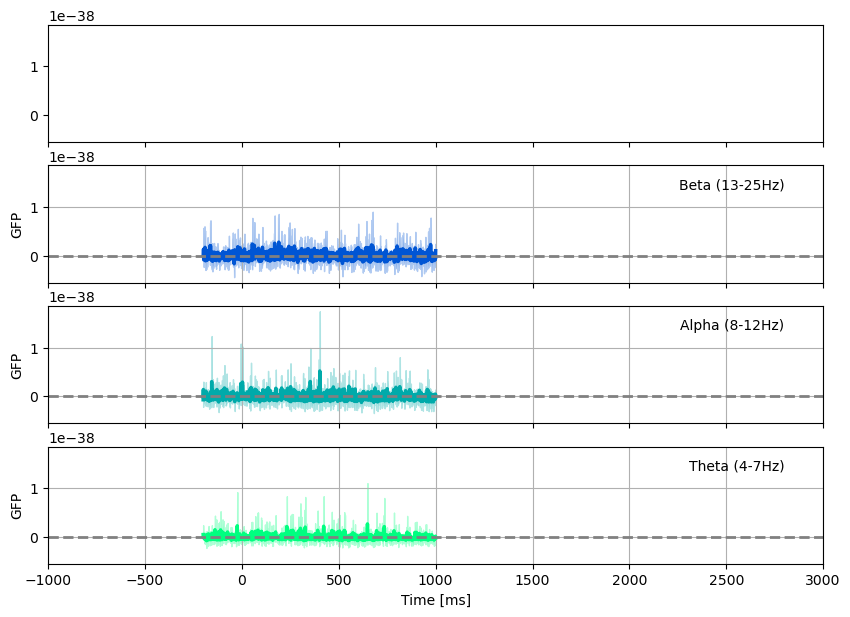

Channels marked as bad:
none
Channels marked as bad:
none
Channels marked as bad:
none
Channels marked as bad:
none


In [ ]:
fig, axes = plt.subplots(4, 1, figsize=(10, 7), sharex=True, sharey=True)
colors = plt.colormaps["winter_r"](np.linspace(0, 1, 4))
for ((freq_name, fmin, fmax), average), color, ax in zip(
    frequency_map, colors, axes.ravel()[::-1]
):
    times = average.times * 1e3
    gfp = np.sum(average.data**2, axis=0)
    gfp = mne.baseline.rescale(gfp, times, baseline=(None, 0))
    ax.plot(times, gfp, label=freq_name, color=color, linewidth=2.5)
    ax.axhline(0, linestyle="--", color="grey", linewidth=2)
    ci_low, ci_up = bootstrap_confidence_interval(
        average.data, random_state=0, stat_fun=stat_fun
    )
    ci_low = rescale(ci_low, average.times, baseline=(None, 0))
    ci_up = rescale(ci_up, average.times, baseline=(None, 0))
    ax.fill_between(times, gfp + ci_up, gfp - ci_low, color=color, alpha=0.3)
    ax.grid(True)
    ax.set_ylabel("GFP")
    ax.annotate(
        "%s (%d-%dHz)" % (freq_name, fmin, fmax),
        xy=(0.95, 0.8),
        horizontalalignment="right",
        xycoords="axes fraction",
    )
    ax.set_xlim(-1000, 3000)

axes.ravel()[-1].set_xlabel("Time [ms]")